In [ ]:
!pip install torch-geometric
!pip install tensorboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.4 MB/s eta 0:00:00


In [ ]:
import networkx as nx
import  torch_geometric
import torch
import json
from torch_geometric.datasets import Planetoid
from torch_geometric.nn import GCNConv
import torch.nn.functional as F
from torch_geometric.utils import to_networkx
from torch_geometric.transforms import NormalizeFeatures, AddSelfLoops
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from torch.utils.tensorboard import SummaryWriter
from sklearn.metrics import precision_score, recall_score, f1_score
import pandas as pd
from google.colab import files
from google.colab import drive
from sklearn.decomposition import PCA

# **Loading the Dataset with 'normalization'**
- **note: for preprocessing we use 'NormalizeFeatures' and we try to add self loops to the graph but it is raising an error !!**

In [ ]:
data = Planetoid(root='data/', name='Cora', transform=NormalizeFeatures())

# **Data Information**

In [ ]:
data

Cora()

In [ ]:
num_classes = data.num_classes
num_classes

7

In [ ]:
len(data)

1

In [ ]:
num_features = data.num_features
num_features

1433

In [ ]:
data.num_edge_features

0

In [ ]:
data.data

/usr/local/lib/python3.10/dist-packages/torch_geometric/data/in_memory_dataset.py:300: UserWarning: It is not recommended to directly access the internal storage format `data` of an 'InMemoryDataset'. If you are absolutely certain what you are doing, access the internal storage via `InMemoryDataset._data` instead to suppress this warning. Alternatively, you can access stacked individual attributes of every graph via `dataset.{attr_name}`.
  warnings.warn(msg)


Data(x=[2708, 1433], edge_index=[2, 10556], y=[2708], train_mask=[2708], val_mask=[2708], test_mask=[2708])

In [ ]:
edge_index = data.edge_index
edge_index

tensor([[ 633, 1862, 2582,  ...,  598, 1473, 2706],
        [   0,    0,    0,  ..., 2707, 2707, 2707]])

In [ ]:
def visualize_E(h, color):
    h = h.detach().cpu().numpy() # Array of node embeddings
    plt.scatter(h[:, 0], h[:, 1], c=color)

# Convert to Networkx Graph

In [ ]:
F = to_networkx(data[0])

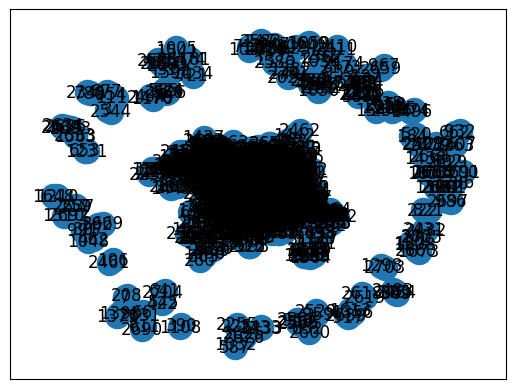

In [ ]:
nx.draw_networkx(F)

# Spring Layout for positioning the nodes of graph in 2D space
- **for example tell me where node 0 is in the x and y axis**

In [ ]:
nx.spring_layout(F)

# Visualize the Graph

In [ ]:
def visualize_G(G, color):
    return nx.draw_networkx(G, nx.spring_layout(G), node_color=color)

# Visualize the Embeddings

In [ ]:
def visualize_E(h, color):
    h = h.detach().cpu().numpy() # Array of node embeddings
    plt.scatter(h[:, 0], h[:, 1], c=color)
    plt.show()

In [ ]:
G = to_networkx(data[0]) # get first graph object and convert it to 'networkx graph'

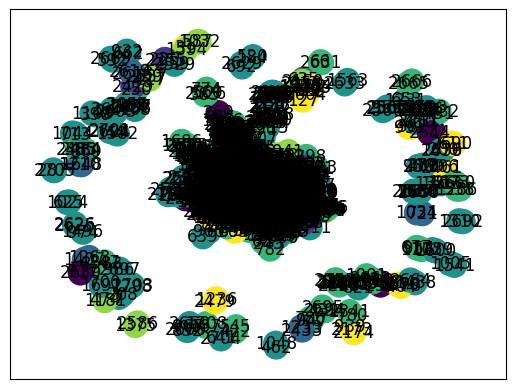

In [ ]:
visualize_G(G, data[0].y) # data[0].y 'predections' (class label of each node)

In [ ]:
CoraDataset = data[0] # get first graph object



---



# 1. **GCN Architecture | Mohamed Khairi and Mostapha Abdelaziz**

In [ ]:
class GCN(torch.nn.Module):
    def __init__(self, hidden_dimension, num_layers=2, activation_func="ReLU"):
        super(GCN, self).__init__()

        self.num_layers = num_layers
        self.activation_func = activation_func

        self.conv1 = GCNConv(num_features, hidden_dimension)
        self.convs = torch.nn.ModuleList([GCNConv(hidden_dimension, hidden_dimension) for _ in range(num_layers - 1)])
        self.conv_last = GCNConv(hidden_dimension, num_classes)

    def forward(self, x, edge_index):

        x = self.conv1(x, edge_index)
        x = self.applyActivation(x)

        for conv in self.convs:
            x = conv(x, edge_index)
            x = self.applyActivation(x)

        x = self.conv_last(x, edge_index)
        return x

    def applyActivation(self, x):
        if self.activation_func == "ReLU":
            return torch.relu(x)
        elif self.activation_func == "Sigmoid":
            return torch.sigmoid(x)
        elif self.activation_func == "Tanh":
            return torch.tanh(x)
        else:
            raise ValueError("Unsupported activation function !!")

# Train and test

In [ ]:
def train(data, mask, model, optimizer, criterion):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out[mask], data.y[mask])
    loss.backward()
    optimizer.step()
    return loss

def test(data, mask, model):
    model.eval()
    out = model(data.x, data.edge_index)
    predictedC = out.argmax(dim=1)
    correct = predictedC[mask] == data.y[mask]
    acc = int(correct.sum()) / int(mask.sum())
    return acc

# Models building

In [ ]:
# 'First' Base model - Mohamed Khairi and Mostapha Abdelaziz

model1 = GCN(hidden_dimension=8, num_layers=2, activation_func="ReLU")
optimizer1 = torch.optim.Adam(model1.parameters(), lr=0.01)
criterion1 = torch.nn.CrossEntropyLoss()

# 'Second' model after tuning - Mohamed Khairi
model2 = GCN(hidden_dimension=16, num_layers=3, activation_func="Tanh")
optimizer2 = torch.optim.Adam(model2.parameters(), lr=0.005, weight_decay=0)
criterion2 = torch.nn.CrossEntropyLoss()

# 'Third' model after tuning - Mostapha Abdelaziz
model3 = GCN(hidden_dimension=32, num_layers=2, activation_func="Sigmoid")
optimizer3 = torch.optim.Adam(model3.parameters(), lr=0.01, weight_decay=5e-4)
criterion3 = torch.nn.CrossEntropyLoss()

# Base Model (model1) embeddings | GCN

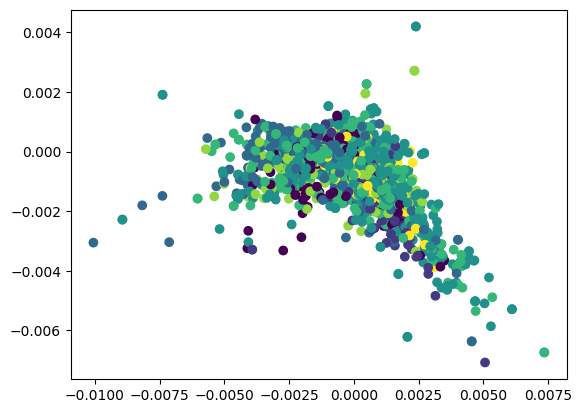

In [ ]:
embeddings = model1(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 2 embeddings | Mohamed Khairi

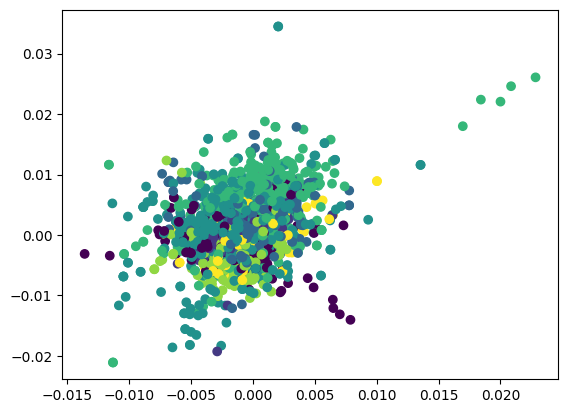

In [ ]:
embeddings = model2(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 3 embeddings | Mostapha Abdelaziz

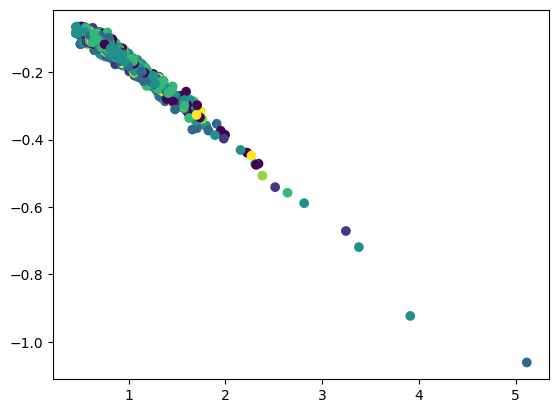

In [ ]:
embeddings = model3(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Train and test 'Base model'

Model 1 - Epoch: 010, Loss: 1.2747, Train: 0.5929, Val: 0.4600, Test: 0.4640, Precision: 0.6989, Recall: 0.4640, F1: 0.3807
Node Embeddings (Epoch 10):
[[-1.9845693  -0.6401106 ]
 [-3.2427359   0.25856087]
 [-3.211758   -0.30004555]
 ...
 [ 0.6913297   0.6776079 ]
 [-2.083079   -0.39356166]
 [-1.8814943  -0.38933575]]


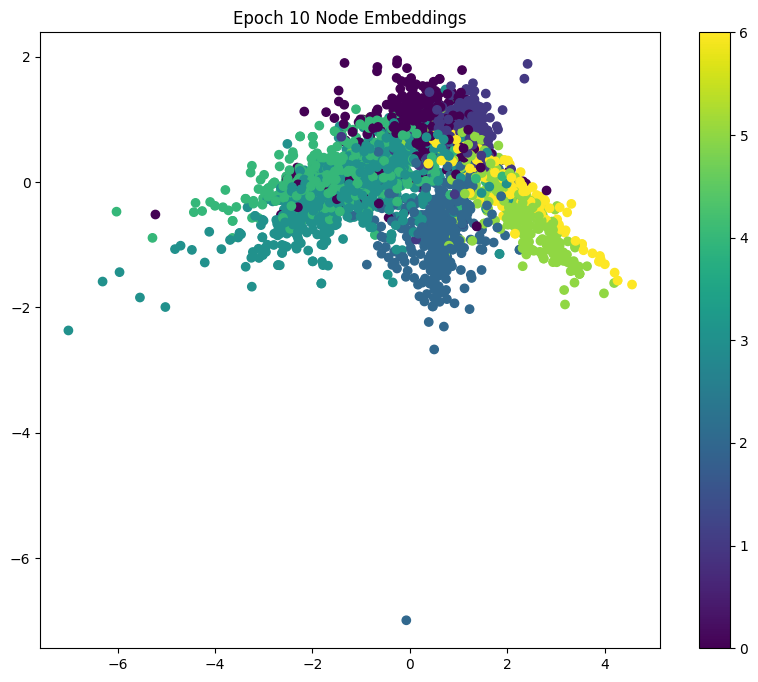

Model 1 - Epoch: 020, Loss: 0.5749, Train: 0.9429, Val: 0.6980, Test: 0.6960, Precision: 0.7343, Recall: 0.6960, F1: 0.6996
Node Embeddings (Epoch 20):
[[-4.9151297  -2.247761  ]
 [-7.585643    1.6485772 ]
 [-7.510663   -0.08113849]
 ...
 [ 1.4243577   1.8164186 ]
 [-4.840374   -1.5221353 ]
 [-4.334527   -1.5100307 ]]


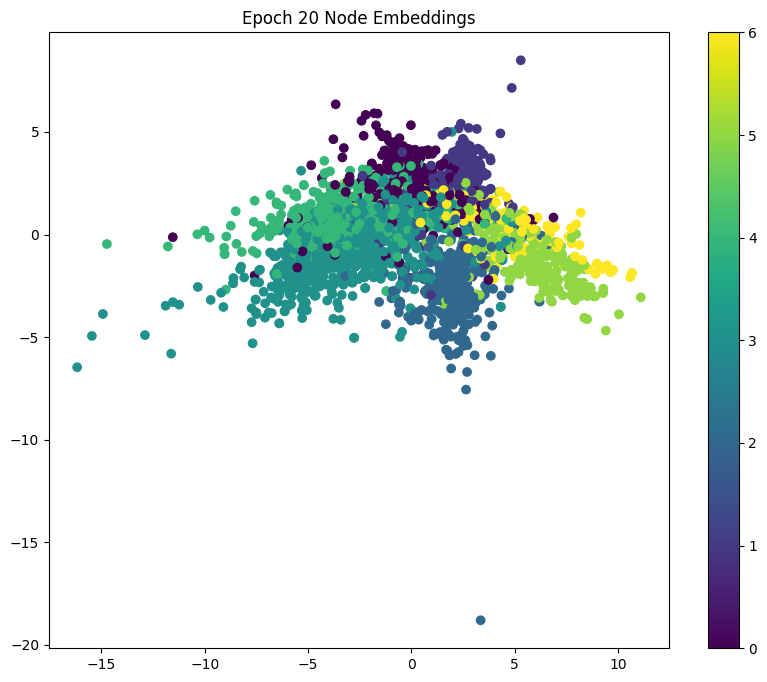

Model 1 - Epoch: 030, Loss: 0.1912, Train: 0.9857, Val: 0.7260, Test: 0.7340, Precision: 0.7593, Recall: 0.7340, F1: 0.7382
Node Embeddings (Epoch 30):
[[ -7.358278   -4.7331276]
 [-12.058039    4.725524 ]
 [-11.806641    1.3901601]
 ...
 [  2.699359    2.7906594]
 [ -7.504477   -3.242979 ]
 [ -6.568381   -3.194531 ]]


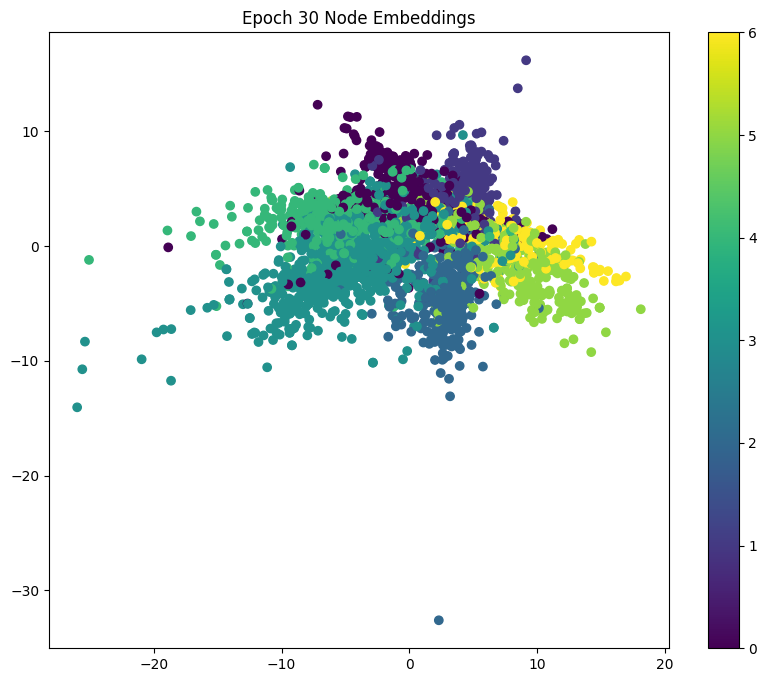

Model 1 - Epoch: 040, Loss: 0.0574, Train: 1.0000, Val: 0.7280, Test: 0.7460, Precision: 0.7646, Recall: 0.7460, F1: 0.7489
Node Embeddings (Epoch 40):
[[-10.602104   -6.382692 ]
 [-15.024218    9.744789 ]
 [-14.926472    5.184273 ]
 ...
 [  4.8150263   3.0897508]
 [-10.573145   -4.136895 ]
 [ -9.305746   -4.2083206]]


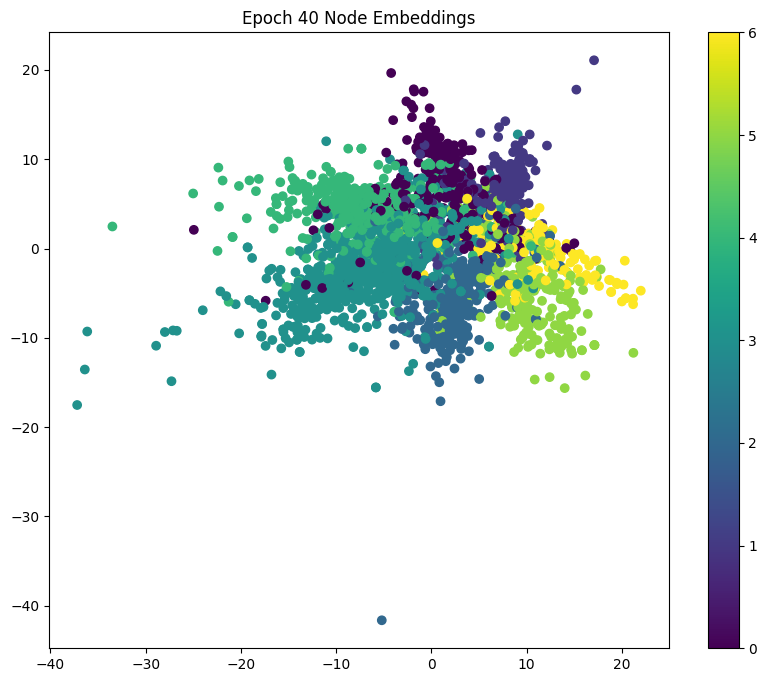

Model 1 - Epoch: 050, Loss: 0.0195, Train: 1.0000, Val: 0.7380, Test: 0.7490, Precision: 0.7659, Recall: 0.7490, F1: 0.7510
Node Embeddings (Epoch 50):
[[13.156095  -7.0631022]
 [16.262863  14.292822 ]
 [16.112602   8.980635 ]
 ...
 [-6.424558   3.074019 ]
 [13.060319  -4.4697013]
 [11.619524  -4.711381 ]]


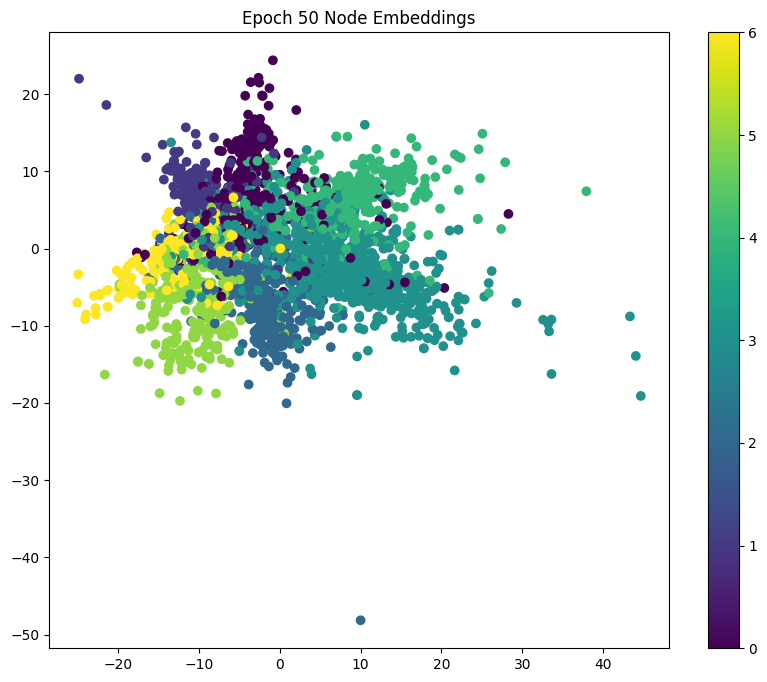

Model 1 - Epoch: 060, Loss: 0.0093, Train: 1.0000, Val: 0.7400, Test: 0.7510, Precision: 0.7662, Recall: 0.7510, F1: 0.7529
Node Embeddings (Epoch 60):
[[14.776807  -7.2676835]
 [16.667381  17.245771 ]
 [16.485409  11.387327 ]
 ...
 [-7.292283   2.8887308]
 [14.847459  -4.568354 ]
 [13.30593   -4.971136 ]]


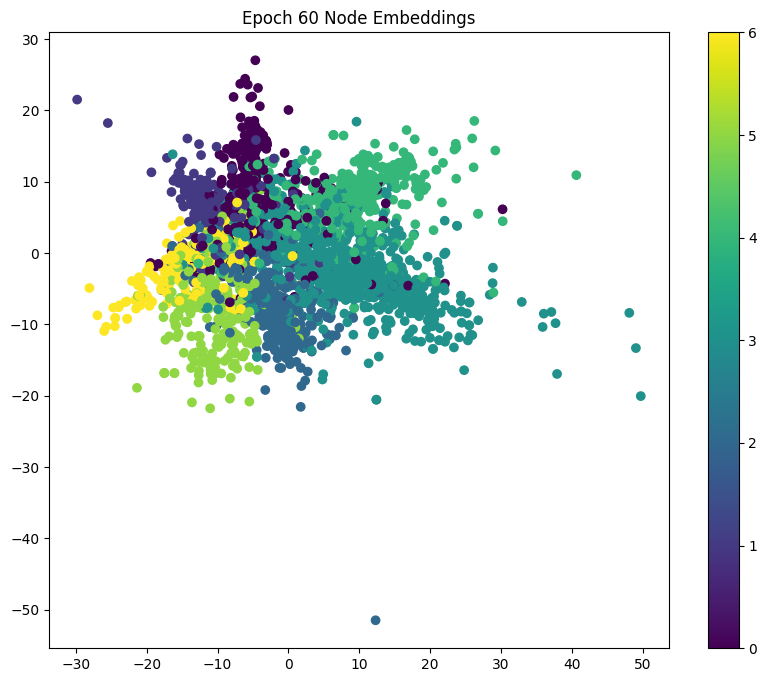

Model 1 - Epoch: 070, Loss: 0.0056, Train: 1.0000, Val: 0.7420, Test: 0.7460, Precision: 0.7620, Recall: 0.7460, F1: 0.7479
Node Embeddings (Epoch 70):
[[15.576463  -7.586631 ]
 [17.21735   18.726786 ]
 [16.932407  12.517894 ]
 ...
 [-7.6243544  2.8853273]
 [15.915975  -4.7794685]
 [14.311875  -5.2913866]]


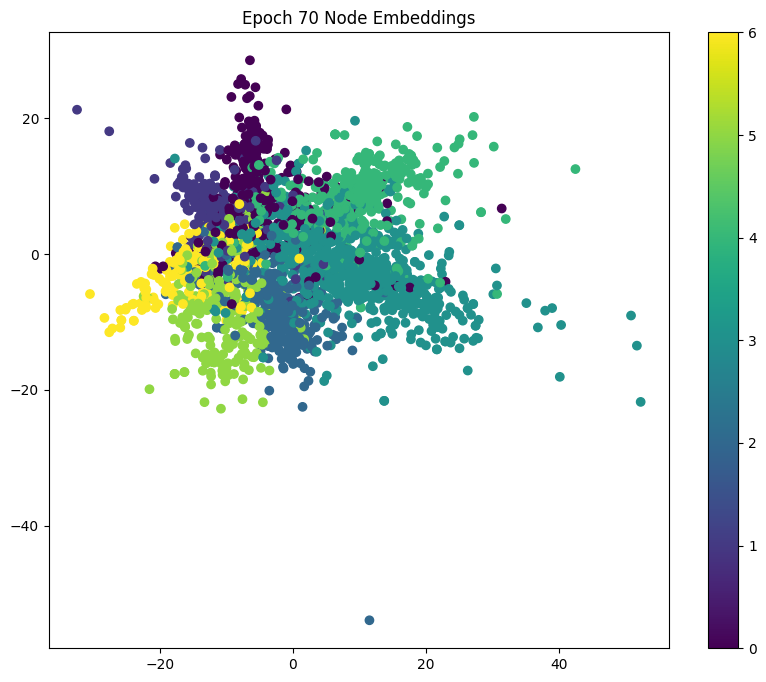

Model 1 - Epoch: 080, Loss: 0.0041, Train: 1.0000, Val: 0.7380, Test: 0.7460, Precision: 0.7629, Recall: 0.7460, F1: 0.7480
Node Embeddings (Epoch 80):
[[16.039606  -7.8038197]
 [17.71034   19.572405 ]
 [17.348248  13.11774  ]
 ...
 [-7.8089     2.9659338]
 [16.605497  -4.90327  ]
 [14.96213   -5.487974 ]]


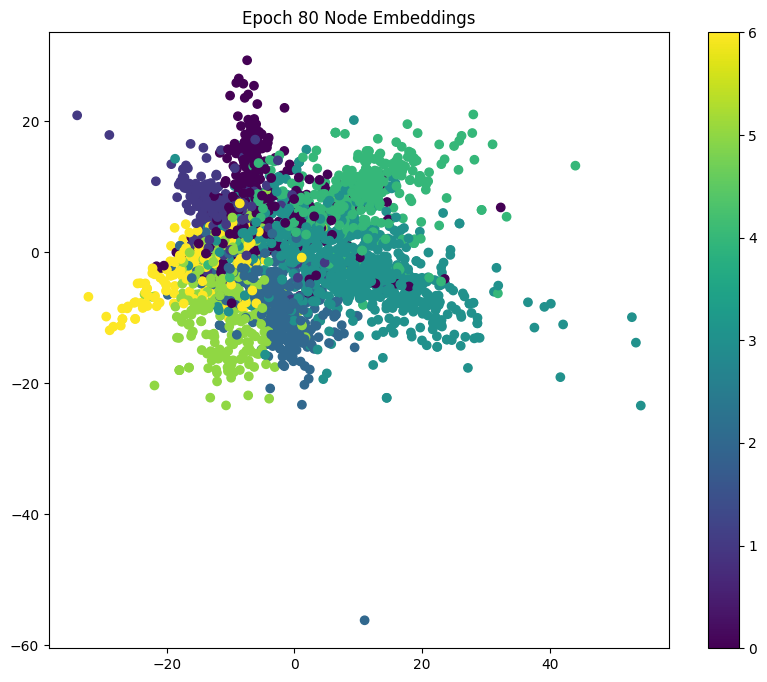

Model 1 - Epoch: 090, Loss: 0.0032, Train: 1.0000, Val: 0.7340, Test: 0.7460, Precision: 0.7631, Recall: 0.7460, F1: 0.7477
Node Embeddings (Epoch 90):
[[16.372715  -7.915522 ]
 [18.031185  20.140335 ]
 [17.645779  13.520997 ]
 ...
 [-7.9275603  3.0068288]
 [17.104317  -4.94192  ]
 [15.4396715 -5.582852 ]]


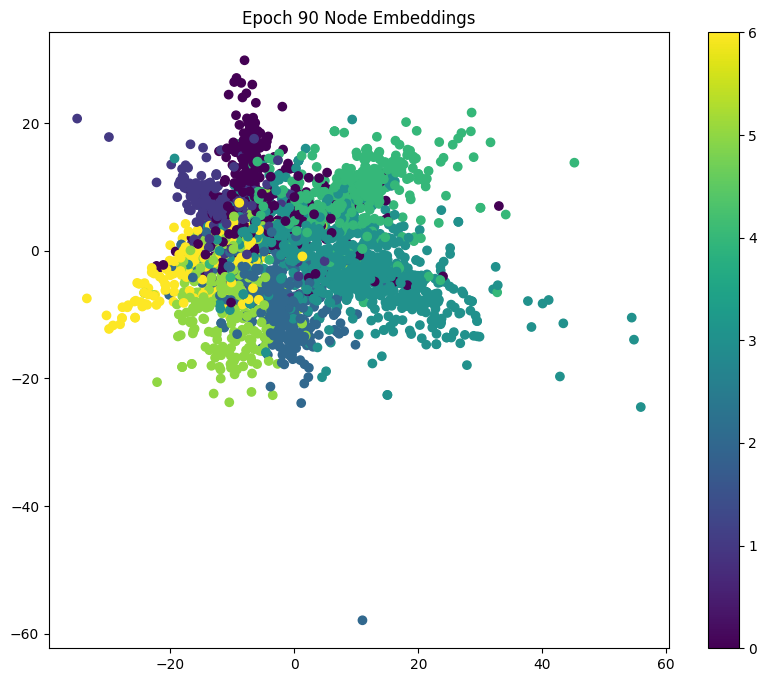

Model 1 - Epoch: 100, Loss: 0.0027, Train: 1.0000, Val: 0.7320, Test: 0.7470, Precision: 0.7639, Recall: 0.7470, F1: 0.7487
Node Embeddings (Epoch 100):
[[16.63022   -7.9933147]
 [18.282137  20.56726  ]
 [17.896486  13.820623 ]
 ...
 [-8.016954   3.0264077]
 [17.499912  -4.963187 ]
 [15.818518  -5.6480446]]


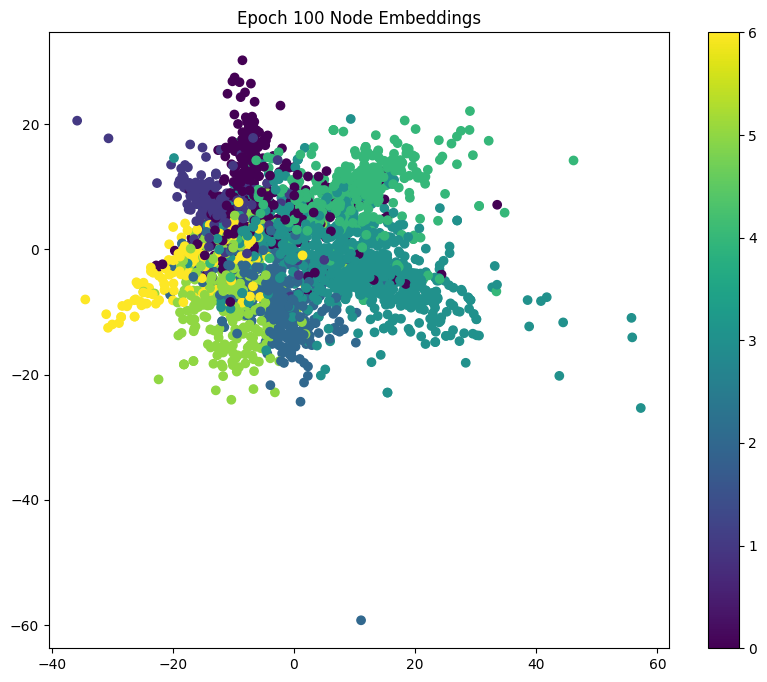

Model 1 - Epoch: 110, Loss: 0.0023, Train: 1.0000, Val: 0.7320, Test: 0.7470, Precision: 0.7634, Recall: 0.7470, F1: 0.7486
Node Embeddings (Epoch 110):
[[16.834854  -8.078209 ]
 [18.520302  20.917242 ]
 [18.134064  14.056337 ]
 ...
 [-8.083806   3.051372 ]
 [17.828382  -4.999809 ]
 [16.132551  -5.7201247]]


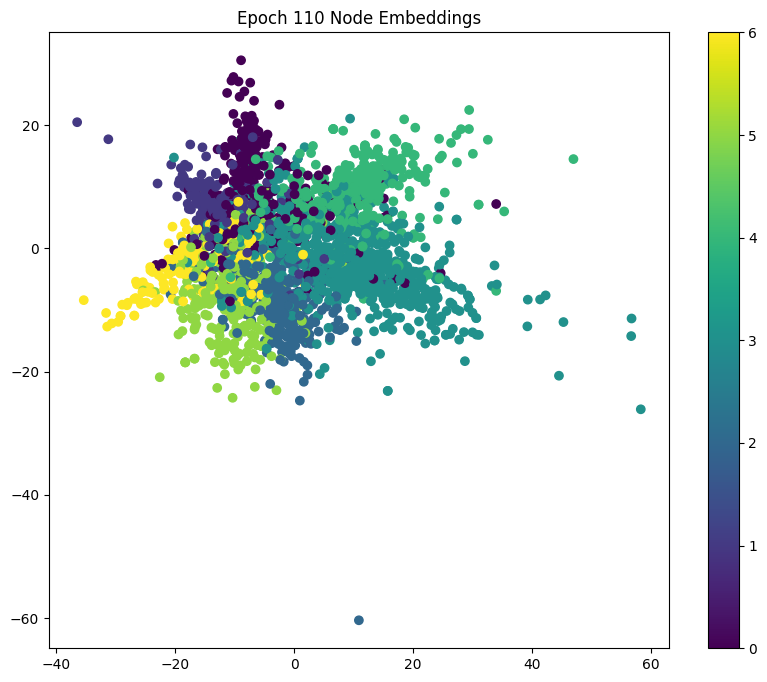

Model 1 - Epoch: 120, Loss: 0.0020, Train: 1.0000, Val: 0.7320, Test: 0.7460, Precision: 0.7625, Recall: 0.7460, F1: 0.7475
Node Embeddings (Epoch 120):
[[17.005741 -8.166438]
 [18.755995 21.220135]
 [18.364788 14.261024]
 ...
 [-8.142823  3.071041]
 [18.118113 -5.046129]
 [16.407461 -5.797064]]


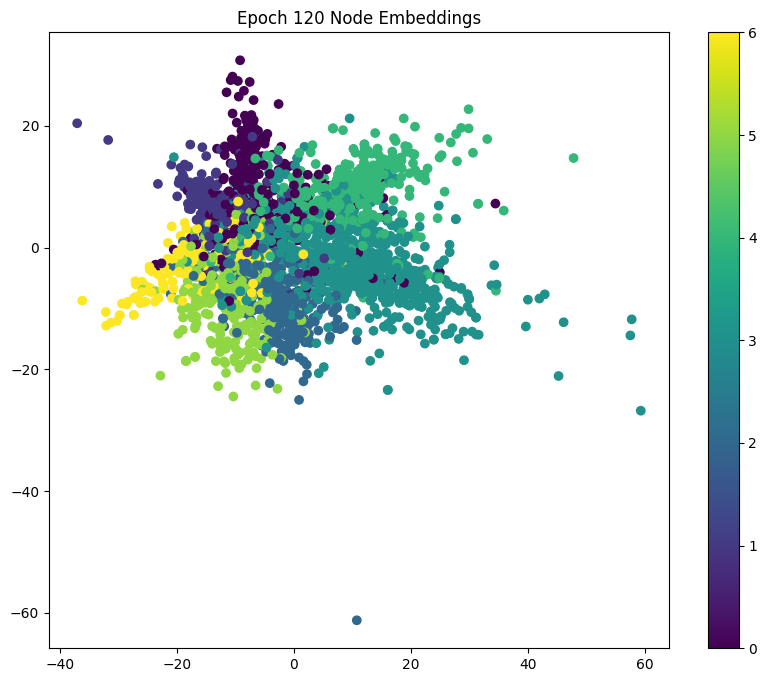

Model 1 - Epoch: 130, Loss: 0.0017, Train: 1.0000, Val: 0.7340, Test: 0.7460, Precision: 0.7625, Recall: 0.7460, F1: 0.7475
Node Embeddings (Epoch 130):
[[17.16579   -8.243595 ]
 [18.96022   21.502941 ]
 [18.569529  14.453268 ]
 ...
 [-8.199835   3.0877037]
 [18.385778  -5.086621 ]
 [16.66092   -5.865311 ]]


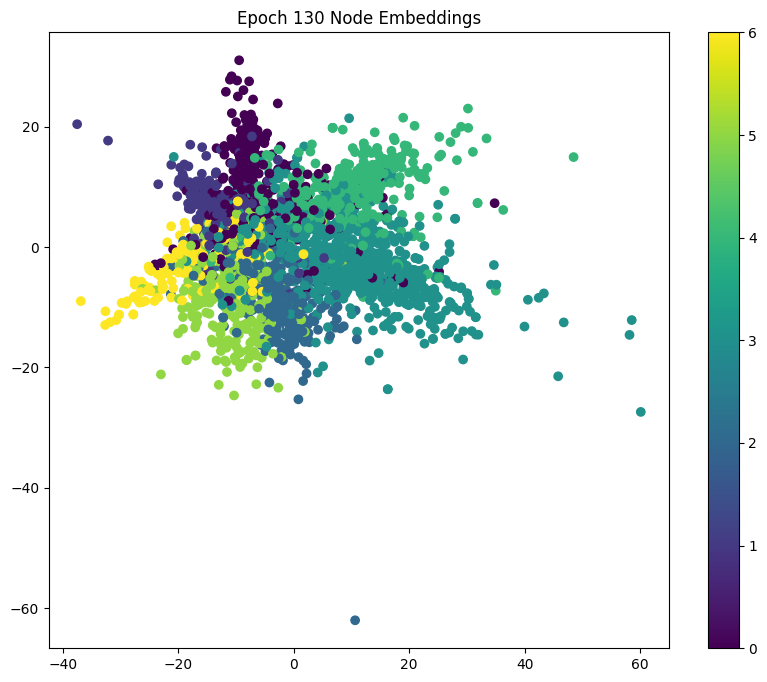

Model 1 - Epoch: 140, Loss: 0.0015, Train: 1.0000, Val: 0.7340, Test: 0.7460, Precision: 0.7625, Recall: 0.7460, F1: 0.7475
Node Embeddings (Epoch 140):
[[17.320133  -8.310316 ]
 [19.133442  21.773314 ]
 [18.750912  14.636631 ]
 ...
 [-8.257027   3.102322 ]
 [18.636787  -5.120665 ]
 [16.899014  -5.9249015]]


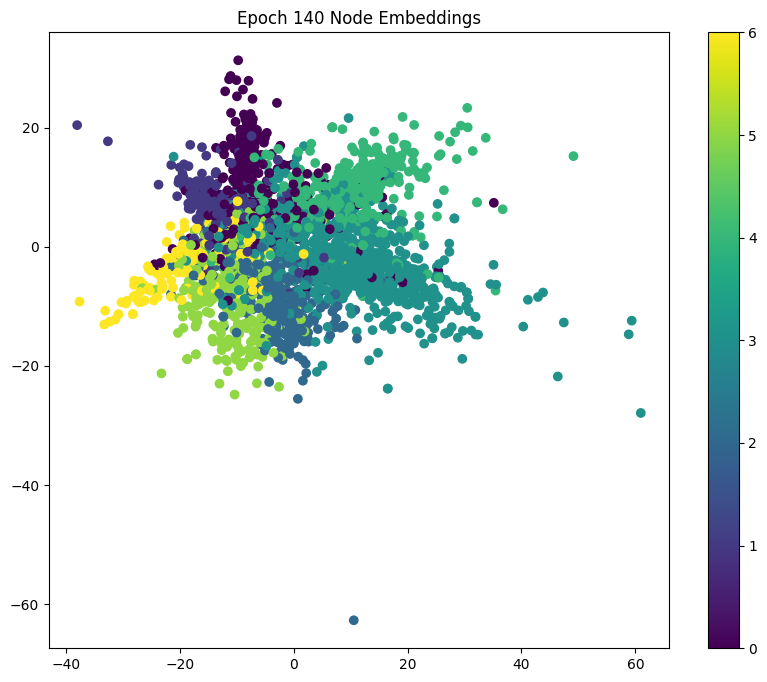

Model 1 - Epoch: 150, Loss: 0.0014, Train: 1.0000, Val: 0.7340, Test: 0.7470, Precision: 0.7637, Recall: 0.7470, F1: 0.7484
Node Embeddings (Epoch 150):
[[17.464775  -8.374439 ]
 [19.29469   22.027294 ]
 [18.919954  14.810187 ]
 ...
 [-8.31373    3.1130395]
 [18.87075   -5.153618 ]
 [17.121056  -5.982155 ]]


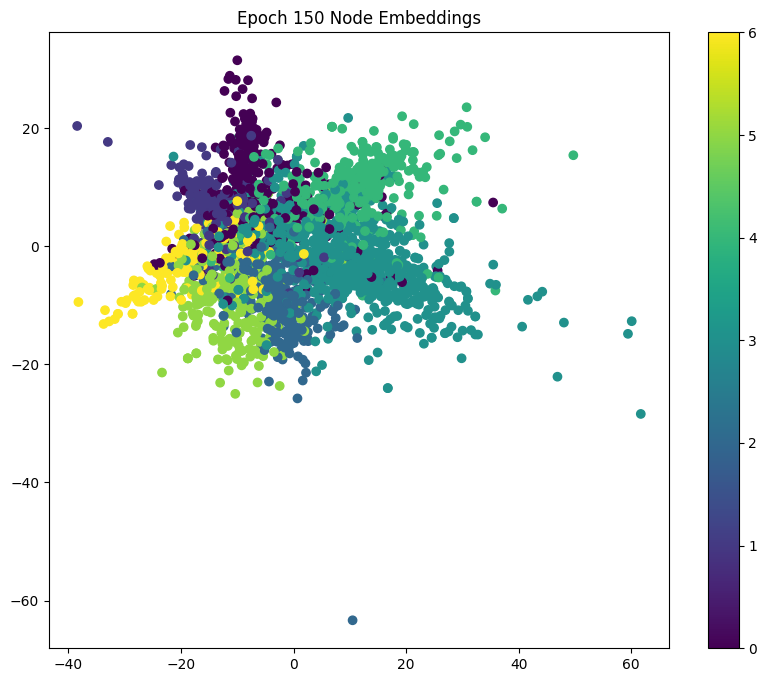

Model 1 - Epoch: 160, Loss: 0.0012, Train: 1.0000, Val: 0.7340, Test: 0.7470, Precision: 0.7637, Recall: 0.7470, F1: 0.7484
Node Embeddings (Epoch 160):
[[17.604904 -8.431903]
 [19.44428  22.271652]
 [19.079002 14.976709]
 ...
 [-8.370434  3.124864]
 [19.09288  -5.18248 ]
 [17.331814 -6.033534]]


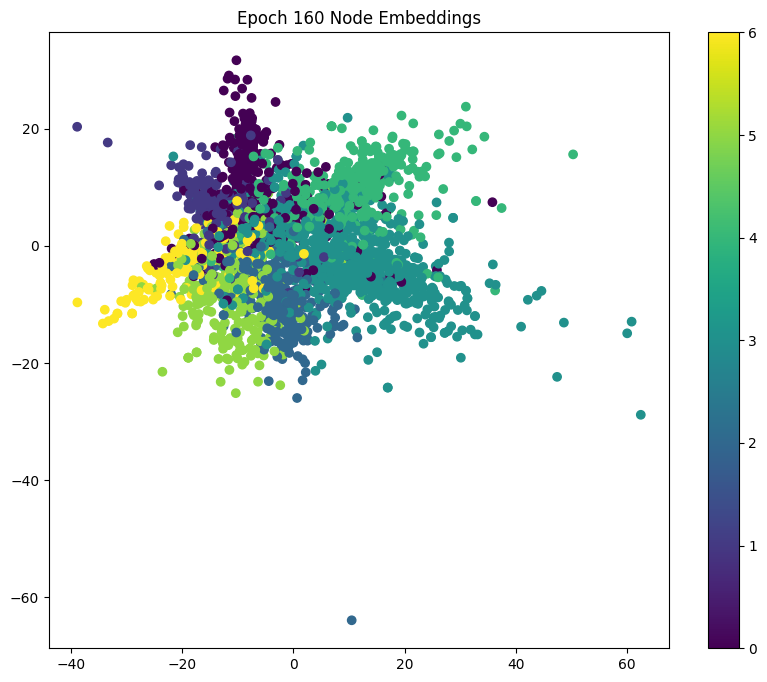

Model 1 - Epoch: 170, Loss: 0.0011, Train: 1.0000, Val: 0.7340, Test: 0.7470, Precision: 0.7638, Recall: 0.7470, F1: 0.7484
Node Embeddings (Epoch 170):
[[17.737328  -8.487636 ]
 [19.585054  22.50163  ]
 [19.229094  15.13443  ]
 ...
 [-8.424384   3.1338599]
 [19.302658  -5.210526 ]
 [17.531345  -6.0832424]]


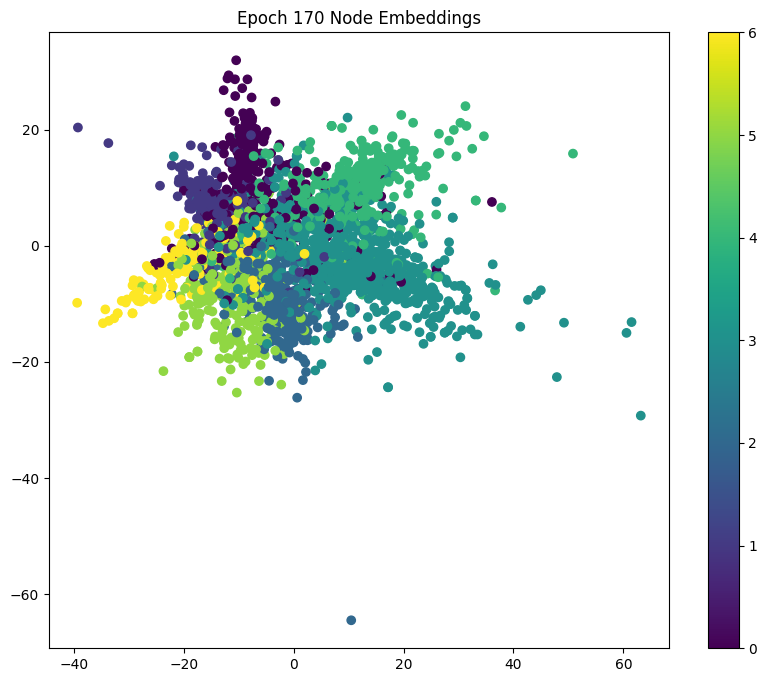

Model 1 - Epoch: 180, Loss: 0.0010, Train: 1.0000, Val: 0.7340, Test: 0.7470, Precision: 0.7638, Recall: 0.7470, F1: 0.7486
Node Embeddings (Epoch 180):
[[17.8642    -8.539681 ]
 [19.71614   22.721579 ]
 [19.370348  15.285201 ]
 ...
 [-8.477398   3.1423767]
 [19.502811  -5.2358894]
 [17.721703  -6.1292396]]


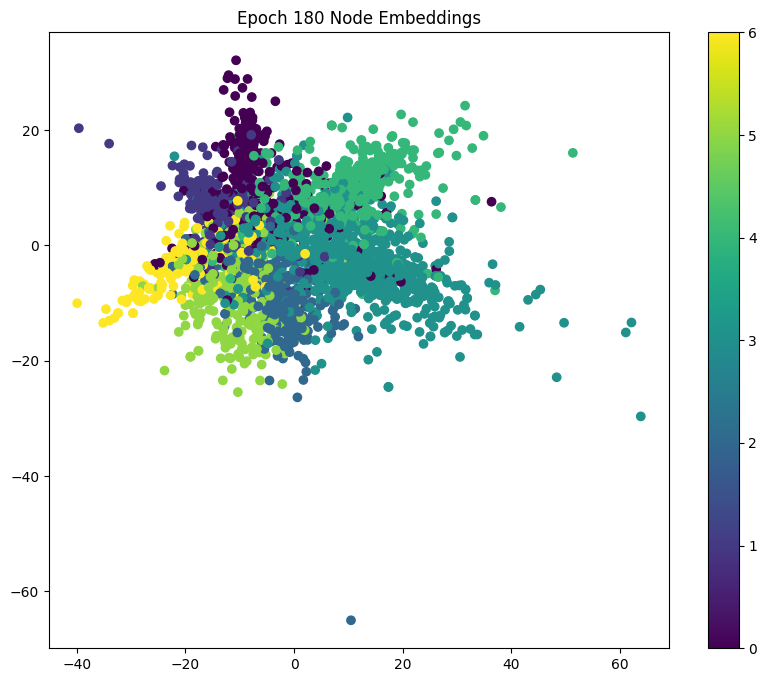

Model 1 - Epoch: 190, Loss: 0.0009, Train: 1.0000, Val: 0.7360, Test: 0.7470, Precision: 0.7637, Recall: 0.7470, F1: 0.7485
Node Embeddings (Epoch 190):
[[17.986523  -8.588909 ]
 [19.837353  22.931381 ]
 [19.50269   15.428909 ]
 ...
 [-8.527037   3.1502523]
 [19.693764  -5.2593246]
 [17.903801  -6.172365 ]]


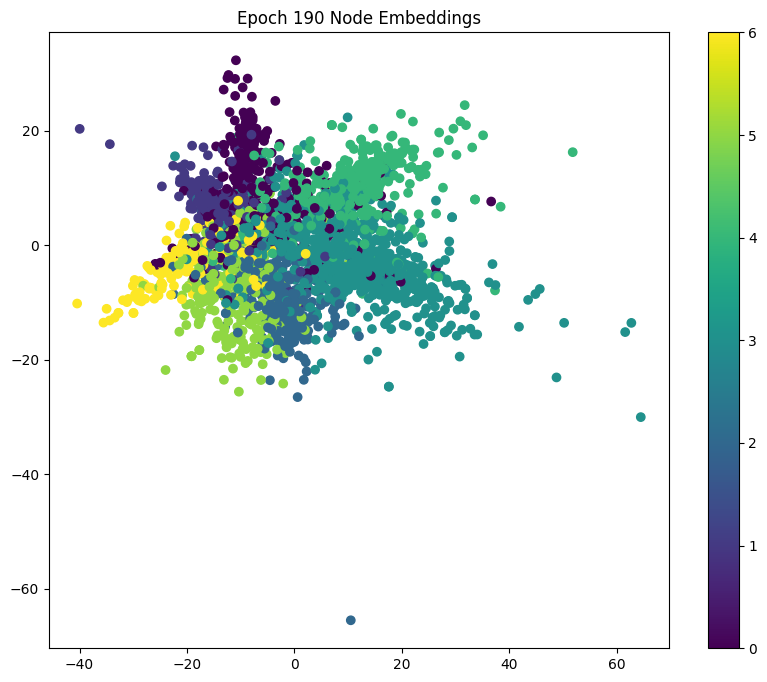

Model 1 - Epoch: 200, Loss: 0.0009, Train: 1.0000, Val: 0.7360, Test: 0.7460, Precision: 0.7628, Recall: 0.7460, F1: 0.7476
Node Embeddings (Epoch 200):
[[18.104092  -8.635527 ]
 [19.950464  23.13229  ]
 [19.627752  15.5665245]
 ...
 [-8.574251   3.15759  ]
 [19.876497  -5.281326 ]
 [18.078094  -6.2131834]]


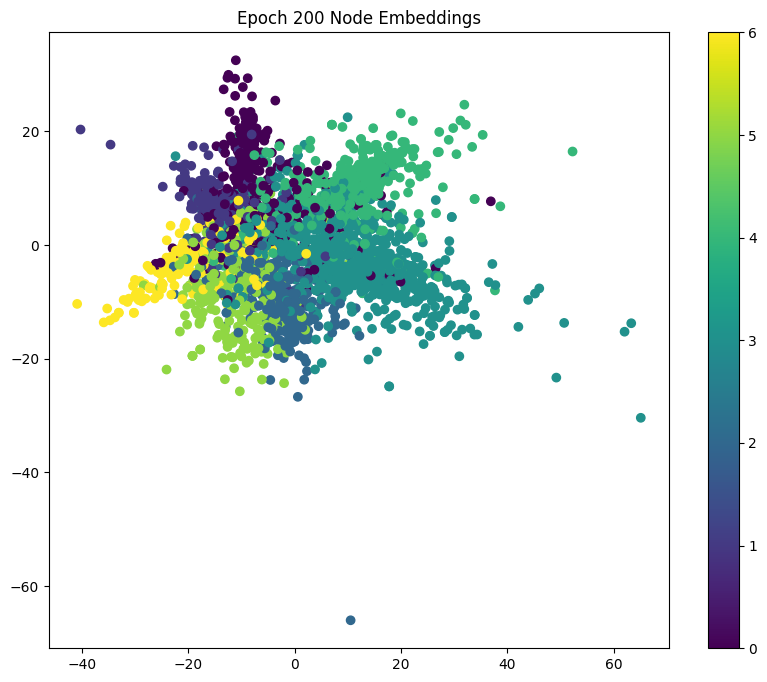

In [ ]:
writer1 = SummaryWriter('runs/model1')

epochs1 = []
train_losses1 = []
train_accuracies1 = []
val_accuracies1 = []
test_accuracies1 = []
precisions1 = []
recalls1 = []
f1_scores1 = []

num_epochs = 200
for epoch in range(1, num_epochs + 1):
    loss1 = train(data, data.train_mask, model1, optimizer1, criterion1)
    train_acc1 = test(data, data.train_mask, model1)
    val_acc1 = test(data, data.val_mask, model1)
    test_acc1 = test(data, data.test_mask, model1)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()  # True labels
    y_pred_test = model1(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()  # Predicted labels

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs1.append(epoch)
        train_losses1.append(loss1.detach().item() if isinstance(loss1, torch.Tensor) else loss1)
        train_accuracies1.append(train_acc1.detach().item() if isinstance(train_acc1, torch.Tensor) else train_acc1)
        val_accuracies1.append(val_acc1.detach().item() if isinstance(val_acc1, torch.Tensor) else val_acc1)
        test_accuracies1.append(test_acc1.detach().item() if isinstance(test_acc1, torch.Tensor) else test_acc1)
        precisions1.append(precision)
        recalls1.append(recall)
        f1_scores1.append(f1)

        print(f'Model 1 - Epoch: {epoch:03d}, Loss: {loss1:.4f}, Train: {train_acc1:.4f}, Val: {val_acc1:.4f}, Test: {test_acc1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model1(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer1.add_scalar('Loss/Train', loss1, epoch)
    writer1.add_scalar('Accuracy/Train', train_acc1, epoch)
    writer1.add_scalar('Accuracy/Validation', val_acc1, epoch)
    writer1.add_scalar('Accuracy/Test', test_acc1, epoch)
    writer1.add_scalar('Precision/Test', precision, epoch)
    writer1.add_scalar('Recall/Test', recall, epoch)
    writer1.add_scalar('F1-Score/Test', f1, epoch)

writer1.close()

# Learning Curve for Base Model

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs1, y=train_losses1, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs1, y=train_accuracies1, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs1, y=val_accuracies1, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs1, y=test_accuracies1, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Default Model | Mohamed Khairi and Mostapha Abdelaziz',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'second' model after tuning - Mohamed Khairi

Model 2 - Epoch: 010, Loss: 1.1414, Train: 0.9000, Val: 0.7180, Test: 0.7190, Precision: 0.7656, Recall: 0.7190, F1: 0.7152
Node Embeddings (Epoch 10):
[[-0.9114009  -1.2615876 ]
 [ 2.5576227   0.3245104 ]
 [ 1.8408877  -0.39630538]
 ...
 [-1.6682085   0.24637742]
 [-0.24780427 -0.8848886 ]
 [-0.3855394  -0.839891  ]]


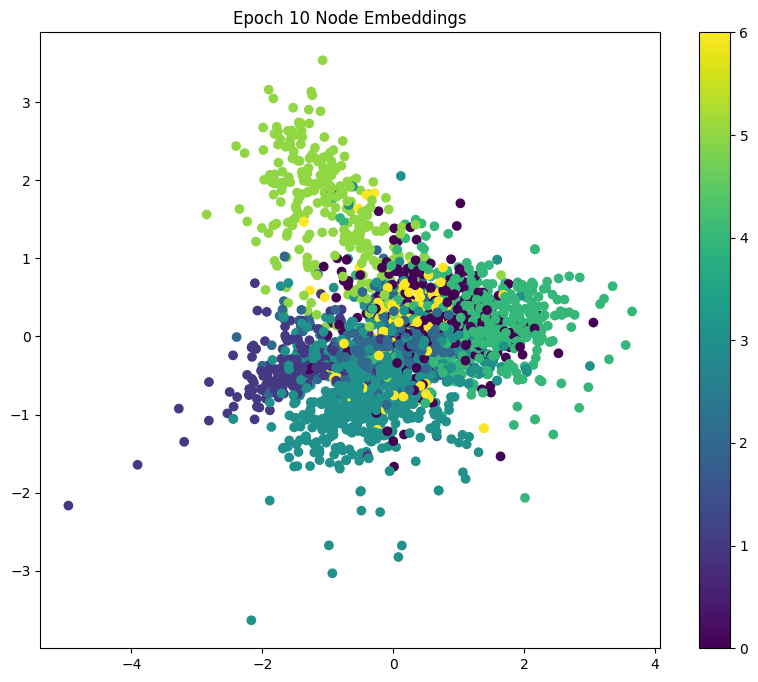

Model 2 - Epoch: 020, Loss: 0.5969, Train: 0.9714, Val: 0.7580, Test: 0.7390, Precision: 0.7765, Recall: 0.7390, F1: 0.7393
Node Embeddings (Epoch 20):
[[ 2.8595855   0.39217326]
 [-4.301175    1.3453375 ]
 [-2.8113773   1.7065051 ]
 ...
 [ 2.5155203  -2.240135  ]
 [ 1.692297    1.6205873 ]
 [ 1.7973998   1.3027279 ]]


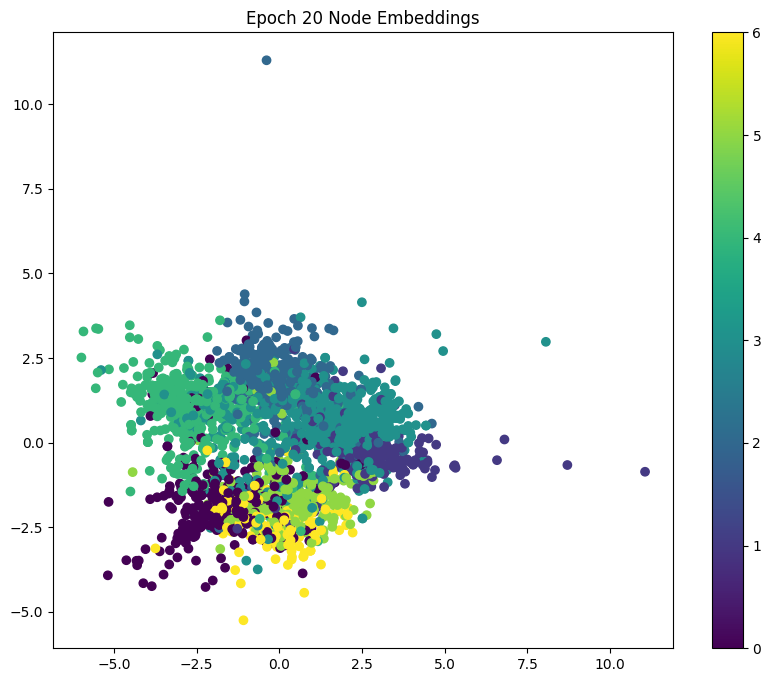

Model 2 - Epoch: 030, Loss: 0.3126, Train: 1.0000, Val: 0.7500, Test: 0.7550, Precision: 0.7814, Recall: 0.7550, F1: 0.7549
Node Embeddings (Epoch 30):
[[ 3.7357018   0.29470563]
 [-5.216401    2.037568  ]
 [-3.4161005   2.322826  ]
 ...
 [ 2.1251004  -3.8962426 ]
 [ 2.577283    2.1550493 ]
 [ 2.6770234   1.6143633 ]]


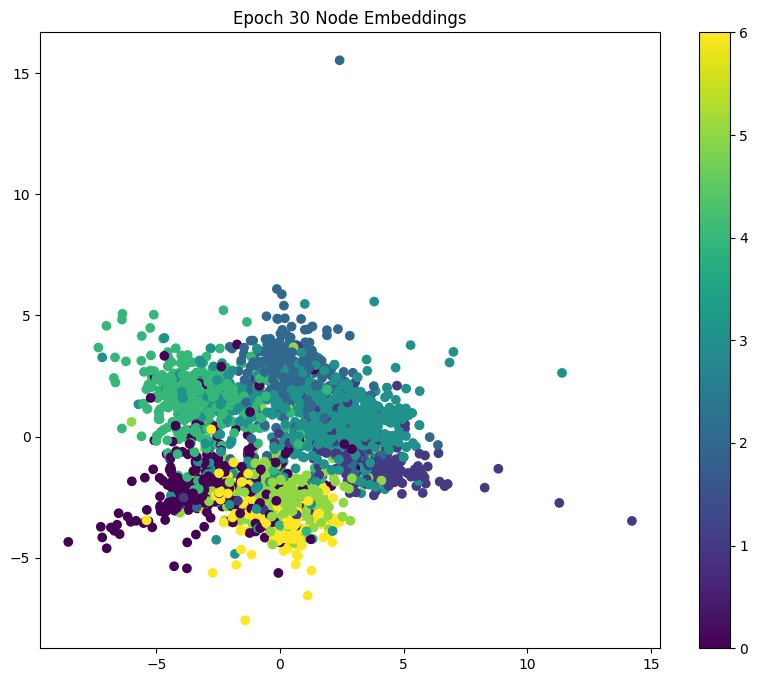

Model 2 - Epoch: 040, Loss: 0.1701, Train: 1.0000, Val: 0.7420, Test: 0.7620, Precision: 0.7847, Recall: 0.7620, F1: 0.7622
Node Embeddings (Epoch 40):
[[ 3.5794299  1.6024737]
 [-6.127887   2.41336  ]
 [-4.402365   2.757099 ]
 ...
 [ 2.3038046 -4.6310344]
 [ 2.5726476  3.1403778]
 [ 2.7571263  2.4359798]]


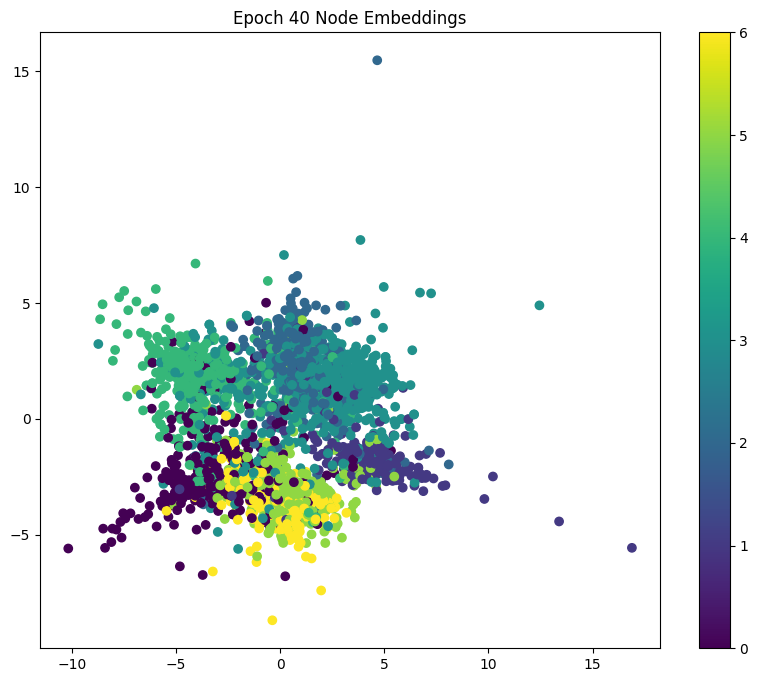

Model 2 - Epoch: 050, Loss: 0.1038, Train: 1.0000, Val: 0.7480, Test: 0.7510, Precision: 0.7728, Recall: 0.7510, F1: 0.7517
Node Embeddings (Epoch 50):
[[ 3.5815732  2.650958 ]
 [-6.864236   2.5249019]
 [-5.211283   2.9172683]
 ...
 [ 3.0185146 -4.9455094]
 [ 2.5516775  3.9926558]
 [ 2.821383   3.1685538]]


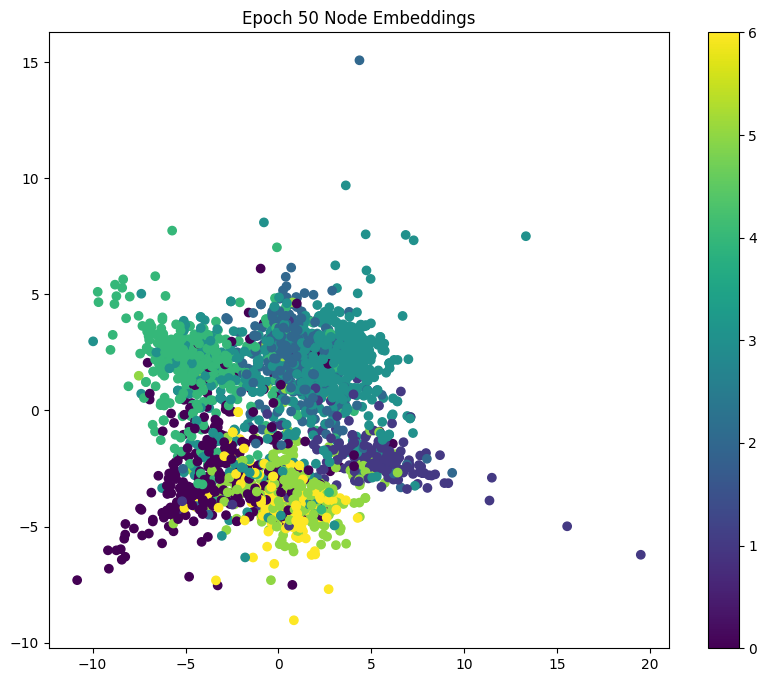

Model 2 - Epoch: 060, Loss: 0.0703, Train: 1.0000, Val: 0.7460, Test: 0.7450, Precision: 0.7674, Recall: 0.7450, F1: 0.7454
Node Embeddings (Epoch 60):
[[-3.9136708  3.204552 ]
 [ 7.39728    2.64077  ]
 [ 5.7913604  3.0390444]
 ...
 [-3.7339017 -5.1969814]
 [-2.71297    4.579607 ]
 [-3.0566628  3.6418445]]


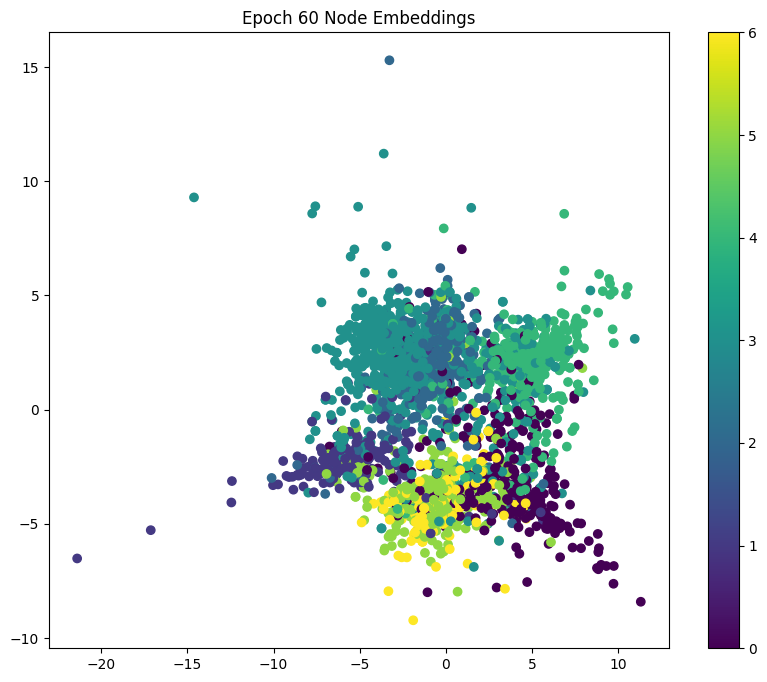

Model 2 - Epoch: 070, Loss: 0.0520, Train: 1.0000, Val: 0.7300, Test: 0.7420, Precision: 0.7652, Recall: 0.7420, F1: 0.7423
Node Embeddings (Epoch 70):
[[-4.194473   3.5919623]
 [ 7.8095365  2.7635102]
 [ 6.2573895  3.1577506]
 ...
 [-4.2515254 -5.4073954]
 [-2.8314857  5.0190406]
 [-3.2582548  3.9965878]]


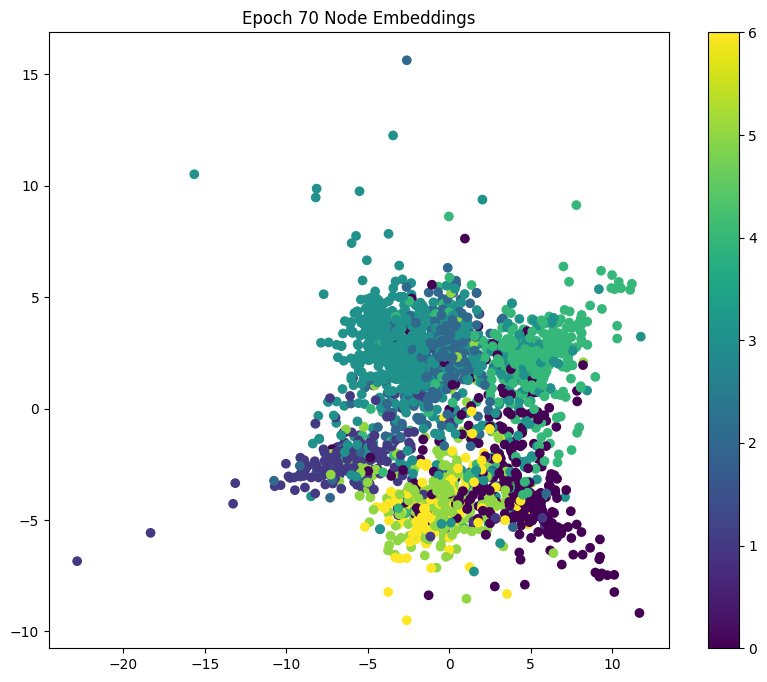

Model 2 - Epoch: 080, Loss: 0.0410, Train: 1.0000, Val: 0.7280, Test: 0.7330, Precision: 0.7586, Recall: 0.7330, F1: 0.7330
Node Embeddings (Epoch 80):
[[-4.3654914  3.9201198]
 [ 8.137396   2.8772647]
 [ 6.6195917  3.2668166]
 ...
 [-4.6580105 -5.568103 ]
 [-2.908323   5.361233 ]
 [-3.4031367  4.2778053]]


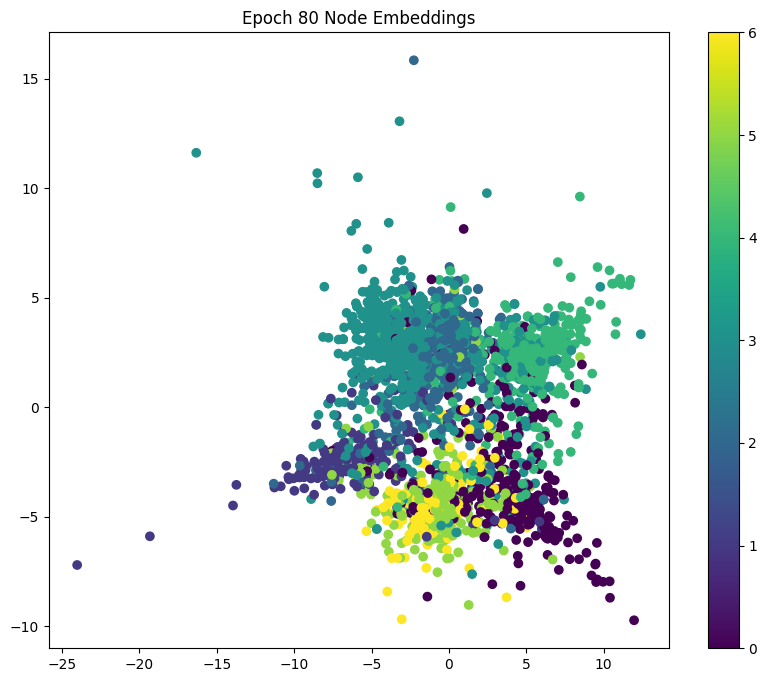

Model 2 - Epoch: 090, Loss: 0.0336, Train: 1.0000, Val: 0.7200, Test: 0.7350, Precision: 0.7599, Recall: 0.7350, F1: 0.7348
Node Embeddings (Epoch 90):
[[-4.467603   4.2356415]
 [ 8.40963    2.968108 ]
 [ 6.919139   3.3543983]
 ...
 [-5.0088367 -5.6739883]
 [-2.938691   5.6528044]
 [-3.4968758  4.527647 ]]


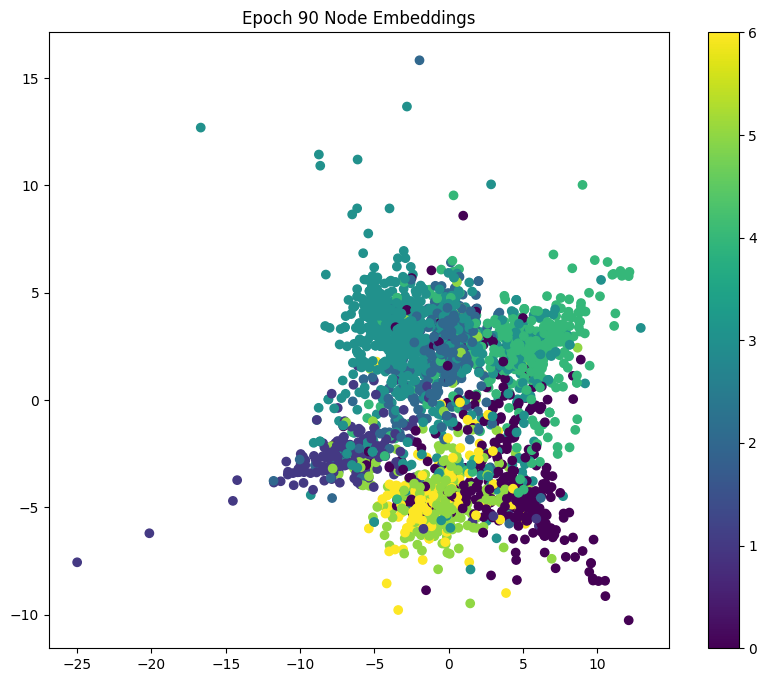

Model 2 - Epoch: 100, Loss: 0.0284, Train: 1.0000, Val: 0.7180, Test: 0.7300, Precision: 0.7552, Recall: 0.7300, F1: 0.7295
Node Embeddings (Epoch 100):
[[-4.526441   4.5452323]
 [ 8.651813   3.0243669]
 [ 7.1909647  3.4094763]
 ...
 [-5.338933  -5.7258015]
 [-2.9186301  5.917463 ]
 [-3.543367   4.7643185]]


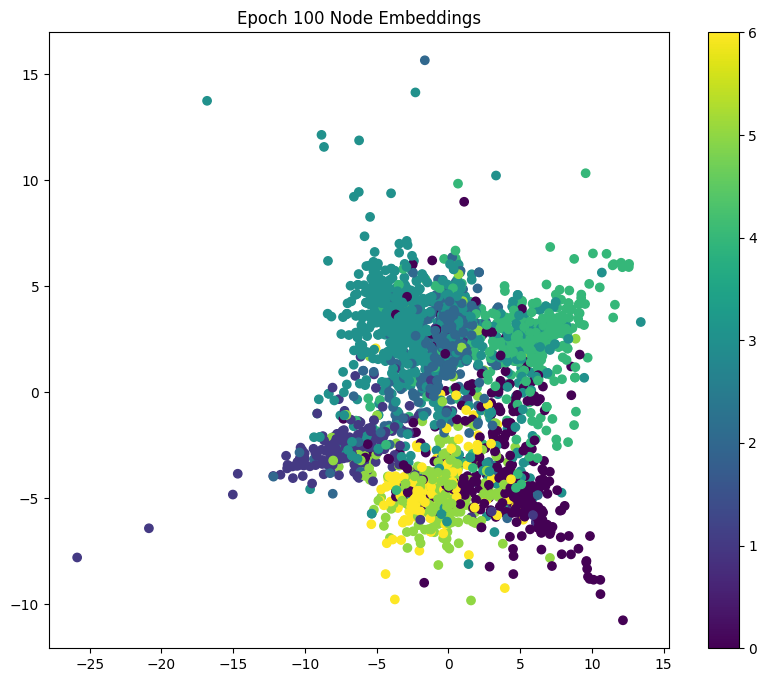

Model 2 - Epoch: 110, Loss: 0.0245, Train: 1.0000, Val: 0.7180, Test: 0.7310, Precision: 0.7593, Recall: 0.7310, F1: 0.7306
Node Embeddings (Epoch 110):
[[-4.5586166  4.833942 ]
 [ 8.879515   3.0530577]
 [ 7.446869   3.4368572]
 ...
 [-5.6627555 -5.737379 ]
 [-2.8774767  6.1555476]
 [-3.563981   4.982366 ]]


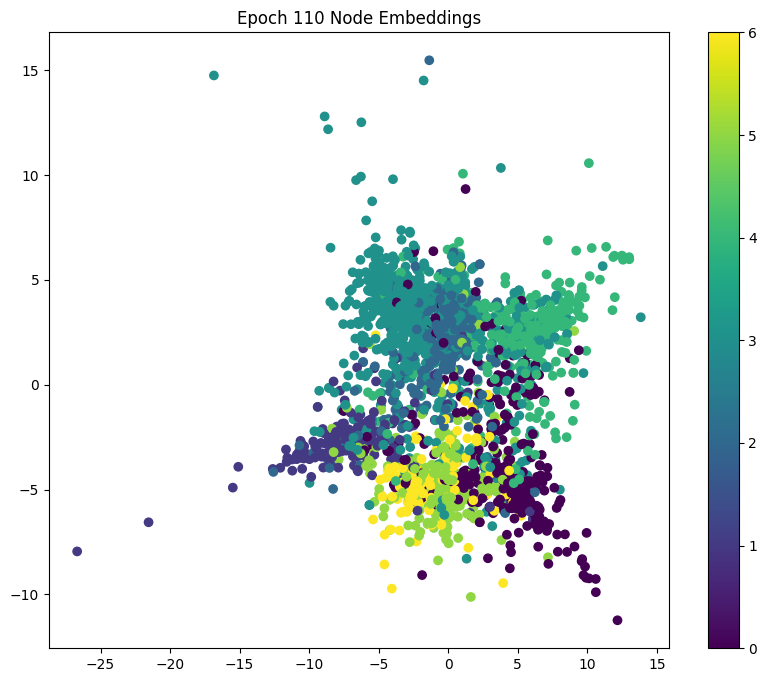

Model 2 - Epoch: 120, Loss: 0.0214, Train: 1.0000, Val: 0.7180, Test: 0.7320, Precision: 0.7599, Recall: 0.7320, F1: 0.7317
Node Embeddings (Epoch 120):
[[-4.5818825  5.095722 ]
 [ 9.09341    3.0752497]
 [ 7.684952   3.4550433]
 ...
 [-5.964712  -5.731221 ]
 [-2.8444028  6.3675566]
 [-3.5826     5.1783414]]


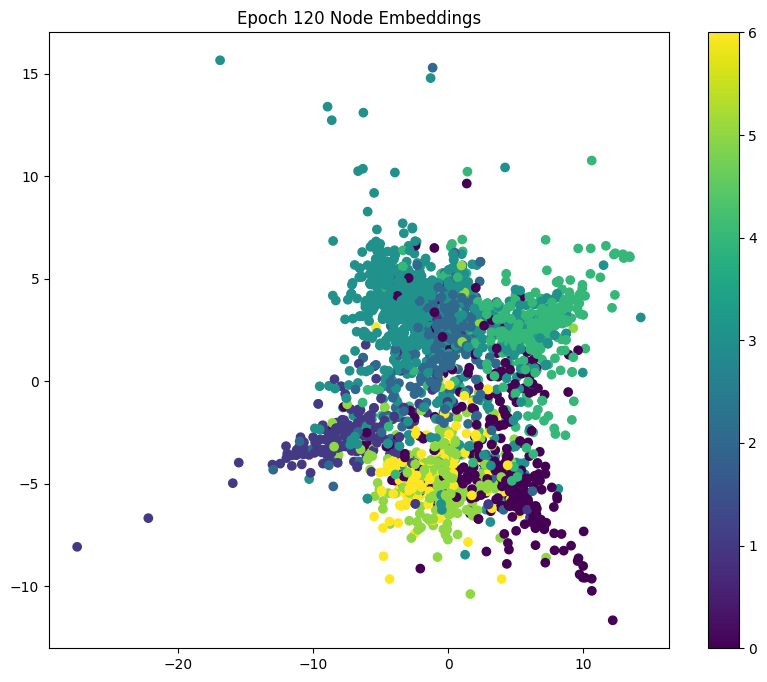

Model 2 - Epoch: 130, Loss: 0.0189, Train: 1.0000, Val: 0.7160, Test: 0.7290, Precision: 0.7572, Recall: 0.7290, F1: 0.7289
Node Embeddings (Epoch 130):
[[-4.606625   5.333082 ]
 [ 9.291497   3.1038713]
 [ 7.9029117  3.476417 ]
 ...
 [-6.2343035 -5.721792 ]
 [-2.8274806  6.557493 ]
 [-3.608144   5.354243 ]]


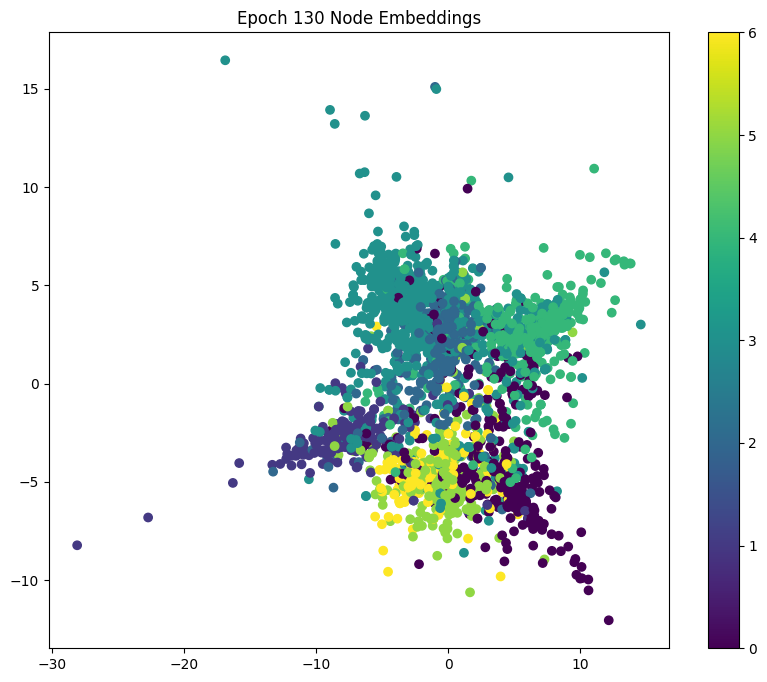

Model 2 - Epoch: 140, Loss: 0.0169, Train: 1.0000, Val: 0.7140, Test: 0.7280, Precision: 0.7559, Recall: 0.7280, F1: 0.7278
Node Embeddings (Epoch 140):
[[-4.6319165  5.552289 ]
 [ 9.47602    3.1390548]
 [ 8.10266    3.502696 ]
 ...
 [-6.473933  -5.709738 ]
 [-2.8200512  6.73002  ]
 [-3.6370327  5.514638 ]]


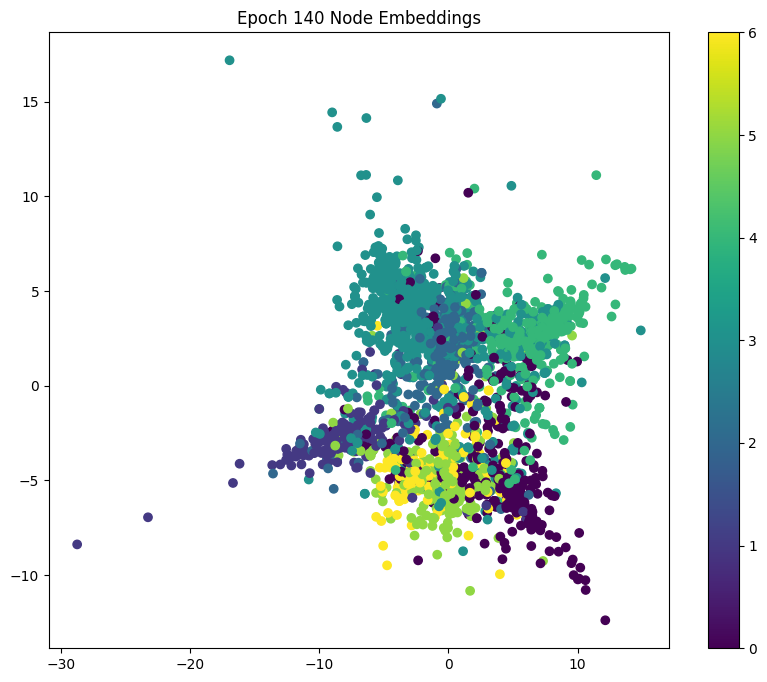

Model 2 - Epoch: 150, Loss: 0.0152, Train: 1.0000, Val: 0.7100, Test: 0.7260, Precision: 0.7554, Recall: 0.7260, F1: 0.7257
Node Embeddings (Epoch 150):
[[-4.654646   5.7577944]
 [ 9.650213   3.1775055]
 [ 8.287329   3.5322113]
 ...
 [-6.6911254 -5.6915483]
 [-2.8156424  6.8885994]
 [-3.6647153  5.6629744]]


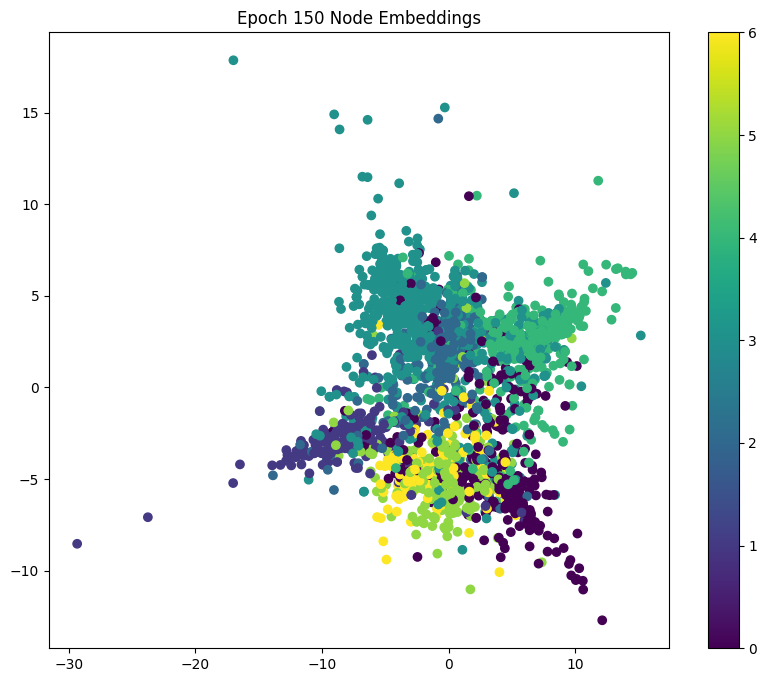

Model 2 - Epoch: 160, Loss: 0.0138, Train: 1.0000, Val: 0.7100, Test: 0.7230, Precision: 0.7535, Recall: 0.7230, F1: 0.7224
Node Embeddings (Epoch 160):
[[-4.6735067  5.952047 ]
 [ 9.816261   3.216352 ]
 [ 8.459846   3.5628138]
 ...
 [-6.89226   -5.6660066]
 [-2.8109918  7.0358067]
 [-3.68892    5.801494 ]]


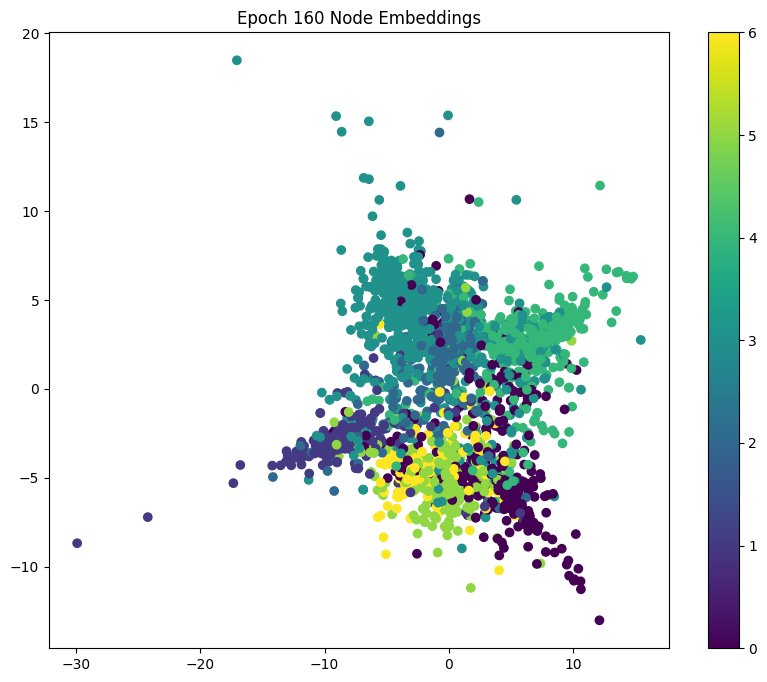

Model 2 - Epoch: 170, Loss: 0.0126, Train: 1.0000, Val: 0.7100, Test: 0.7210, Precision: 0.7522, Recall: 0.7210, F1: 0.7202
Node Embeddings (Epoch 170):
[[-4.688122   6.137452 ]
 [ 9.975658   3.2537081]
 [ 8.622819   3.5927699]
 ...
 [-7.08024   -5.6337967]
 [-2.8047867  7.174094 ]
 [-3.7090645  5.9324837]]


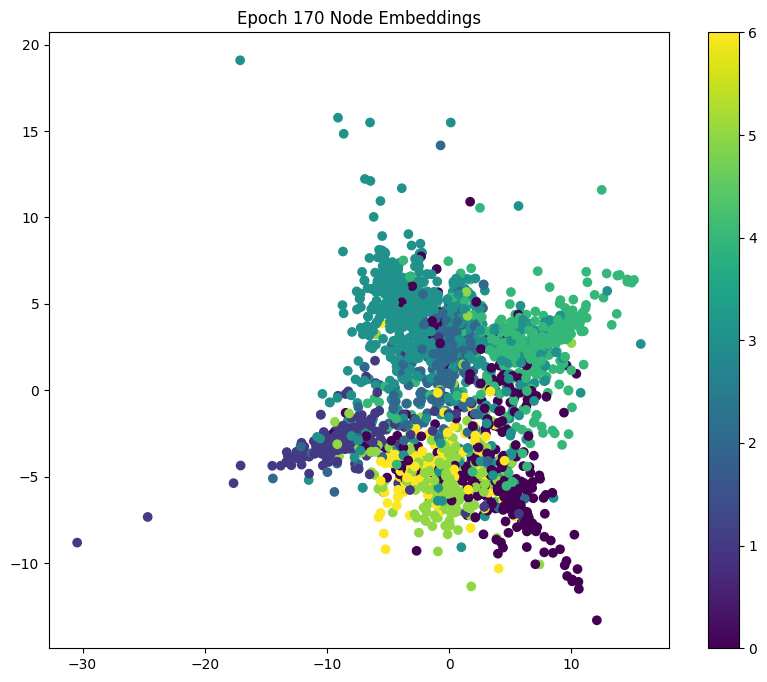

Model 2 - Epoch: 180, Loss: 0.0116, Train: 1.0000, Val: 0.7100, Test: 0.7210, Precision: 0.7522, Recall: 0.7210, F1: 0.7202
Node Embeddings (Epoch 180):
[[-4.6988397  6.3157387]
 [10.129075   3.2887042]
 [ 8.777862   3.6210954]
 ...
 [-7.2560463 -5.5964575]
 [-2.7967813  7.305176 ]
 [-3.7254822  6.057598 ]]


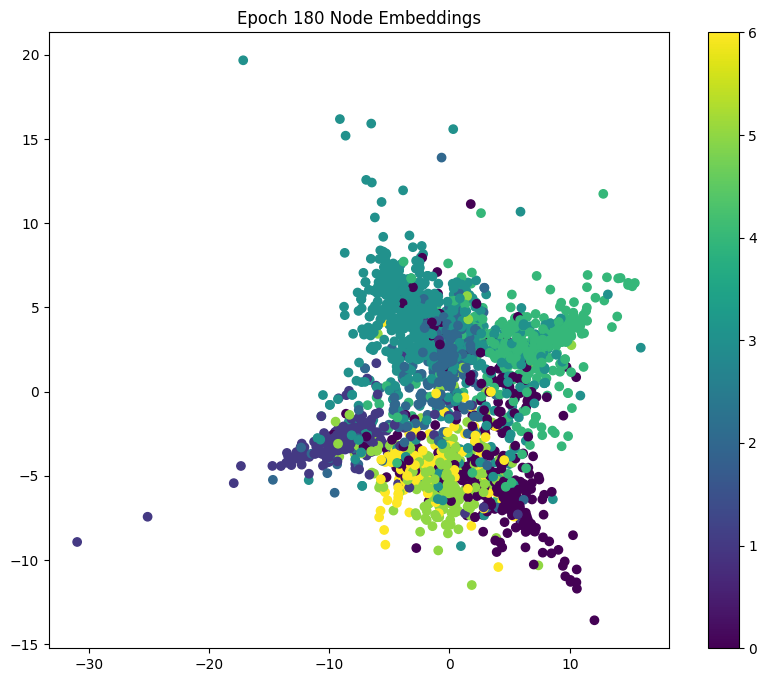

Model 2 - Epoch: 190, Loss: 0.0107, Train: 1.0000, Val: 0.7080, Test: 0.7190, Precision: 0.7501, Recall: 0.7190, F1: 0.7185
Node Embeddings (Epoch 190):
[[-4.706267   6.4875083]
 [10.277108   3.3212557]
 [ 8.926115   3.6475239]
 ...
 [-7.4207726 -5.5553513]
 [-2.7876592  7.4298844]
 [-3.7389789  6.1774783]]


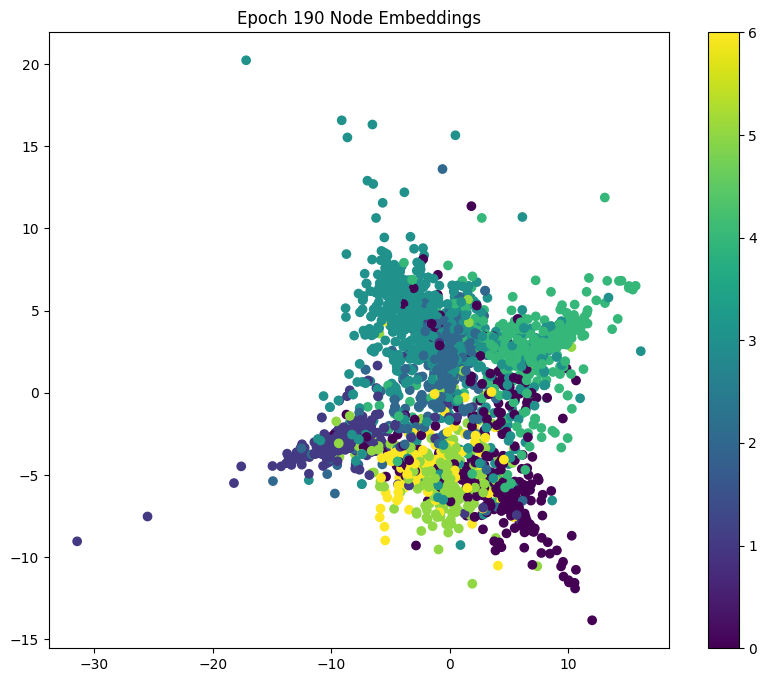

Model 2 - Epoch: 200, Loss: 0.0099, Train: 1.0000, Val: 0.7100, Test: 0.7200, Precision: 0.7513, Recall: 0.7200, F1: 0.7197
Node Embeddings (Epoch 200):
[[-4.7109637  6.6530256]
 [10.42019    3.3515294]
 [ 9.068372   3.6720731]
 ...
 [-7.5755687 -5.5115404]
 [-2.7778041  7.5487185]
 [-3.7500737  6.2924585]]


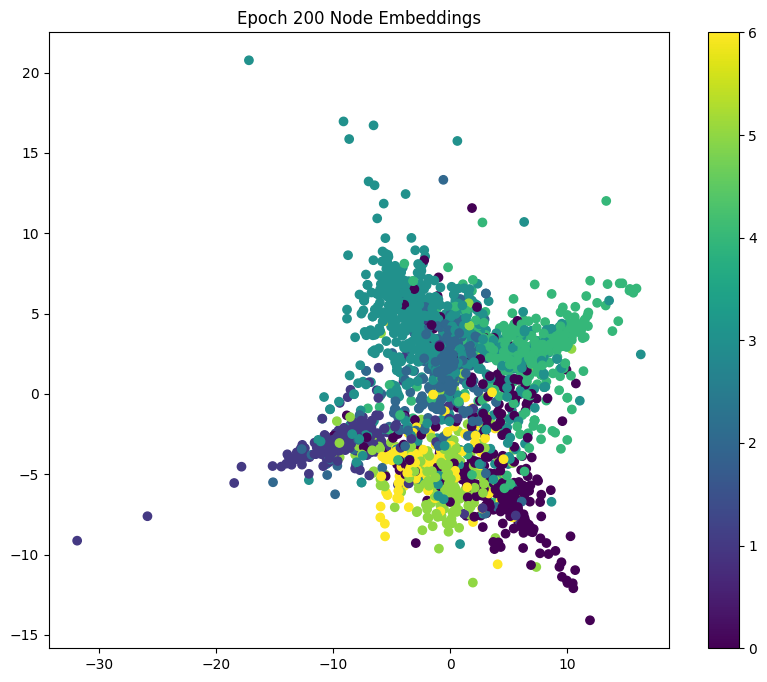

In [ ]:
writer2 = SummaryWriter('runs/model2')

epochs2 = []
train_losses2 = []
train_accuracies2 = []
val_accuracies2 = []
test_accuracies2 = []
precisions2 = []
recalls2 = []
f1_scores2 = []

for epoch in range(1, num_epochs + 1):
    loss2 = train(data, data.train_mask, model2, optimizer2, criterion2)
    train_acc2 = test(data, data.train_mask, model2)
    val_acc2 = test(data, data.val_mask, model2)
    test_acc2 = test(data, data.test_mask, model2)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model2(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs2.append(epoch)
        train_losses2.append(loss2.detach().item() if isinstance(loss2, torch.Tensor) else loss2)
        train_accuracies2.append(train_acc2.detach().item() if isinstance(train_acc2, torch.Tensor) else train_acc2)
        val_accuracies2.append(val_acc2.detach().item() if isinstance(val_acc2, torch.Tensor) else val_acc2)
        test_accuracies2.append(test_acc2.detach().item() if isinstance(test_acc2, torch.Tensor) else test_acc2)
        precisions2.append(precision)
        recalls2.append(recall)
        f1_scores2.append(f1)

        print(f'Model 2 - Epoch: {epoch:03d}, Loss: {loss2:.4f}, Train: {train_acc2:.4f}, Val: {val_acc2:.4f}, Test: {test_acc2:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model2(data.x, data.edge_index)

        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer2.add_scalar('Loss/Train', loss2, epoch)
    writer2.add_scalar('Accuracy/Train', train_acc2, epoch)
    writer2.add_scalar('Accuracy/Validation', val_acc2, epoch)
    writer2.add_scalar('Accuracy/Test', test_acc2, epoch)
    writer2.add_scalar('Precision/Test', precision, epoch)
    writer2.add_scalar('Recall/Test', recall, epoch)
    writer2.add_scalar('F1-Score/Test', f1, epoch)

writer2.close()

# Learning Curve for Second Model | Mohamed Khairi

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs2, y=train_losses2, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs2, y=train_accuracies2, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs2, y=val_accuracies2, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs2, y=test_accuracies2, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Second Model | Mohamed Khairi',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'third' model after tuning -  Mostapha Abdelaziz

Model 3 - Epoch: 010, Loss: 1.8342, Train: 0.3571, Val: 0.3860, Test: 0.3910, Precision: 0.6979, Recall: 0.3910, F1: 0.2663
Node Embeddings (Epoch 10):
[[-0.04659086 -0.04983265]
 [-0.23961991 -0.1975802 ]
 [-0.2087661  -0.2164599 ]
 ...
 [-0.04128569  0.08495273]
 [-0.12379992 -0.06181075]
 [-0.00668734 -0.08595893]]


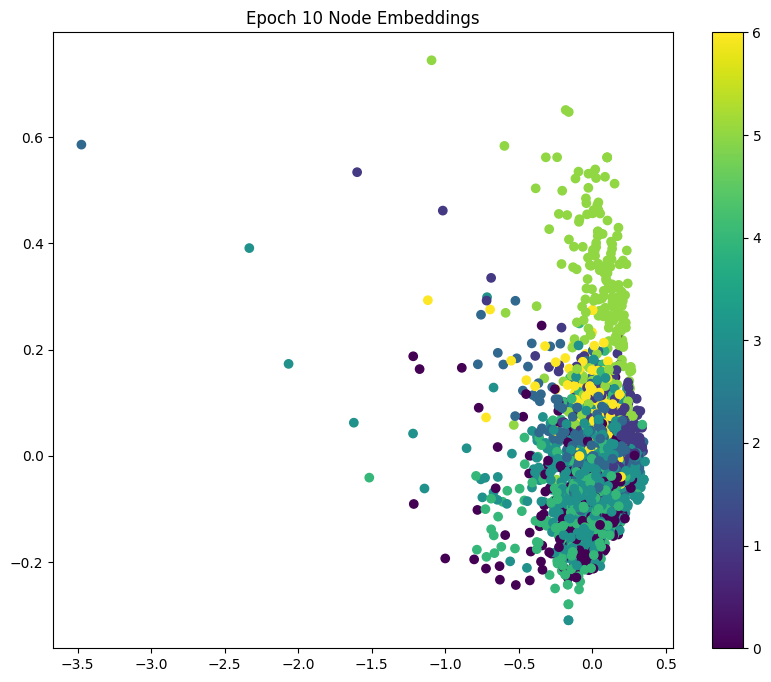

Model 3 - Epoch: 020, Loss: 1.5279, Train: 0.8429, Val: 0.5020, Test: 0.5170, Precision: 0.7674, Recall: 0.5170, F1: 0.4680
Node Embeddings (Epoch 20):
[[-0.20946714 -0.02220643]
 [-0.92574644  0.094156  ]
 [-0.8967099   0.1427318 ]
 ...
 [ 0.46144718 -0.20192778]
 [-0.35336763  0.05786481]
 [-0.32976332  0.16725901]]


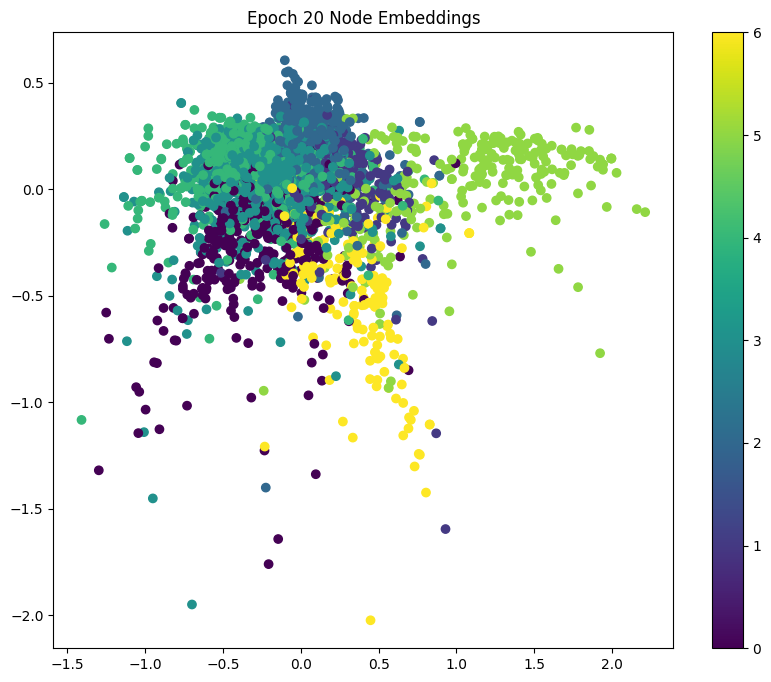

Model 3 - Epoch: 030, Loss: 1.0848, Train: 0.9214, Val: 0.7080, Test: 0.7210, Precision: 0.7687, Recall: 0.7210, F1: 0.7169
Node Embeddings (Epoch 30):
[[-0.62703824  0.06767806]
 [-2.23402    -0.48267564]
 [-2.0836484  -0.4626449 ]
 ...
 [ 1.3582717   0.7201326 ]
 [-0.8494203  -0.3444506 ]
 [-0.73342574 -0.37608504]]


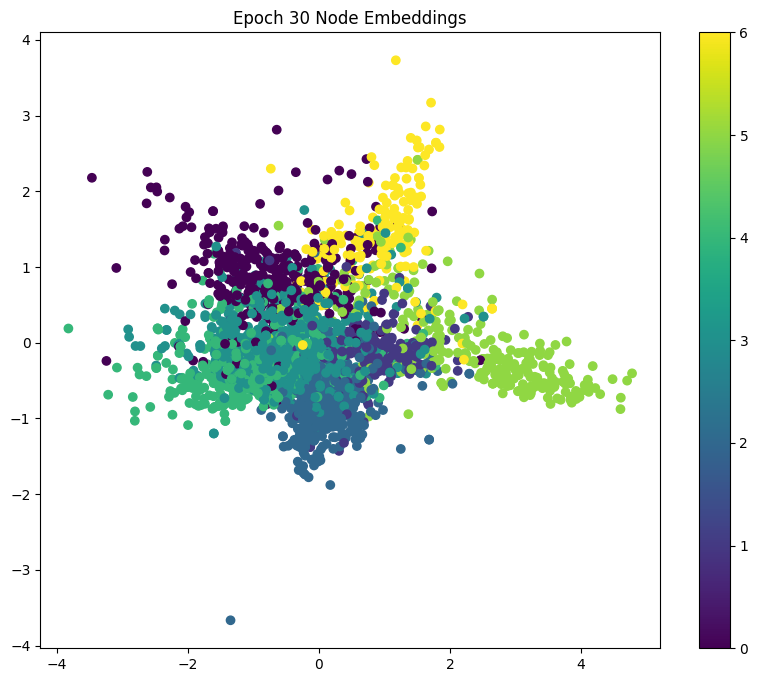

Model 3 - Epoch: 040, Loss: 0.6931, Train: 0.9643, Val: 0.7380, Test: 0.7450, Precision: 0.7846, Recall: 0.7450, F1: 0.7436
Node Embeddings (Epoch 40):
[[-1.112537   -0.13857913]
 [-3.659243    0.68104583]
 [-3.3252027   0.67838126]
 ...
 [ 2.277552   -1.7194532 ]
 [-1.3229074   0.6660249 ]
 [-1.0743979   0.7147032 ]]


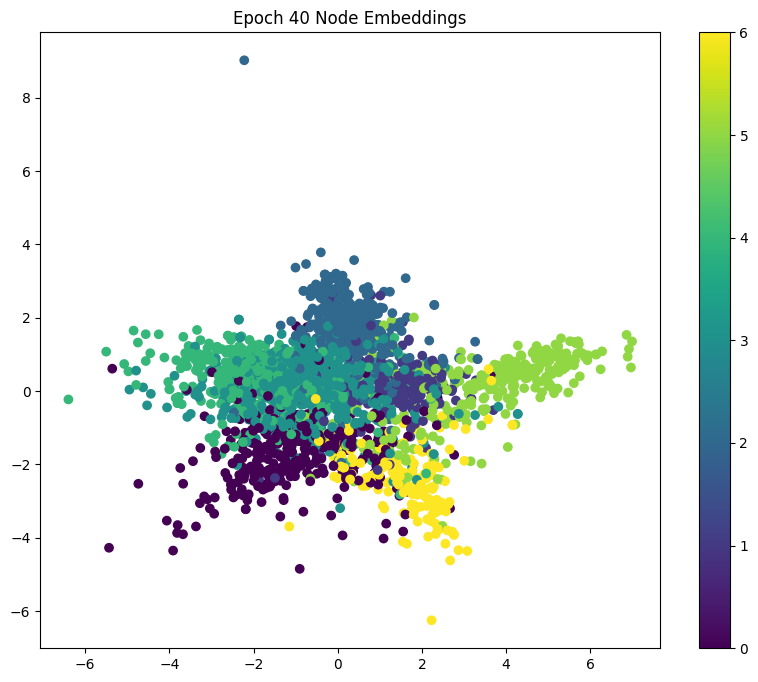

Model 3 - Epoch: 050, Loss: 0.4359, Train: 0.9857, Val: 0.7880, Test: 0.7960, Precision: 0.8150, Recall: 0.7960, F1: 0.7984
Node Embeddings (Epoch 50):
[[-1.4002634  -0.26494852]
 [-5.0218267   0.77978116]
 [-4.434753    0.8352657 ]
 ...
 [ 2.9063177  -2.657759  ]
 [-1.7604038   0.872117  ]
 [-1.363331    0.9326331 ]]


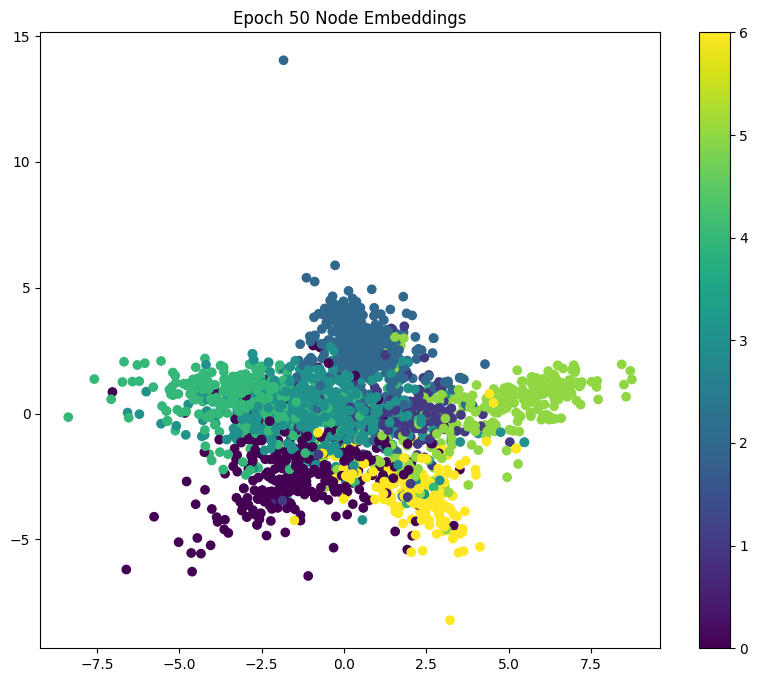

Model 3 - Epoch: 060, Loss: 0.2830, Train: 1.0000, Val: 0.7920, Test: 0.8110, Precision: 0.8249, Recall: 0.8110, F1: 0.8126
Node Embeddings (Epoch 60):
[[ 1.5437224  -0.32643506]
 [ 6.0517406   0.6741557 ]
 [ 5.2482977   0.8023038 ]
 ...
 [-3.297202   -3.2214515 ]
 [ 2.0653281   0.90759265]
 [ 1.5801573   0.960513  ]]


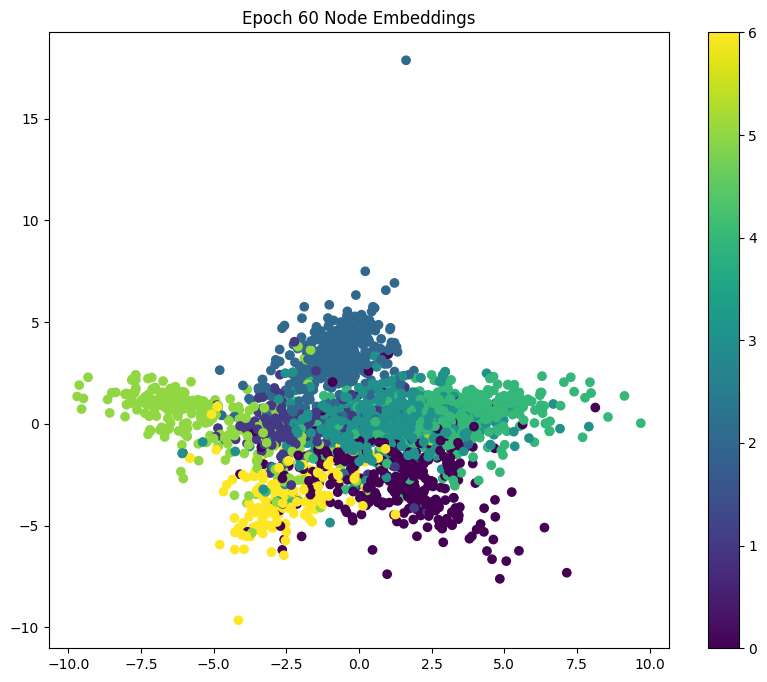

Model 3 - Epoch: 070, Loss: 0.1966, Train: 1.0000, Val: 0.7880, Test: 0.8150, Precision: 0.8284, Recall: 0.8150, F1: 0.8168
Node Embeddings (Epoch 70):
[[ 1.5120122  -0.33211938]
 [ 6.701388    0.49067184]
 [ 5.7614665   0.68007517]
 ...
 [-3.4424257  -3.5748336 ]
 [ 2.1154842   0.91793585]
 [ 1.6186016   0.9785304 ]]


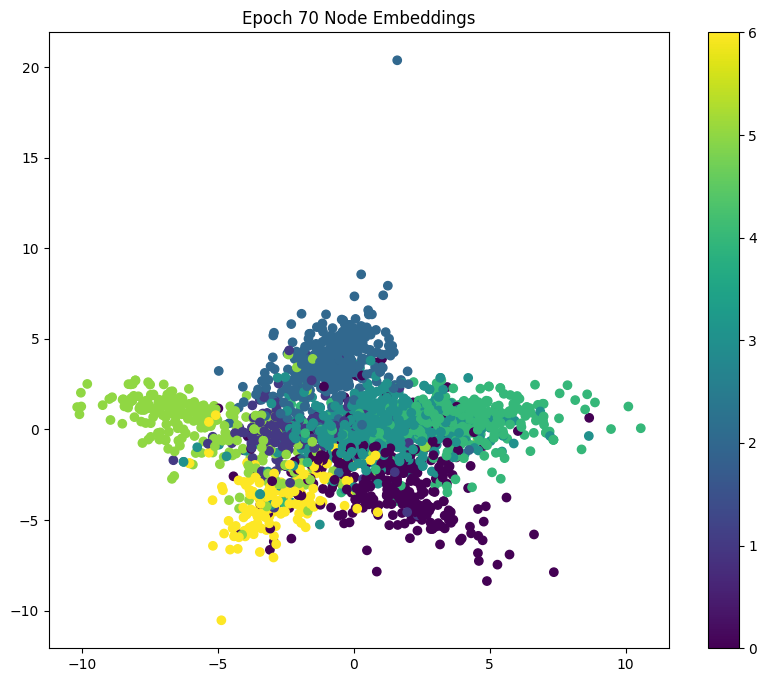

Model 3 - Epoch: 080, Loss: 0.1485, Train: 1.0000, Val: 0.7880, Test: 0.8180, Precision: 0.8311, Recall: 0.8180, F1: 0.8196
Node Embeddings (Epoch 80):
[[ 1.4491596  -0.3276661 ]
 [ 7.1371884   0.26486665]
 [ 6.086469    0.47632915]
 ...
 [-3.571034   -3.7035475 ]
 [ 2.0502317   0.9441542 ]
 [ 1.5772872   1.0106382 ]]


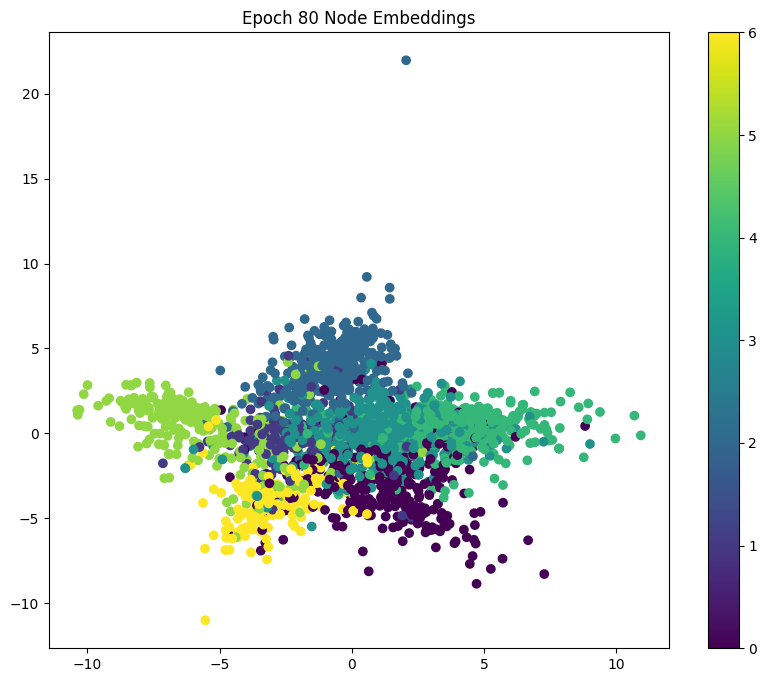

Model 3 - Epoch: 090, Loss: 0.1200, Train: 1.0000, Val: 0.7900, Test: 0.8190, Precision: 0.8303, Recall: 0.8190, F1: 0.8204
Node Embeddings (Epoch 90):
[[ 1.3486731  -0.3680744 ]
 [ 7.4450703   0.06551445]
 [ 6.293053    0.26383558]
 ...
 [-3.6407335  -3.7608194 ]
 [ 1.9448521   0.9675807 ]
 [ 1.4979379   1.0300524 ]]


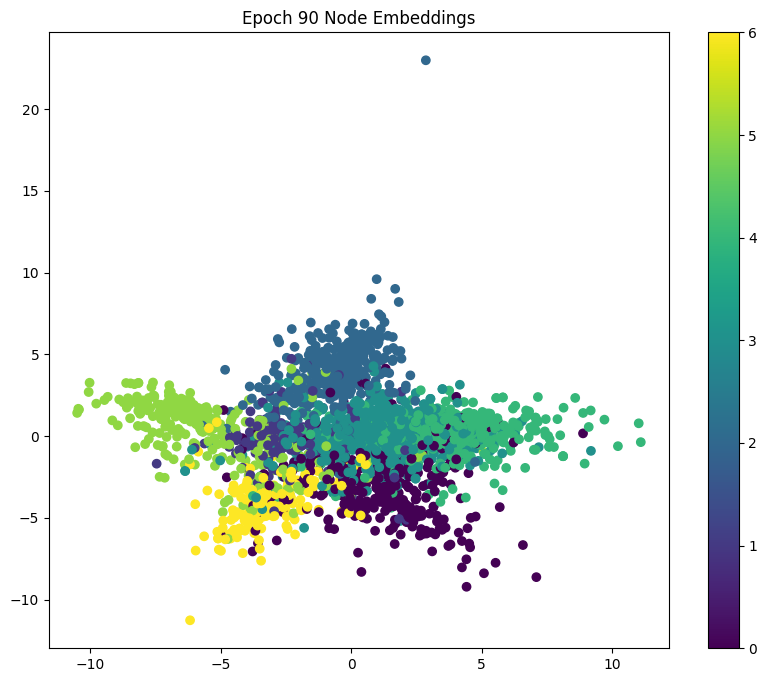

Model 3 - Epoch: 100, Loss: 0.1018, Train: 1.0000, Val: 0.7880, Test: 0.8180, Precision: 0.8279, Recall: 0.8180, F1: 0.8193
Node Embeddings (Epoch 100):
[[ 1.2423294  -0.42962745]
 [ 7.6721697  -0.1540935 ]
 [ 6.4264936   0.03052193]
 ...
 [-3.76576    -3.7745872 ]
 [ 1.8863924   0.95830494]
 [ 1.4554067   1.0204091 ]]


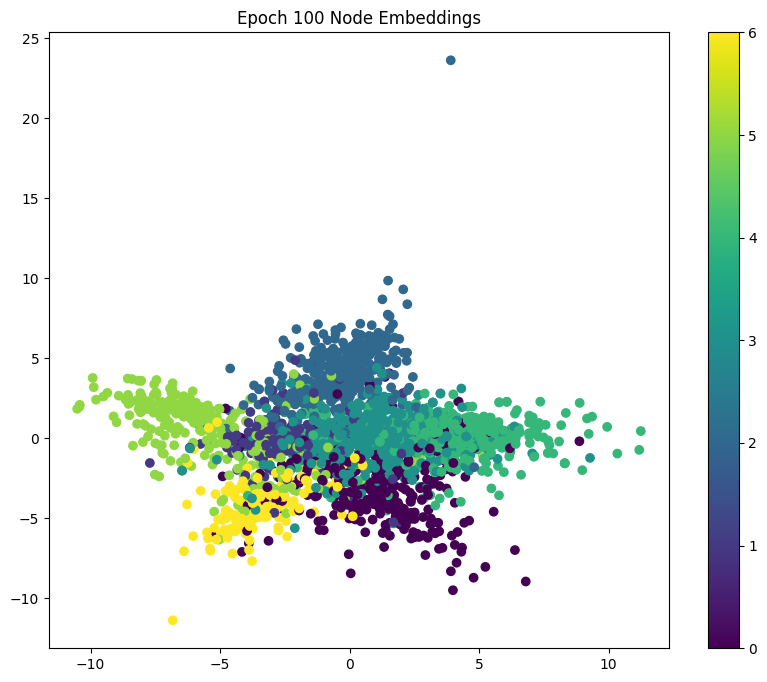

Model 3 - Epoch: 110, Loss: 0.0892, Train: 1.0000, Val: 0.7920, Test: 0.8210, Precision: 0.8305, Recall: 0.8210, F1: 0.8223
Node Embeddings (Epoch 110):
[[ 1.1450479  -0.4969977 ]
 [ 7.831373   -0.3917245 ]
 [ 6.5100975  -0.21921903]
 ...
 [-3.9342813  -3.7388067 ]
 [ 1.8867354   0.9220521 ]
 [ 1.4603984   0.9918197 ]]


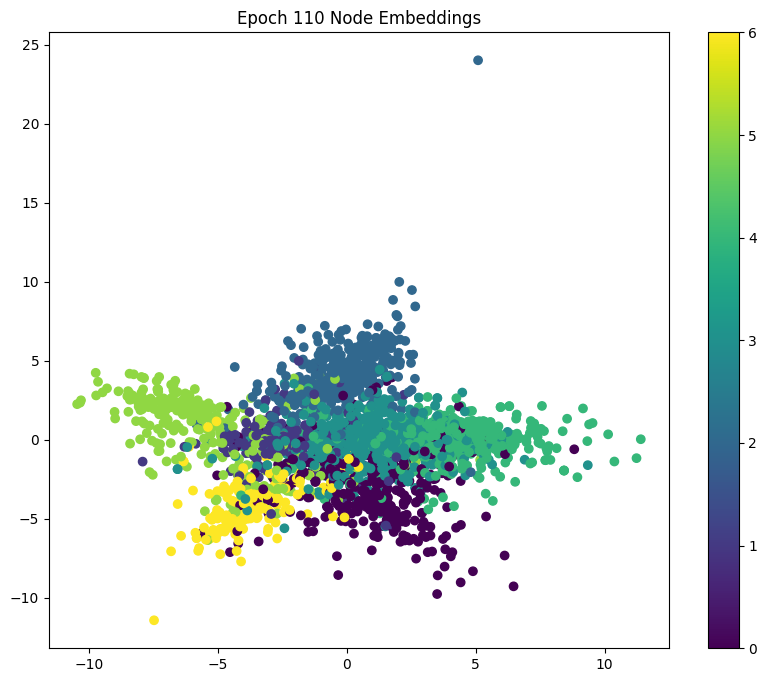

Model 3 - Epoch: 120, Loss: 0.0799, Train: 1.0000, Val: 0.7960, Test: 0.8200, Precision: 0.8290, Recall: 0.8200, F1: 0.8212
Node Embeddings (Epoch 120):
[[ 1.0665935  -0.5628201 ]
 [ 7.946972   -0.6535548 ]
 [ 6.562868   -0.48556903]
 ...
 [-4.1378345  -3.6590319 ]
 [ 1.9167318   0.8724779 ]
 [ 1.4905407   0.95345795]]


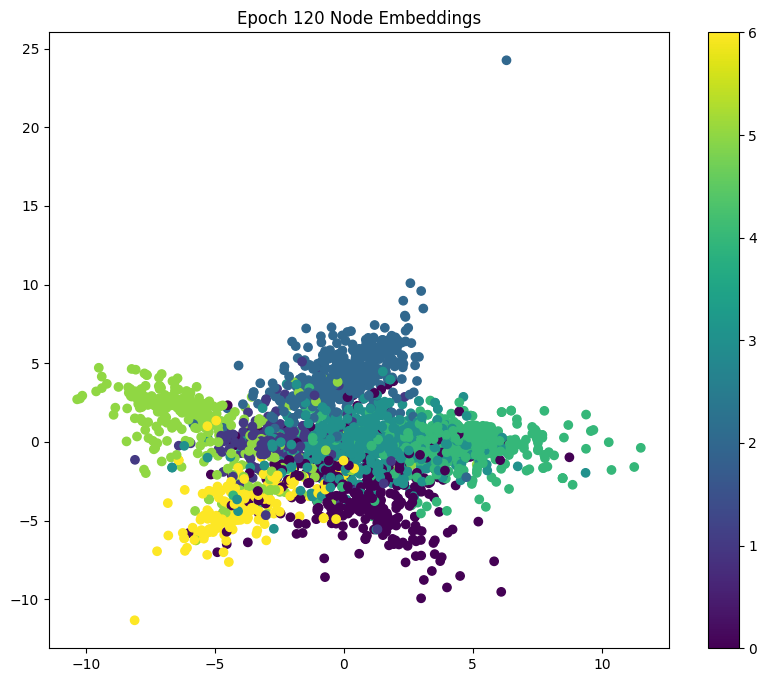

Model 3 - Epoch: 130, Loss: 0.0729, Train: 1.0000, Val: 0.7960, Test: 0.8210, Precision: 0.8291, Recall: 0.8210, F1: 0.8221
Node Embeddings (Epoch 130):
[[ 1.0016323  -0.6261398 ]
 [ 8.025997   -0.9398106 ]
 [ 6.5881677  -0.7629968 ]
 ...
 [-4.3449464  -3.5426297 ]
 [ 1.9491905   0.80737746]
 [ 1.5258733   0.90293705]]


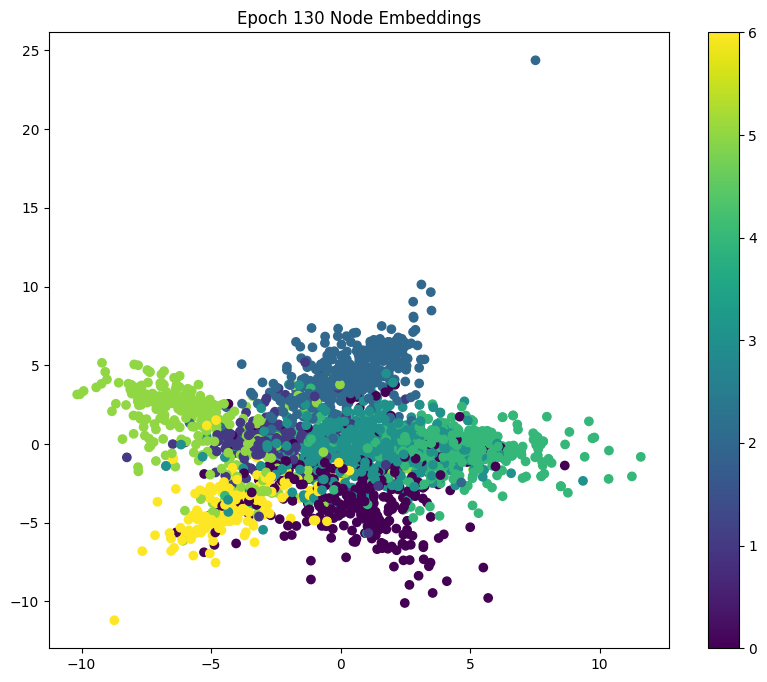

Model 3 - Epoch: 140, Loss: 0.0673, Train: 1.0000, Val: 0.7940, Test: 0.8210, Precision: 0.8291, Recall: 0.8210, F1: 0.8221
Node Embeddings (Epoch 140):
[[ 0.9384857  -0.68773115]
 [ 8.070515   -1.2388103 ]
 [ 6.586496   -1.0447363 ]
 ...
 [-4.544454   -3.399859  ]
 [ 1.9737594   0.7291043 ]
 [ 1.5559211   0.8413677 ]]


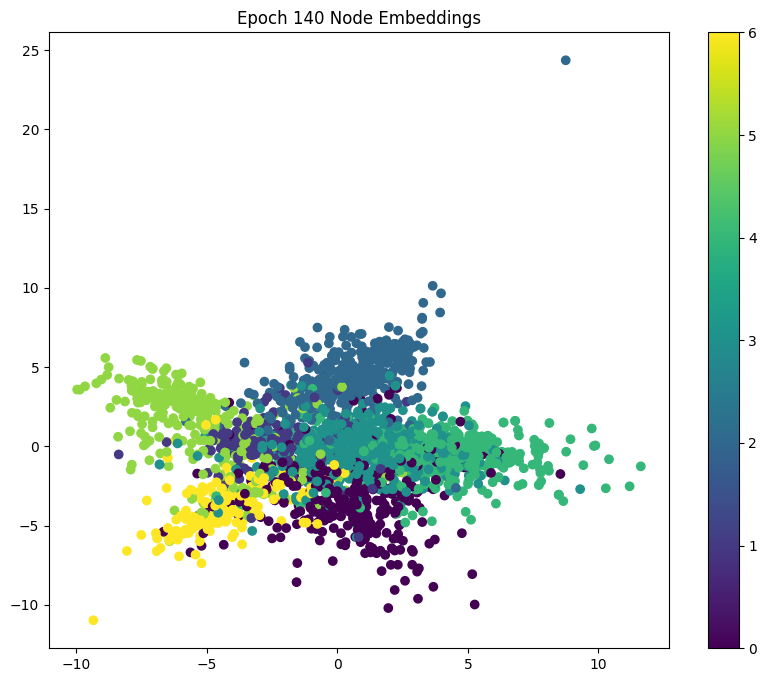

Model 3 - Epoch: 150, Loss: 0.0628, Train: 1.0000, Val: 0.7960, Test: 0.8190, Precision: 0.8271, Recall: 0.8190, F1: 0.8201
Node Embeddings (Epoch 150):
[[ 0.87610924 -0.7477105 ]
 [ 8.084112   -1.5489216 ]
 [ 6.5607347  -1.3289608 ]
 ...
 [-4.7386436  -3.2278752 ]
 [ 1.992415    0.64486104]
 [ 1.5818999   0.7742142 ]]


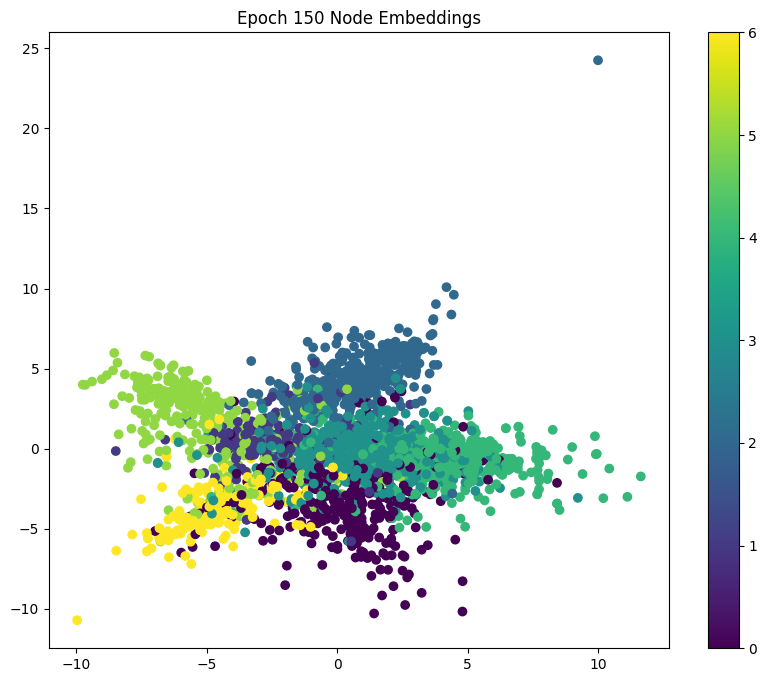

Model 3 - Epoch: 160, Loss: 0.0591, Train: 1.0000, Val: 0.7960, Test: 0.8180, Precision: 0.8260, Recall: 0.8180, F1: 0.8190
Node Embeddings (Epoch 160):
[[ 0.8159851  -0.8040887 ]
 [ 8.069788   -1.8612131 ]
 [ 6.51402    -1.6086833 ]
 ...
 [-4.917613   -3.0379083 ]
 [ 2.0073123   0.55611295]
 [ 1.6049051   0.70277715]]


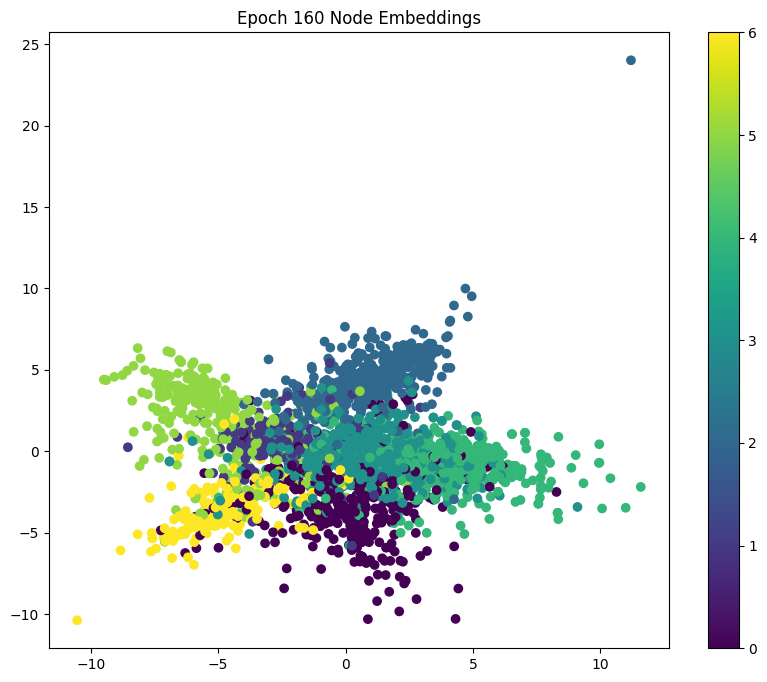

Model 3 - Epoch: 170, Loss: 0.0560, Train: 1.0000, Val: 0.7980, Test: 0.8180, Precision: 0.8255, Recall: 0.8180, F1: 0.8189
Node Embeddings (Epoch 170):
[[ 0.7577894  -0.85695904]
 [ 8.032987   -2.1661668 ]
 [ 6.450524   -1.8762362 ]
 ...
 [-5.076612   -2.8355653 ]
 [ 2.0201707   0.4661194 ]
 [ 1.6262561   0.62958014]]


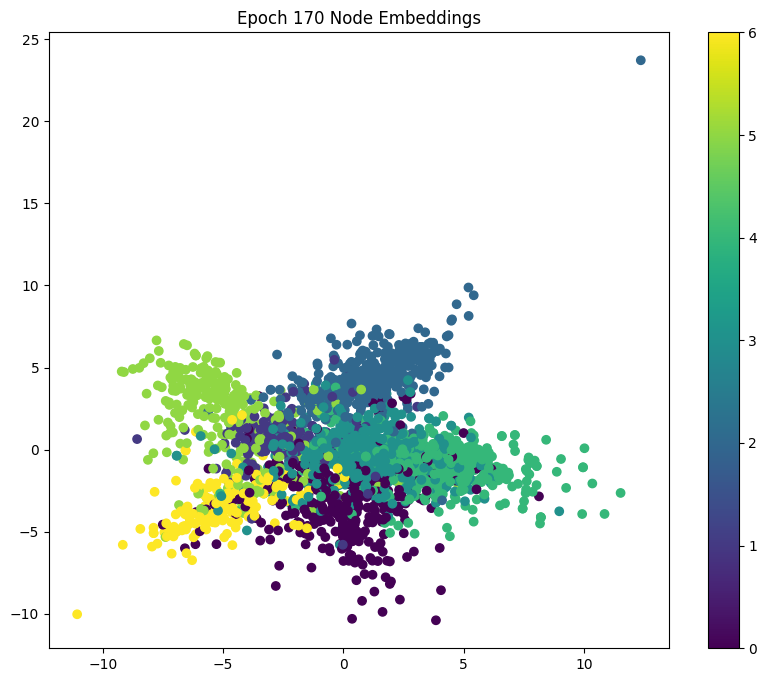

Model 3 - Epoch: 180, Loss: 0.0534, Train: 1.0000, Val: 0.7980, Test: 0.8180, Precision: 0.8254, Recall: 0.8180, F1: 0.8189
Node Embeddings (Epoch 180):
[[ 0.7031469  -0.90696055]
 [ 7.9793077  -2.4539936 ]
 [ 6.37549    -2.125072  ]
 ...
 [-5.214302   -2.6298552 ]
 [ 2.0311985   0.37779146]
 [ 1.6457801   0.55725867]]


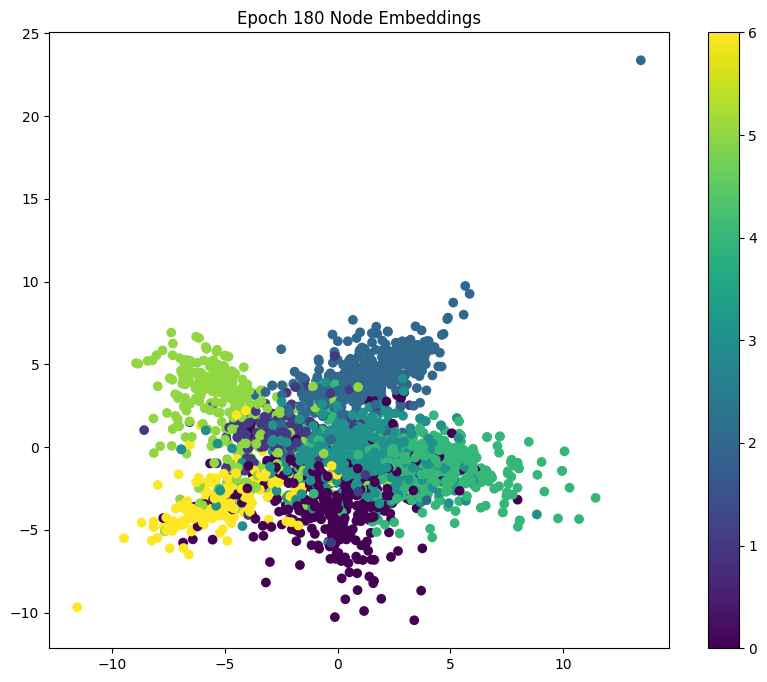

Model 3 - Epoch: 190, Loss: 0.0511, Train: 1.0000, Val: 0.7980, Test: 0.8160, Precision: 0.8230, Recall: 0.8160, F1: 0.8167
Node Embeddings (Epoch 190):
[[ 0.6520745  -0.9546519 ]
 [ 7.913203   -2.7193706 ]
 [ 6.2930045  -2.3520834 ]
 ...
 [-5.330582   -2.4280899 ]
 [ 2.0406313   0.29195803]
 [ 1.6635675   0.48628825]]


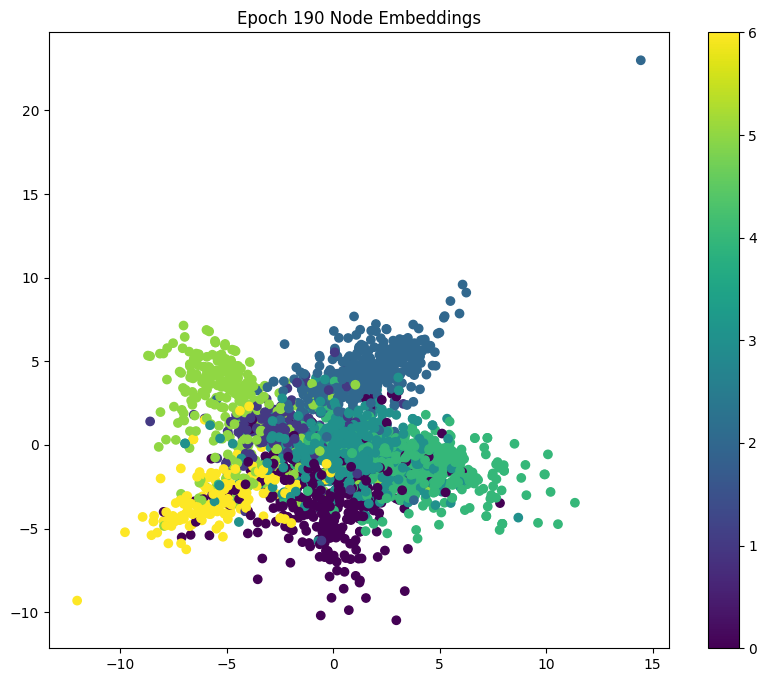

Model 3 - Epoch: 200, Loss: 0.0492, Train: 1.0000, Val: 0.8000, Test: 0.8150, Precision: 0.8218, Recall: 0.8150, F1: 0.8157
Node Embeddings (Epoch 200):
[[ 0.6047125  -1.0008875 ]
 [ 7.8383093  -2.9598281 ]
 [ 6.206261   -2.556643  ]
 ...
 [-5.4266443  -2.2342012 ]
 [ 2.048372    0.20835176]
 [ 1.6794455   0.4164816 ]]


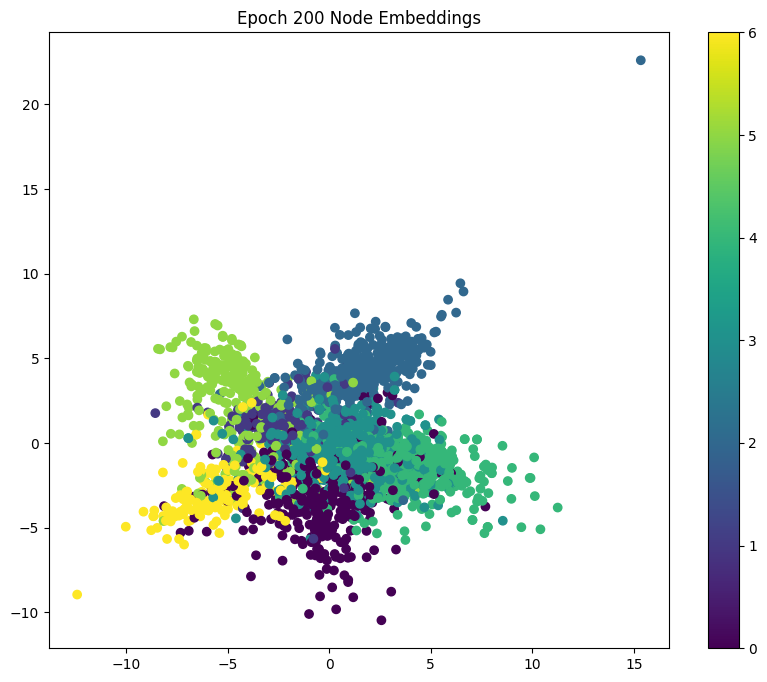

In [ ]:
writer3 = SummaryWriter('runs/model3')

epochs3 = []
train_losses3 = []
train_accuracies3 = []
val_accuracies3 = []
test_accuracies3 = []
precisions3 = []
recalls3 = []
f1_scores3 = []

for epoch in range(1, num_epochs + 1):
    loss3 = train(data, data.train_mask, model3, optimizer3, criterion3)
    train_acc3 = test(data, data.train_mask, model3)
    val_acc3 = test(data, data.val_mask, model3)
    test_acc3 = test(data, data.test_mask, model3)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model3(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs3.append(epoch)
        train_losses3.append(loss3.detach().item() if isinstance(loss3, torch.Tensor) else loss3)
        train_accuracies3.append(train_acc3.detach().item() if isinstance(train_acc3, torch.Tensor) else train_acc3)
        val_accuracies3.append(val_acc3.detach().item() if isinstance(val_acc3, torch.Tensor) else val_acc3)
        test_accuracies3.append(test_acc3.detach().item() if isinstance(test_acc3, torch.Tensor) else test_acc3)
        precisions3.append(precision)
        recalls3.append(recall)
        f1_scores3.append(f1)

        print(f'Model 3 - Epoch: {epoch:03d}, Loss: {loss3:.4f}, Train: {train_acc3:.4f}, Val: {val_acc3:.4f}, Test: {test_acc3:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        node_embeddings = model3(data.x, data.edge_index)

        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())


        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # visualizing the node embeddings using matplotlib
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer3.add_scalar('Loss/Train', loss3, epoch)
    writer3.add_scalar('Accuracy/Train', train_acc3, epoch)
    writer3.add_scalar('Accuracy/Validation', val_acc3, epoch)
    writer3.add_scalar('Accuracy/Test', test_acc3, epoch)
    writer3.add_scalar('Precision/Test', precision, epoch)
    writer3.add_scalar('Recall/Test', recall, epoch)
    writer3.add_scalar('F1-Score/Test', f1, epoch)

writer3.close()

# Learning Curve for Third Model | Mostapha Abdelaziz

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs3, y=train_losses3, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs3, y=train_accuracies3, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs3, y=val_accuracies3, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs3, y=test_accuracies3, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Third Model | Mostapha Abdelaziz',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# **Tensor Board For GCN Model with its Hyperparametars**

In [ ]:
%load_ext tensorboard
!tensorboard --logdir=runs --port=6006

2024-12-01 11:20:16.256660: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-01 11:20:16.283683: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-01 11:20:16.291110: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-01 11:20:17.934688: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to 

# Run to preview on colab in case URL is not working on colab

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

# Run in case you want to stop the currently running TensorBoard instance

In [ ]:
!kill 24684

/bin/bash: line 1: kill: (24684) - No such process




---



# **GCN Models Performance Analysis**

## 1. Model Architectures and Hyperparameters
- **Model 1**: 2 layers, ReLU activation, Learning Rate = 0.01
- **Model 2**: 3 layers, Tanh activation, Learning Rate = 0.005
- **Model 3**: 2 layers, Sigmoid activation, Learning Rate = 0.01

---

## 2. Training and Validation Metrics
### **Model 1**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.2747     | 59.29%         | 46.0%               | 46.4%         |
| 20    | 0.5749     | 94.29%         | 69.8%               | 69.6%         |
| 30    | 0.1912     | 98.57%         | 72.6%               | 73.4%         |
| 70    | 0.0056     | 100%           | 74.2%               | 74.6%         |
| 190   | 0.0009     | 100%           | 73.6%               | 74.7%         |

### **Model 2**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.1414     | 90.00%         | 71.8%               | 71.9%         |
| 20    | 0.5969     | 97.14%         | 75.8%               | 73.9%         |
| 30    | 0.3126     | 100%           | 75.0%               | 75.5%         |
| 70    | 0.0520     | 100%           | 73.0%               | 74.2%         |
| 190   | 0.0107     | 100%           | 70.8%               | 71.9%         |

### **Model 3**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.8342     | 35.71%         | 38.6%               | 39.1%         |
| 20    | 1.5279     | 84.29%         | 50.2%               | 51.7%         |
| 30    | 1.0848     | 92.14%         | 70.8%               | 72.1%         |
| 70    | 0.1966     | 100%           | 78.8%               | 81.5%         |
| 190   | 0.0511     | 100%           | 79.8%               | 81.6%         |

---

## 3. Learning Curves

### Model 1
- **Train Loss Over Epochs**:
  - The train loss started at **1.2747** and decreased steadily, reaching **0.0009** by epoch 190.
  - The most significant reduction occurred in the first 40 epochs, stabilizing near-zero values after epoch 150.
- **Accuracy Curves**:
  - Train accuracy began at **59.29%** and quickly improved to **100%** by epoch 40.
  - Validation accuracy showed gradual improvement, starting at **46.0%**, peaking at **74.2%**, and stabilizing around that range.
  - Test accuracy also improved from **46.4%** to a maximum of **74.7%**, with stable performance above **74%** after epoch 160.

### Model 2
- **Train Loss Over Epochs**:
  - Train loss began at **1.1414** and decreased steadily to **0.0107** by epoch 190.
  - The decline was more gradual than Model 1, with a noticeable plateau around epoch 120.
- **Accuracy Curves**:
  - Train accuracy started at **90.00%**, reaching **100%** by epoch 30.
  - Validation accuracy peaked early at **75.8%** but showed a slight decline to **70.8%** over time, suggesting potential overfitting.
  - Test accuracy peaked at **73.9%** by epoch 20 and gradually decreased to **71.9%** by epoch 190.

### Model 3
- **Train Loss Over Epochs**:
  - Train loss was initially high at **1.8342** but dropped to **0.0511** by epoch 190, with steady reductions throughout the training process.
  - The loss declined more gradually compared to the other models, especially after epoch 50.
- **Accuracy Curves**:
  - Train accuracy began at **35.71%**, reaching **100%** by epoch 60.
  - Validation accuracy showed a peak of **78.8%** around epoch 70 but remained slightly inconsistent, fluctuating around **79%**.
  - Test accuracy peaked at **81.5%** near epoch 70 and stabilized at **81.6%** by the end of training, indicating strong generalization performance.

---

## 4. Observations
- **Model 3** achieved the highest **Test Accuracy** of **81.6%** and showed stable performance across epochs.
- **Model 1** showed strong convergence but slightly lower performance compared to Models 2 and 3.
- **Model 2** had initial strong performance but experienced some degradation in later epochs due to possible overfitting.
- Adding more layers (**Model 3**) initially improved performance but plateaued, highlighting diminishing returns in deeper architectures.

---

## 5. Conclusion
- **Model 3** is the best-performing model, achieving the highest **Test Accuracy** and robust generalization performance.




---



# **2. SAGE Architecture | Abdelrahman Gamal and Karim Yasser**

In [ ]:
import torch
from torch_geometric.datasets import Planetoid
from torch_geometric.data import DataLoader
from torch.nn import CrossEntropyLoss
import torch.optim as optim
from torch_geometric.nn import SAGEConv
from torch.nn import functional as F

class GraphSAGE(torch.nn.Module):
    def __init__(self, hidden_dimension, num_layers=2, activation_func="ReLU", num_features=None, num_classes=None):
        super(GraphSAGE, self).__init__()

        self.num_layers = num_layers
        self.activation_func = activation_func

        # GraphSAGE layers
        self.conv1 = SAGEConv(num_features, hidden_dimension)  # First layer (from input to hidden)
        self.convs = torch.nn.ModuleList([SAGEConv(hidden_dimension, hidden_dimension) for _ in range(num_layers - 1)])  # Additional hidden layers
        self.conv_last = SAGEConv(hidden_dimension, num_classes)  # Last layer (from hidden to output)

    def forward(self, x, edge_index):
        # First layer
        x = self.conv1(x, edge_index)
        x = self.applyActivation(x)

        # Hidden layers
        for conv in self.convs:
            x = conv(x, edge_index)
            x = self.applyActivation(x)

        # Last layer (output layer)
        x = self.conv_last(x, edge_index)
        return x

    def applyActivation(self, x):
        if self.activation_func == "ReLU":
            return F.relu(x)
        elif self.activation_func == "Sigmoid":
            return torch.sigmoid(x)
        elif self.activation_func == "Tanh":
            return torch.tanh(x)
        else:
            raise ValueError("Unsupported activation function !!")


# Train and test

In [ ]:
def train(data, mask, model, optimizer, criterion):
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = criterion(out[mask], data.y[mask])
    loss.backward()
    optimizer.step()
    return loss

def test(data, mask, model):
    model.eval()
    out = model(data.x, data.edge_index)
    predictedC = out.argmax(dim=1)
    correct = predictedC[mask] == data.y[mask]
    acc = int(correct.sum()) / int(mask.sum())
    return acc


# Models building

In [ ]:
# 'First' Base model - Abdelrahman Gamal and Karim Yasser
model4 = GraphSAGE(hidden_dimension=8, num_layers=2, activation_func="ReLU", num_features=num_features, num_classes=num_classes)
optimizer4 = torch.optim.Adam(model4.parameters(), lr=0.01)
criterion4 = torch.nn.CrossEntropyLoss()

# 'Second' model after tuning - Abdelrahman Gamal
model5 = GraphSAGE(hidden_dimension=16, num_layers=3, activation_func="Tanh", num_features=num_features, num_classes=num_classes)
optimizer5 = torch.optim.Adam(model5.parameters(), lr=0.005, weight_decay=0)
criterion5 = torch.nn.CrossEntropyLoss()

# 'Third' model after tuning - Karim Yasser
model6 = GraphSAGE(hidden_dimension=32, num_layers=2, activation_func="Sigmoid", num_features=num_features, num_classes=num_classes)
optimizer6 = torch.optim.Adam(model6.parameters(), lr=0.01, weight_decay=5e-4)
criterion6 = torch.nn.CrossEntropyLoss()

# Base Model (model4) embeddings | SAGE

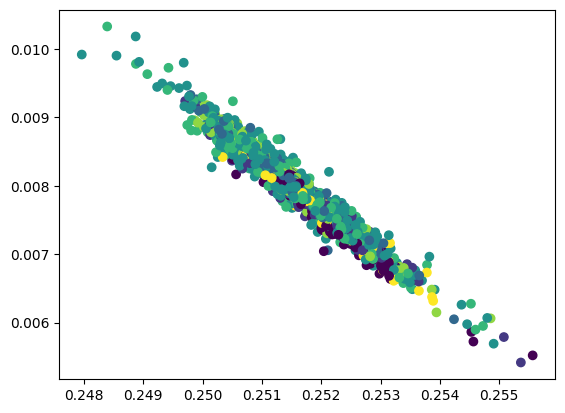

In [ ]:
embeddings = model4(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 5 embeddings | Karim Yasser

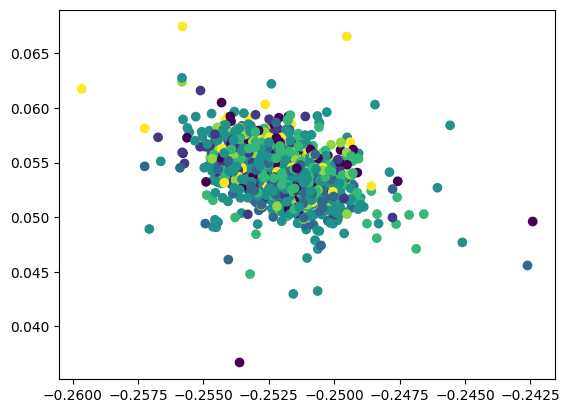

In [ ]:
embeddings = model5(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Model 6 embeddings | Abdelrahman Gamal

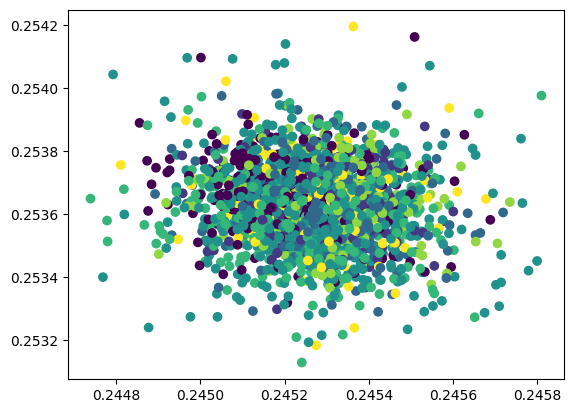

In [ ]:
embeddings = model6(data[0].x, data[0].edge_index)
visualize_E(embeddings, data[0].y)

# Train and test 'Base model'

Model 4 - Epoch: 010, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6244, Recall: 0.5280, F1: 0.5455
Node Embeddings (Epoch 10):
[[-15.716657    7.9013867]
 [  6.922471   13.614932 ]
 [  3.7277162  13.243237 ]
 ...
 [  4.401635    4.432466 ]
 [ -9.650286    6.0442333]
 [-10.880709    9.103771 ]]


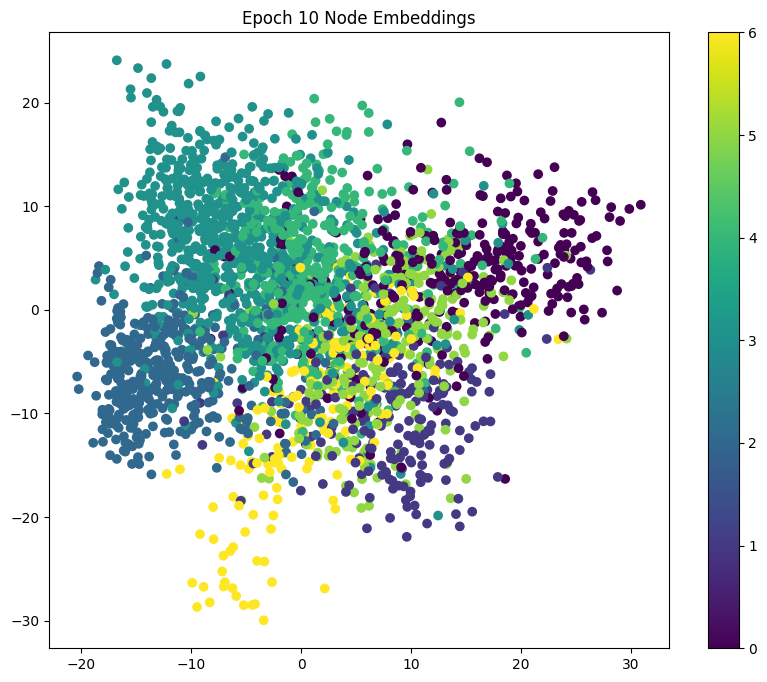

Model 4 - Epoch: 020, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6239, Recall: 0.5290, F1: 0.5461
Node Embeddings (Epoch 20):
[[-15.712122    7.9362965]
 [  6.939213   13.618894 ]
 [  3.749685   13.26412  ]
 ...
 [  4.417938    4.423664 ]
 [ -9.648614    6.0719604]
 [-10.87194     9.140889 ]]


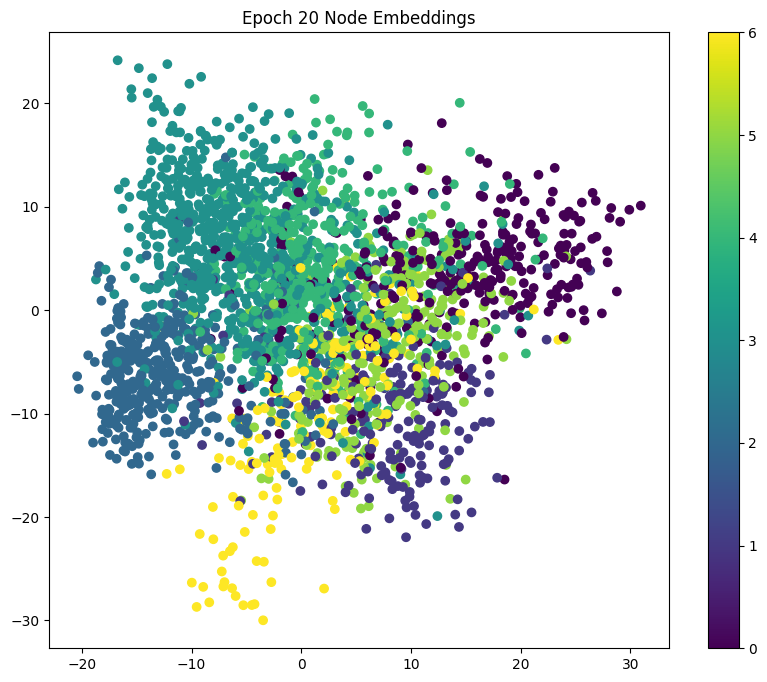

Model 4 - Epoch: 030, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6224, Recall: 0.5280, F1: 0.5450
Node Embeddings (Epoch 30):
[[-15.708019    7.969949 ]
 [  6.955071   13.622941 ]
 [  3.7705855  13.284803 ]
 ...
 [  4.4337716   4.4153194]
 [ -9.647368    6.0987105]
 [-10.863876    9.176683 ]]


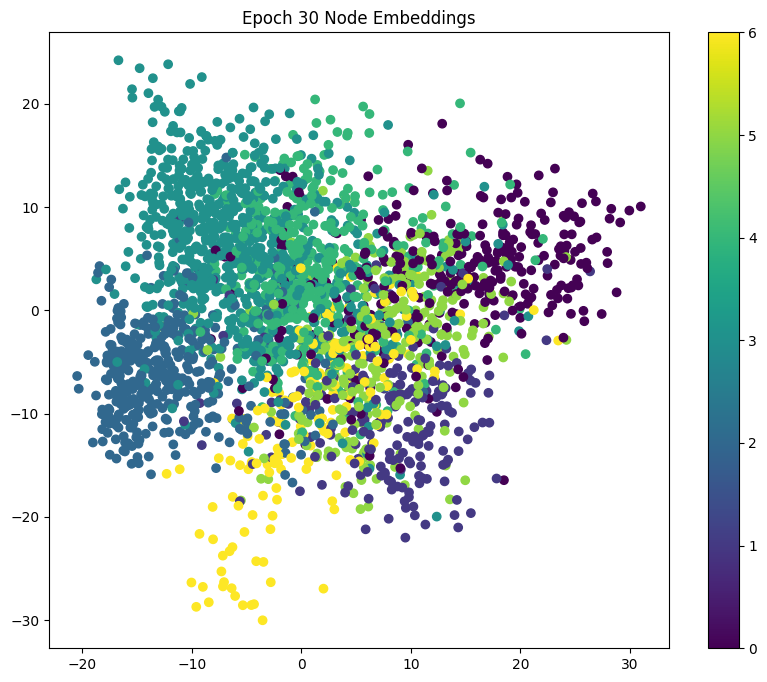

Model 4 - Epoch: 040, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5280, Precision: 0.6224, Recall: 0.5280, F1: 0.5450
Node Embeddings (Epoch 40):
[[-15.704016    8.0028925]
 [  6.9705043  13.626845 ]
 [  3.7909412  13.305084 ]
 ...
 [  4.4493775   4.407181 ]
 [ -9.646278    6.124854 ]
 [-10.856152    9.211559 ]]


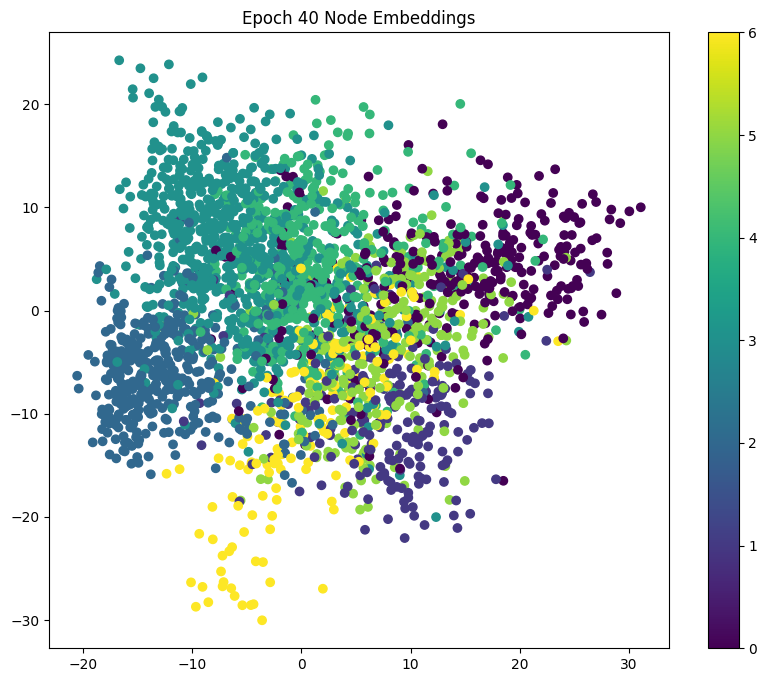

Model 4 - Epoch: 050, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 50):
[[-15.700057    8.0353775]
 [  6.985339   13.630018 ]
 [  3.8107495  13.324734 ]
 ...
 [  4.4647455   4.3993545]
 [ -9.645275    6.150543 ]
 [-10.848682    9.245734 ]]


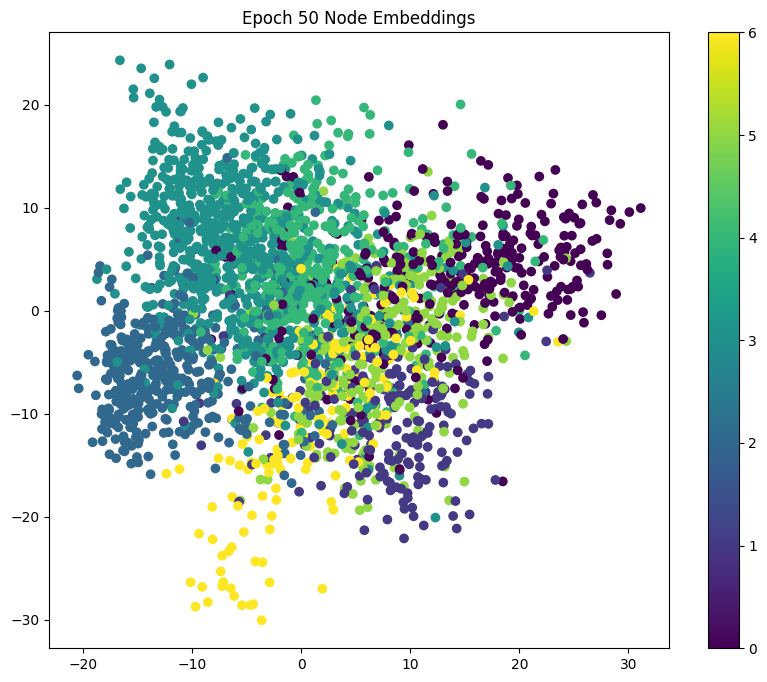

Model 4 - Epoch: 060, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 60):
[[-15.696524    8.066681 ]
 [  6.999775   13.631863 ]
 [  3.8298218  13.343334 ]
 ...
 [  4.479748    4.3921423]
 [ -9.6446295   6.1753454]
 [-10.841821    9.27866  ]]


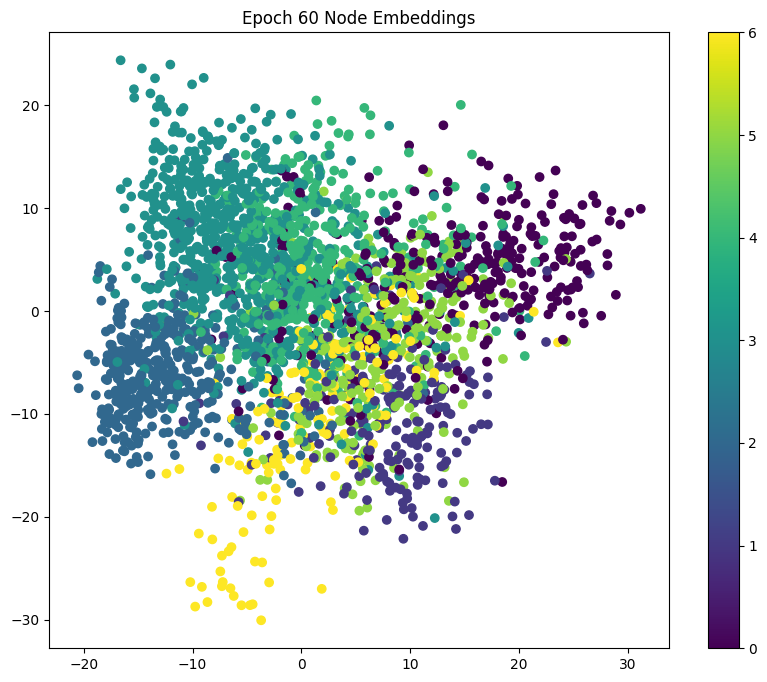

Model 4 - Epoch: 070, Loss: 0.0000, Train: 1.0000, Val: 0.5120, Test: 0.5290, Precision: 0.6230, Recall: 0.5290, F1: 0.5458
Node Embeddings (Epoch 70):
[[-15.693075    8.097458 ]
 [  7.0137944  13.632884 ]
 [  3.8485694  13.361188 ]
 ...
 [  4.494579    4.385187 ]
 [ -9.643978    6.199781 ]
 [-10.835068    9.311059 ]]


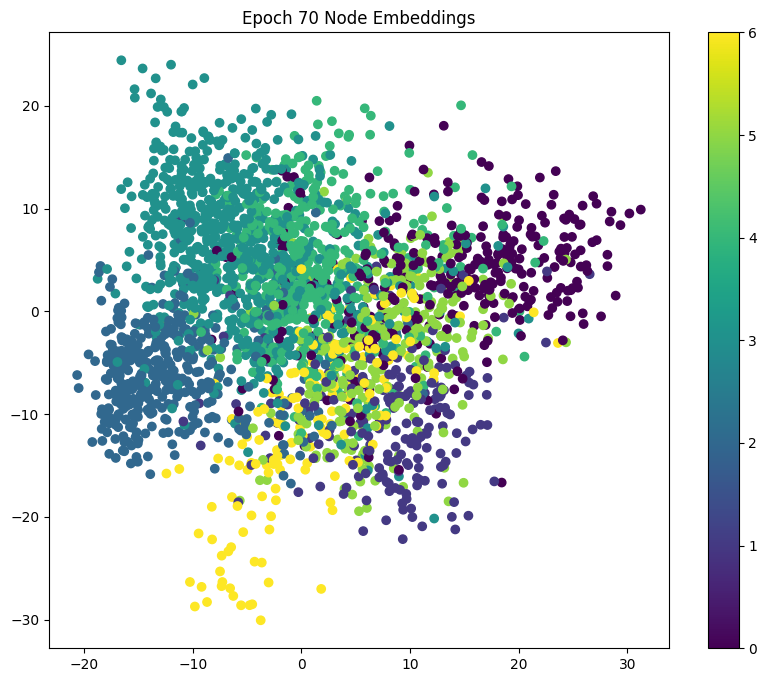

Model 4 - Epoch: 080, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 80):
[[-15.689608    8.127937 ]
 [  7.027849   13.633738 ]
 [  3.867162   13.378618 ]
 ...
 [  4.5091963   4.3782673]
 [ -9.6433      6.223904 ]
 [-10.82839     9.342974 ]]


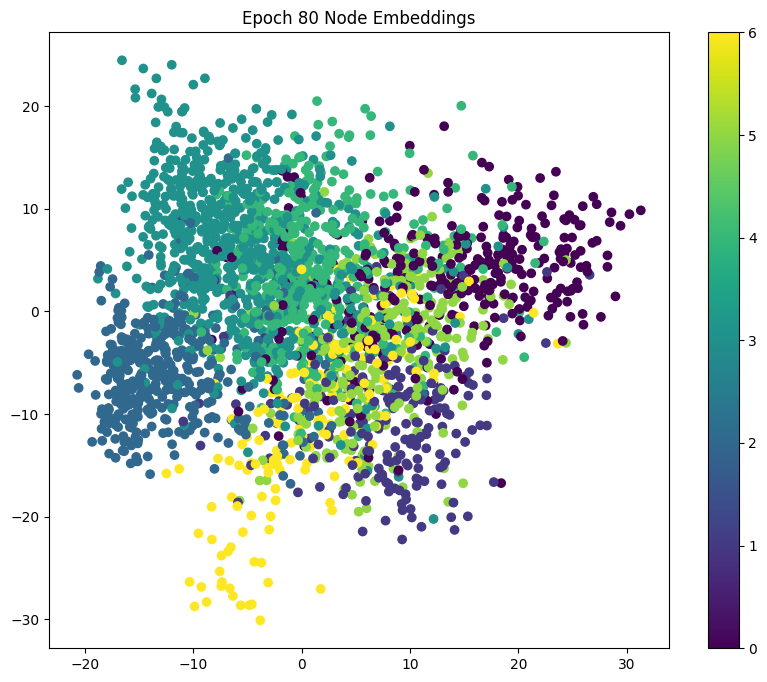

Model 4 - Epoch: 090, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 90):
[[-15.686128    8.158161 ]
 [  7.041872   13.634369 ]
 [  3.885606   13.395672 ]
 ...
 [  4.5236483   4.3713255]
 [ -9.642595    6.2476993]
 [-10.821758    9.374413 ]]


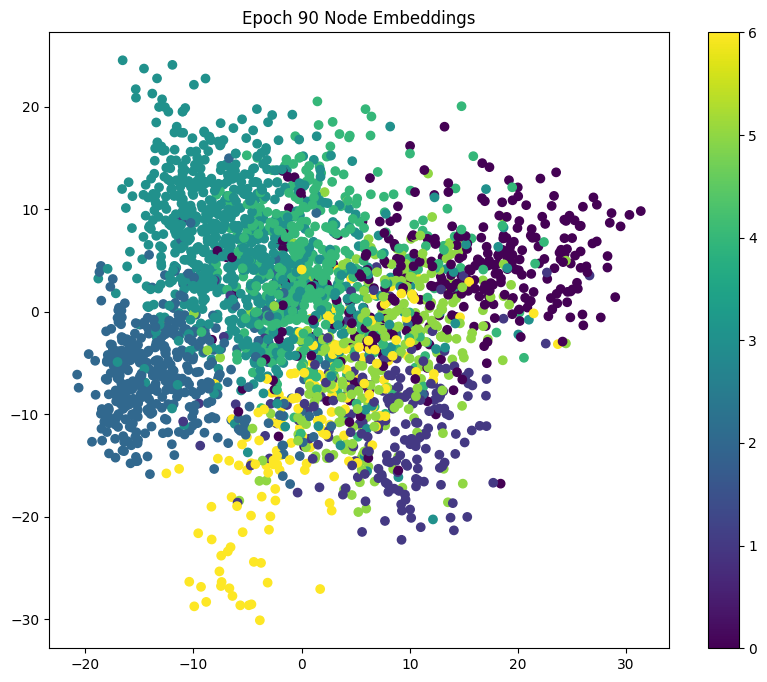

Model 4 - Epoch: 100, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6234, Recall: 0.5300, F1: 0.5468
Node Embeddings (Epoch 100):
[[-15.682495    8.18809  ]
 [  7.0564585  13.634829 ]
 [  3.9041152  13.412511 ]
 ...
 [  4.537972    4.3642726]
 [ -9.641795    6.2711077]
 [-10.815062    9.405388 ]]


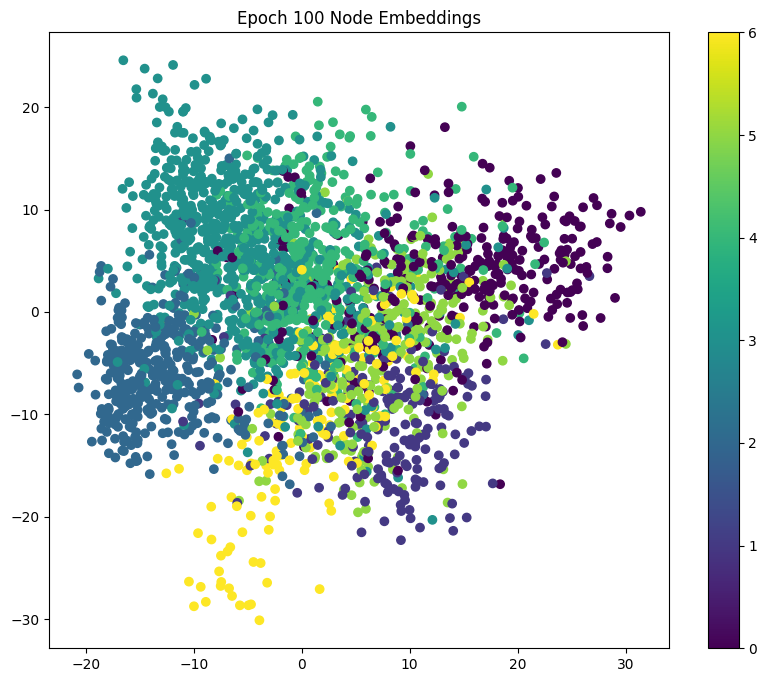

Model 4 - Epoch: 110, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 110):
[[-15.678757    8.217669 ]
 [  7.071222   13.635045 ]
 [  3.922449   13.429182 ]
 ...
 [  4.552159    4.356963 ]
 [ -9.640963    6.2940173]
 [-10.808424    9.435664 ]]


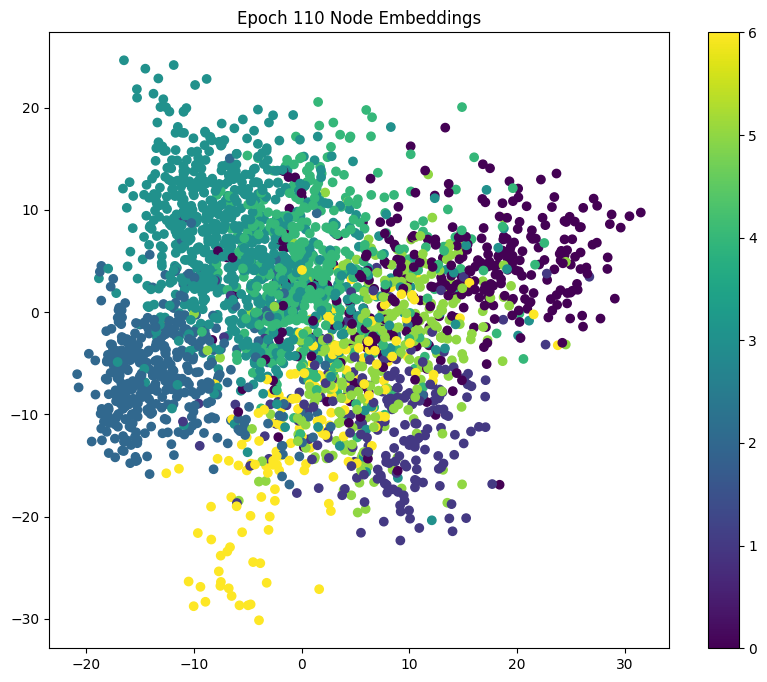

Model 4 - Epoch: 120, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 120):
[[-15.675091    8.246592 ]
 [  7.085677   13.635246 ]
 [  3.940264   13.445688 ]
 ...
 [  4.5661077   4.3494787]
 [ -9.640263    6.316247 ]
 [-10.8021      9.465018 ]]


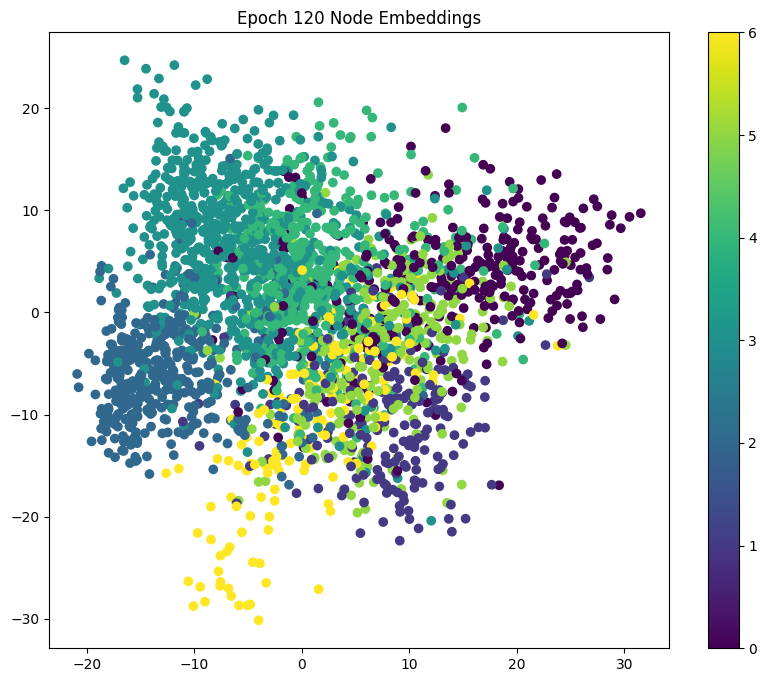

Model 4 - Epoch: 130, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5310, Precision: 0.6241, Recall: 0.5310, F1: 0.5476
Node Embeddings (Epoch 130):
[[-15.671612    8.274214 ]
 [  7.099737   13.635189 ]
 [  3.9571528  13.461673 ]
 ...
 [  4.579706    4.3416243]
 [ -9.639832    6.3371587]
 [-10.796286    9.492779 ]]


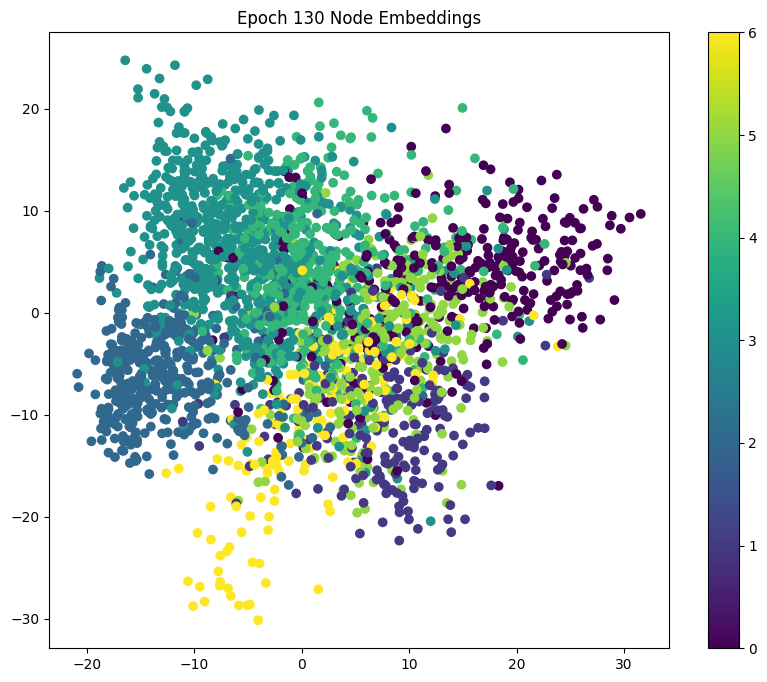

Model 4 - Epoch: 140, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6235, Recall: 0.5300, F1: 0.5470
Node Embeddings (Epoch 140):
[[-15.668528    8.30022  ]
 [  7.113083   13.635056 ]
 [  3.9727862  13.477165 ]
 ...
 [  4.5927277   4.333454 ]
 [ -9.639934    6.356519 ]
 [-10.791301    9.51865  ]]


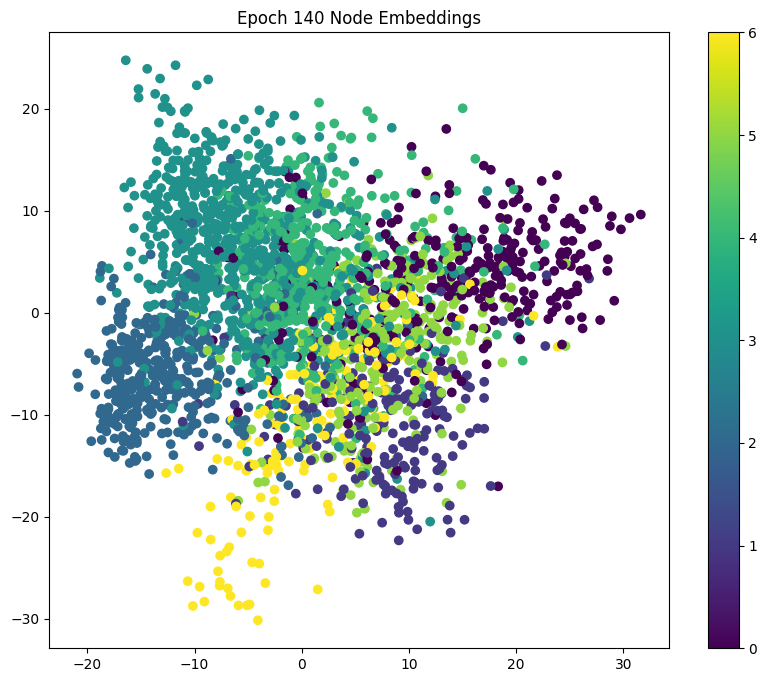

Model 4 - Epoch: 150, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6235, Recall: 0.5300, F1: 0.5470
Node Embeddings (Epoch 150):
[[-15.665651    8.324697 ]
 [  7.12598    13.634468 ]
 [  3.9875813  13.49179  ]
 ...
 [  4.6051536   4.3245792]
 [ -9.640373    6.374202 ]
 [-10.786842    9.542502 ]]


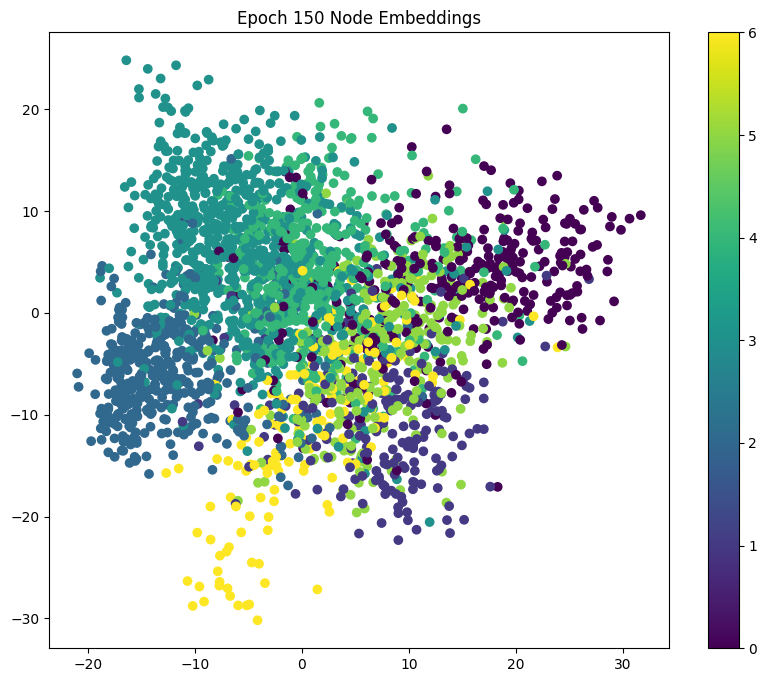

Model 4 - Epoch: 160, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6231, Recall: 0.5300, F1: 0.5469
Node Embeddings (Epoch 160):
[[-15.663374    8.347174 ]
 [  7.137801   13.633265 ]
 [  4.000952   13.505545 ]
 ...
 [  4.616871    4.31498  ]
 [ -9.641573    6.3903093]
 [-10.783584    9.564456 ]]


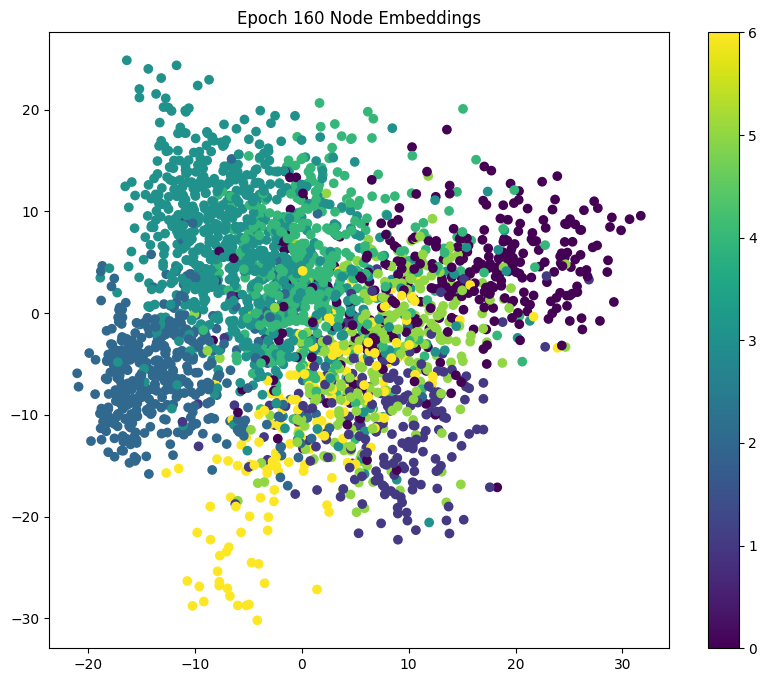

Model 4 - Epoch: 170, Loss: 0.0000, Train: 1.0000, Val: 0.5140, Test: 0.5300, Precision: 0.6231, Recall: 0.5300, F1: 0.5469
Node Embeddings (Epoch 170):
[[-15.66147     8.36812  ]
 [  7.1491594  13.630744 ]
 [  4.0136585  13.517946 ]
 ...
 [  4.627964    4.3040996]
 [ -9.643148    6.4051013]
 [-10.780932    9.584865 ]]


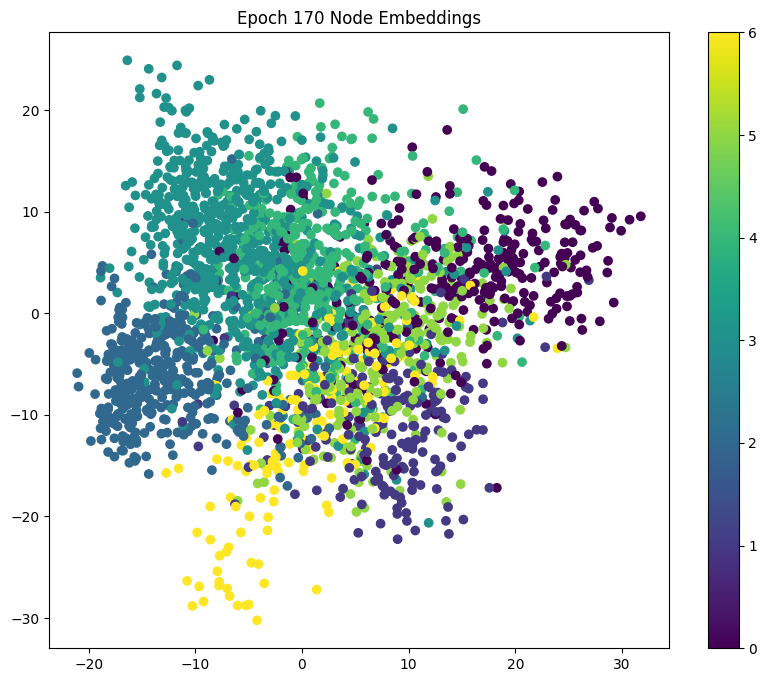

Model 4 - Epoch: 180, Loss: 0.0000, Train: 1.0000, Val: 0.5160, Test: 0.5310, Precision: 0.6236, Recall: 0.5310, F1: 0.5479
Node Embeddings (Epoch 180):
[[-15.658962    8.388754 ]
 [  7.162096   13.625465 ]
 [  4.0279503  13.528013 ]
 ...
 [  4.6346188   4.2995777]
 [ -9.643822    6.4189634]
 [-10.77695     9.604282 ]]


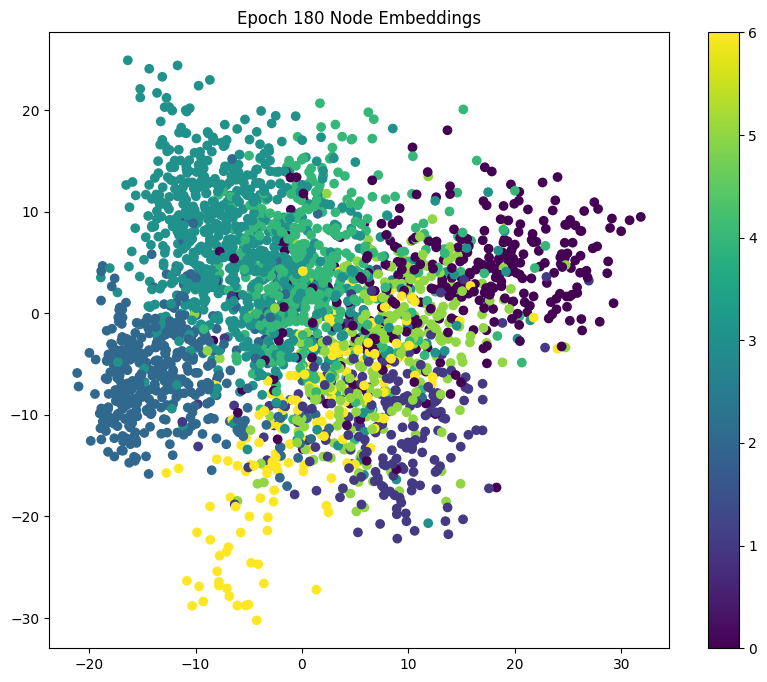

Model 4 - Epoch: 190, Loss: 0.0000, Train: 1.0000, Val: 0.5160, Test: 0.5330, Precision: 0.6251, Recall: 0.5330, F1: 0.5491
Node Embeddings (Epoch 190):
[[-15.654652    8.410479 ]
 [  7.178988   13.615117 ]
 [  4.045965   13.535344 ]
 ...
 [  4.6373353   4.299822 ]
 [ -9.640898    6.4395604]
 [-10.769526    9.624512 ]]


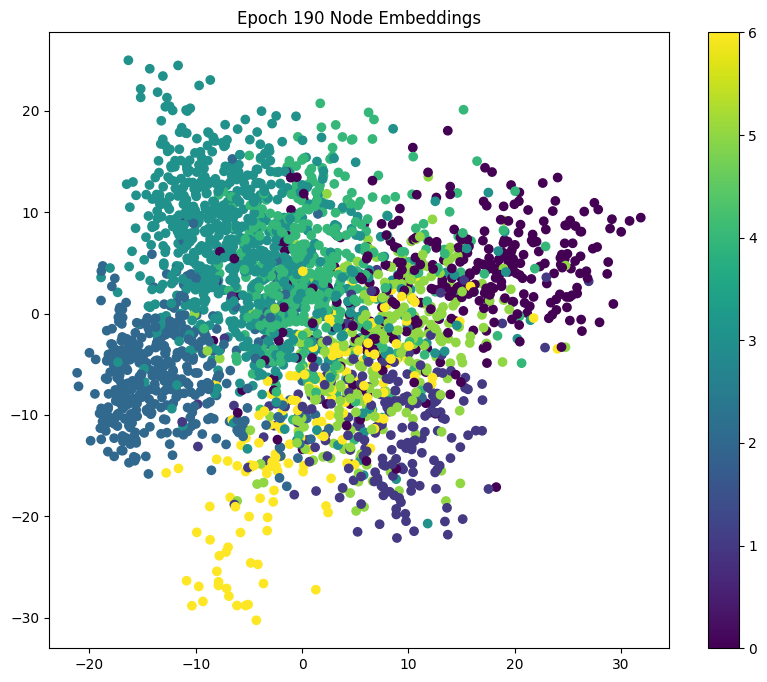

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Fourth' model - Base model with 8 hidden units and ReLU activation
writer4 = SummaryWriter('runs/model4')

epochs4 = []
train_losses4 = []
train_accuracies4 = []
val_accuracies4 = []
test_accuracies4 = []
precisions4 = []
recalls4 = []
f1_scores4 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss4 = train(data, data.train_mask, model4, optimizer4, criterion4)
    train_acc4 = test(data, data.train_mask, model4)
    val_acc4 = test(data, data.val_mask, model4)
    test_acc4 = test(data, data.test_mask, model4)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model4(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs4.append(epoch)
        train_losses4.append(loss4.detach().item())
        train_accuracies4.append(train_acc4)
        val_accuracies4.append(val_acc4)
        test_accuracies4.append(test_acc4)
        precisions4.append(precision)
        recalls4.append(recall)
        f1_scores4.append(f1)

        print(f'Model 4 - Epoch: {epoch:03d}, Loss: {loss4:.4f}, Train: {train_acc4:.4f}, Val: {val_acc4:.4f}, Test: {test_acc4:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model4(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer4.add_scalar('Loss/Train', loss4, epoch)
    writer4.add_scalar('Accuracy/Train', train_acc4, epoch)
    writer4.add_scalar('Accuracy/Validation', val_acc4, epoch)
    writer4.add_scalar('Accuracy/Test', test_acc4, epoch)
    writer4.add_scalar('Precision/Test', precision, epoch)
    writer4.add_scalar('Recall/Test', recall, epoch)
    writer4.add_scalar('F1-Score/Test', f1, epoch)

writer4.close()


# Learning Curve for Base Model

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs4, y=train_losses4, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs4, y=train_accuracies4, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs4, y=val_accuracies4, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs4, y=test_accuracies4, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Graph SAGE Base Model',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'Fifth' model after tuning - Karim Yasser

Model 5 - Epoch: 010, Loss: 0.0018, Train: 1.0000, Val: 0.6600, Test: 0.6490, Precision: 0.6432, Recall: 0.6490, F1: 0.6415
Node Embeddings (Epoch 10):
[[-4.8743067   3.010159  ]
 [-3.113881   -3.1648338 ]
 [-2.3509953  -2.3672109 ]
 ...
 [-0.89464366 -6.1692276 ]
 [-2.5163245  -1.2418182 ]
 [-2.7436602   0.9267923 ]]


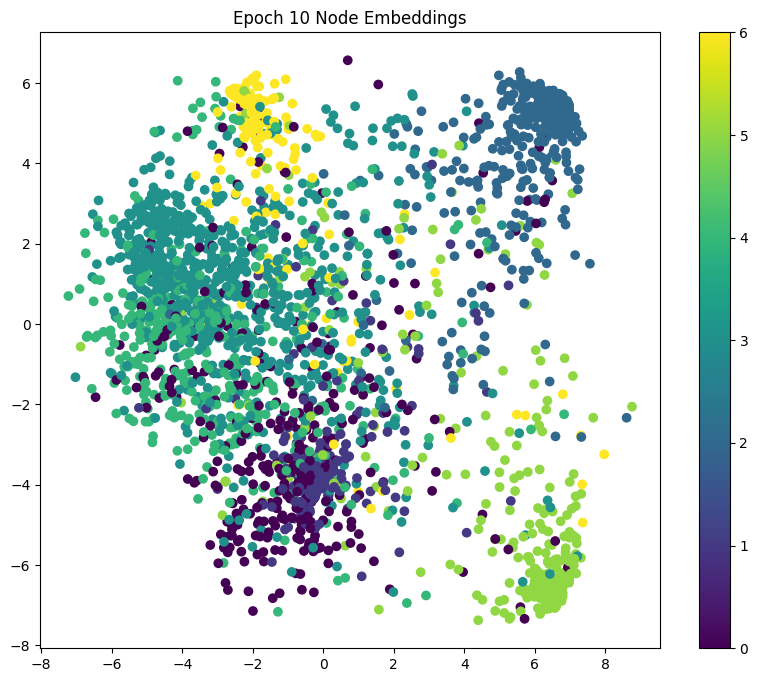

Model 5 - Epoch: 020, Loss: 0.0017, Train: 1.0000, Val: 0.6560, Test: 0.6510, Precision: 0.6455, Recall: 0.6510, F1: 0.6437
Node Embeddings (Epoch 20):
[[-4.869216    3.0558877 ]
 [-3.1795337  -3.1213093 ]
 [-2.3980787  -2.3371177 ]
 ...
 [-1.0297024  -6.179367  ]
 [-2.5775206  -1.2146271 ]
 [-2.7738516   0.94255865]]


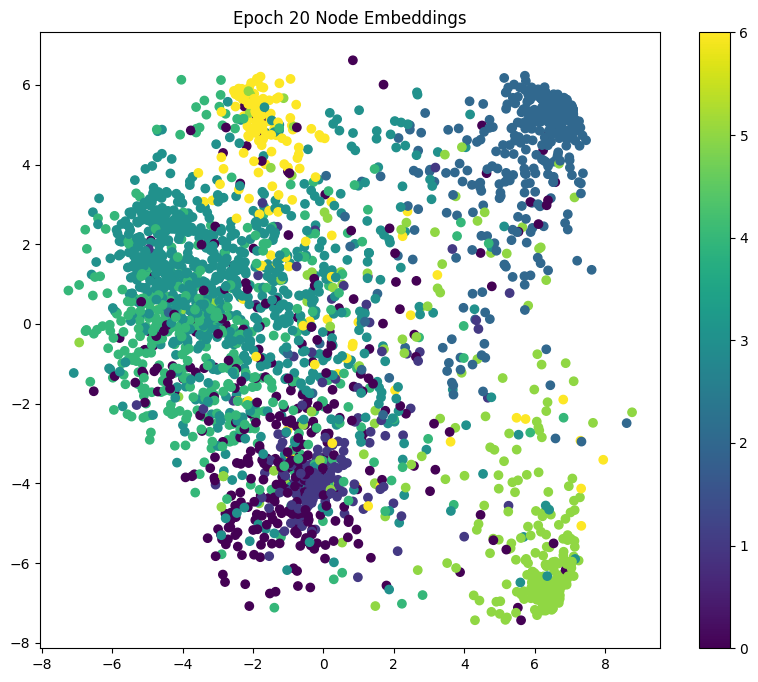

Model 5 - Epoch: 030, Loss: 0.0016, Train: 1.0000, Val: 0.6560, Test: 0.6510, Precision: 0.6452, Recall: 0.6510, F1: 0.6434
Node Embeddings (Epoch 30):
[[-4.8670764  3.0938497]
 [-3.240388  -3.0801058]
 [-2.441711  -2.3076255]
 ...
 [-1.154834  -6.1845837]
 [-2.6339145 -1.1868244]
 [-2.8030117  0.9565555]]


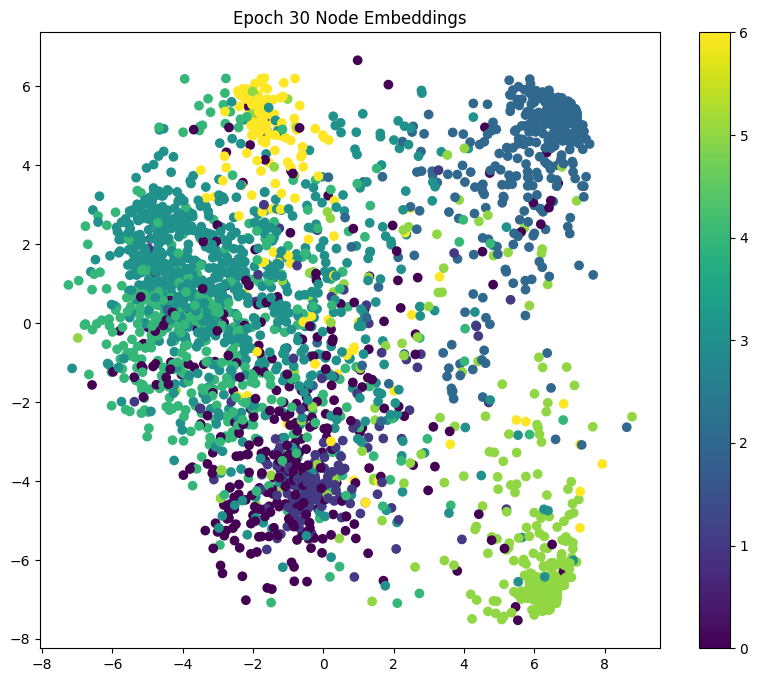

Model 5 - Epoch: 040, Loss: 0.0015, Train: 1.0000, Val: 0.6580, Test: 0.6520, Precision: 0.6459, Recall: 0.6520, F1: 0.6442
Node Embeddings (Epoch 40):
[[-4.867585   3.1254644]
 [-3.2970557 -3.0411503]
 [-2.482359  -2.2788162]
 ...
 [-1.2706271 -6.18556  ]
 [-2.6860287 -1.1585461]
 [-2.8311932  0.9691349]]


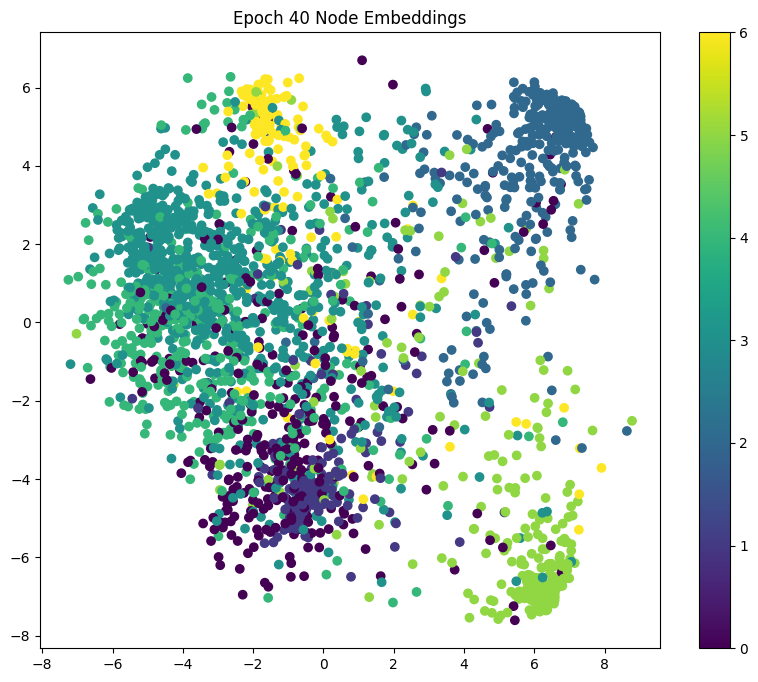

Model 5 - Epoch: 050, Loss: 0.0014, Train: 1.0000, Val: 0.6600, Test: 0.6530, Precision: 0.6468, Recall: 0.6530, F1: 0.6454
Node Embeddings (Epoch 50):
[[-4.8703547   3.1519969 ]
 [-3.350068   -3.004311  ]
 [-2.5204425  -2.2507262 ]
 ...
 [-1.3778046  -6.1829243 ]
 [-2.7343578  -1.1299067 ]
 [-2.858457    0.98060143]]


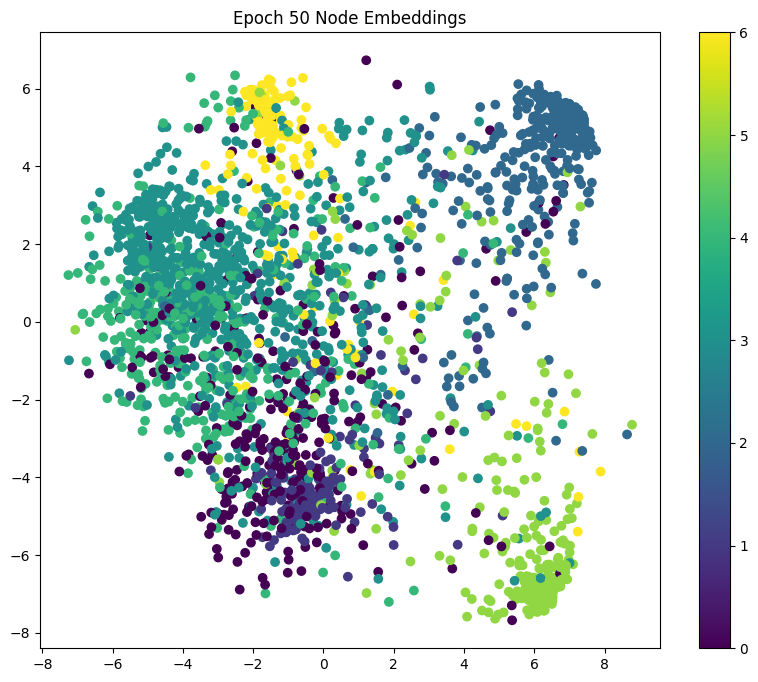

Model 5 - Epoch: 060, Loss: 0.0013, Train: 1.0000, Val: 0.6560, Test: 0.6500, Precision: 0.6426, Recall: 0.6500, F1: 0.6417
Node Embeddings (Epoch 60):
[[-4.874953    3.17457   ]
 [-3.3998823  -2.9694161 ]
 [-2.556324   -2.2233567 ]
 ...
 [-1.4771599  -6.177227  ]
 [-2.7793517  -1.1009889 ]
 [-2.8848557   0.99123096]]


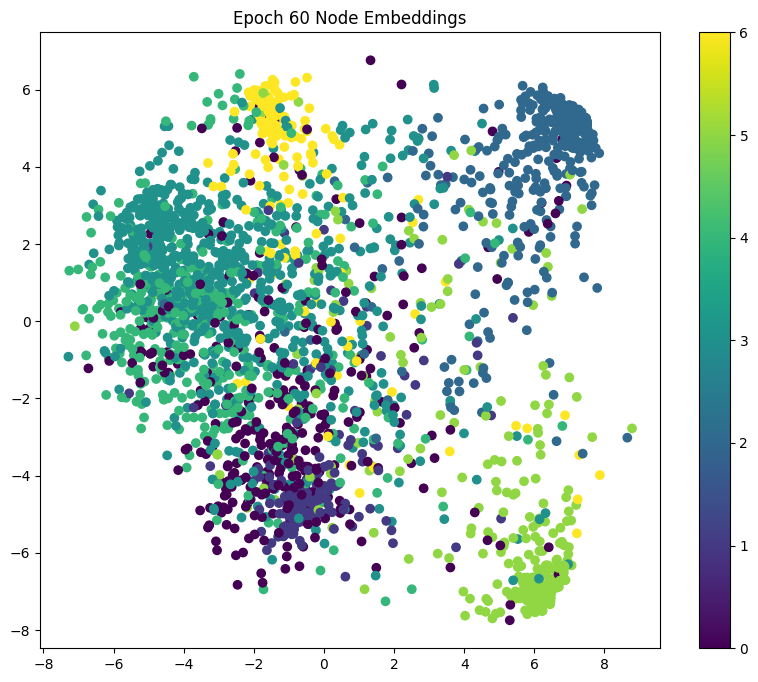

Model 5 - Epoch: 070, Loss: 0.0012, Train: 1.0000, Val: 0.6580, Test: 0.6510, Precision: 0.6430, Recall: 0.6510, F1: 0.6425
Node Embeddings (Epoch 70):
[[-4.880918   3.1941495]
 [-3.446907  -2.9362588]
 [-2.5903325 -2.1966696]
 ...
 [-1.5695336 -6.168951 ]
 [-2.821414  -1.0718496]
 [-2.9104257  1.0012687]]


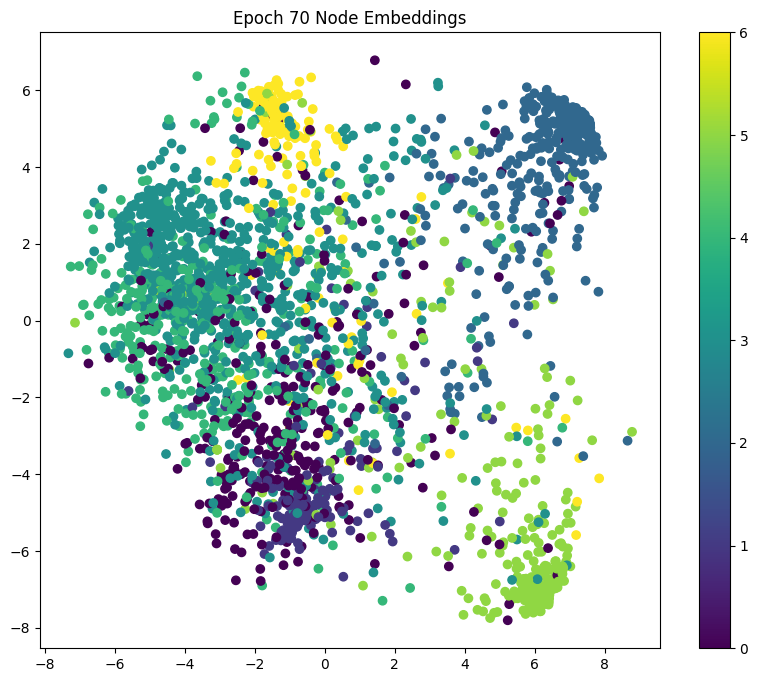

Model 5 - Epoch: 080, Loss: 0.0011, Train: 1.0000, Val: 0.6560, Test: 0.6500, Precision: 0.6415, Recall: 0.6500, F1: 0.6411
Node Embeddings (Epoch 80):
[[-4.887834   3.2115417]
 [-3.491479  -2.9046445]
 [-2.6227307 -2.1706276]
 ...
 [-1.6557155 -6.1585164]
 [-2.8608909 -1.0425313]
 [-2.9352038  1.0109303]]


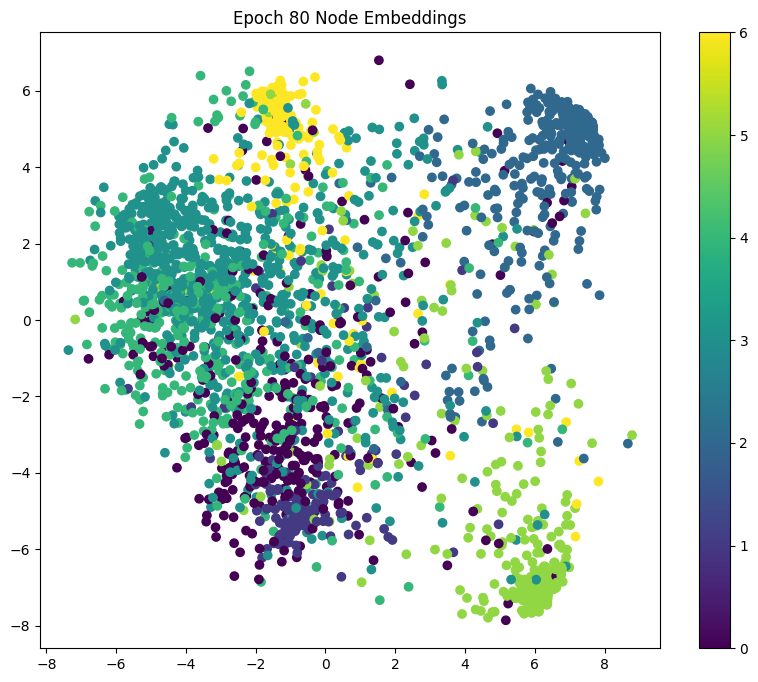

Model 5 - Epoch: 090, Loss: 0.0011, Train: 1.0000, Val: 0.6540, Test: 0.6500, Precision: 0.6415, Recall: 0.6500, F1: 0.6411
Node Embeddings (Epoch 90):
[[-4.89532    3.227398 ]
 [-3.5338874 -2.8743753]
 [-2.653741  -2.145175 ]
 ...
 [-1.7364428 -6.1462774]
 [-2.8980806 -1.013063 ]
 [-2.9592116  1.020402 ]]


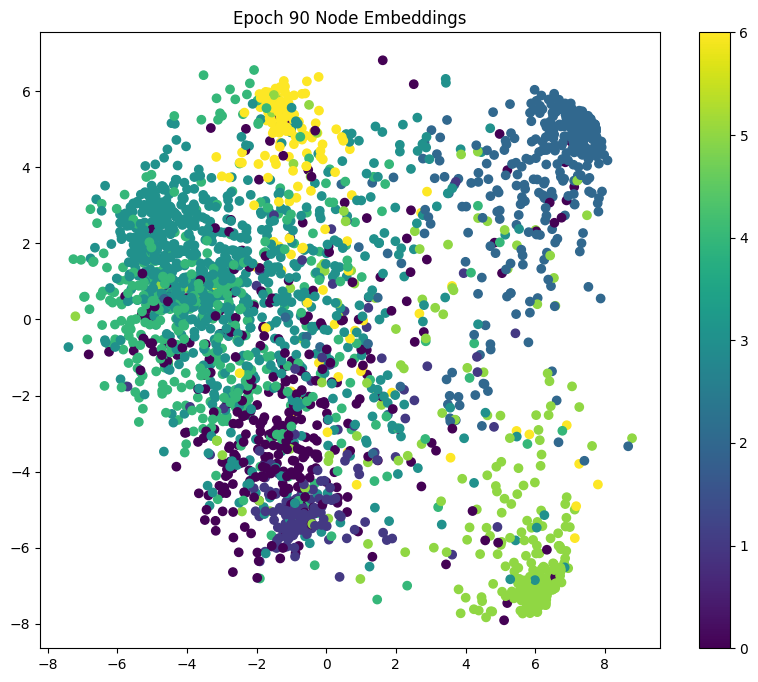

Model 5 - Epoch: 100, Loss: 0.0010, Train: 1.0000, Val: 0.6540, Test: 0.6510, Precision: 0.6423, Recall: 0.6510, F1: 0.6420
Node Embeddings (Epoch 100):
[[-4.903075   3.2422218]
 [-3.5743616 -2.8452902]
 [-2.683534  -2.1202714]
 ...
 [-1.8123531 -6.1325455]
 [-2.9332342 -0.9834734]
 [-2.982481   1.0298339]]


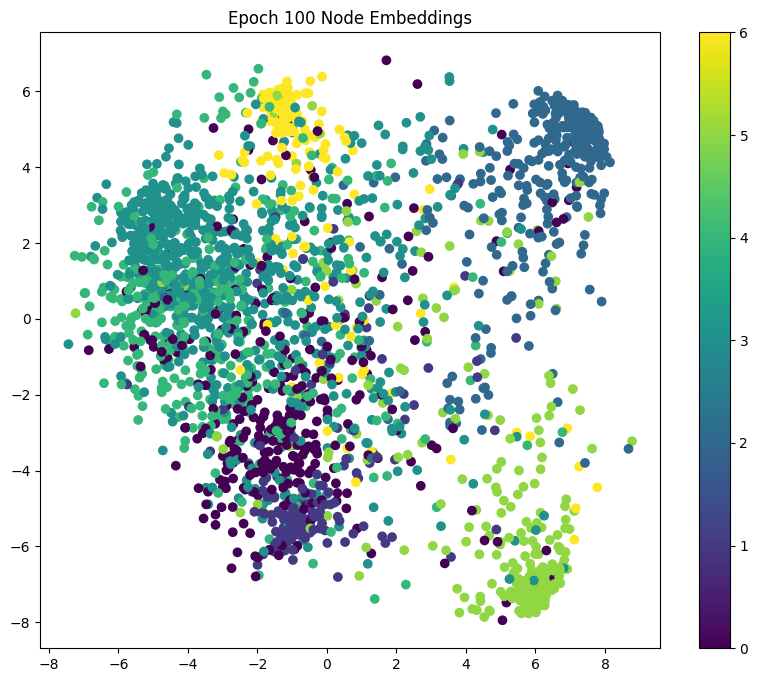

Model 5 - Epoch: 110, Loss: 0.0010, Train: 1.0000, Val: 0.6560, Test: 0.6520, Precision: 0.6431, Recall: 0.6520, F1: 0.6429
Node Embeddings (Epoch 110):
[[-4.9108562  3.2563975]
 [-3.6131005 -2.8172493]
 [-2.7122517 -2.0958788]
 ...
 [-1.8840094 -6.1175866]
 [-2.9665627 -0.9537911]
 [-3.0050325  1.0393467]]


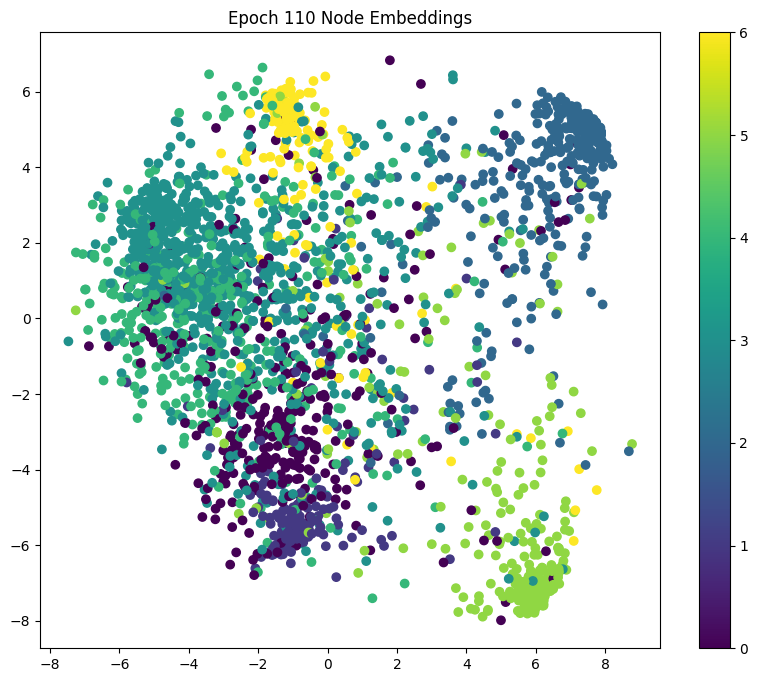

Model 5 - Epoch: 120, Loss: 0.0009, Train: 1.0000, Val: 0.6560, Test: 0.6520, Precision: 0.6431, Recall: 0.6520, F1: 0.6429
Node Embeddings (Epoch 120):
[[-4.918495   3.2701952]
 [-3.6502578 -2.7901452]
 [-2.7400005 -2.0719743]
 ...
 [-1.9518743 -6.101637 ]
 [-2.998246  -0.9240494]
 [-3.0268993  1.0490253]]


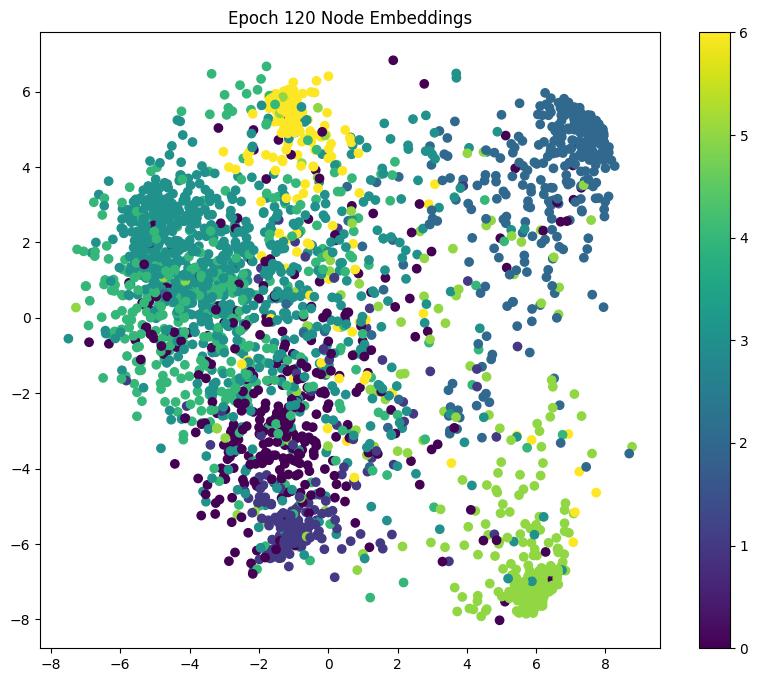

Model 5 - Epoch: 130, Loss: 0.0009, Train: 1.0000, Val: 0.6560, Test: 0.6530, Precision: 0.6440, Recall: 0.6530, F1: 0.6437
Node Embeddings (Epoch 130):
[[-4.9258785 -3.283794 ]
 [-3.6859612  2.7638986]
 [-2.7668626  2.0485451]
 ...
 [-2.016333   6.0849032]
 [-3.028432   0.8942925]
 [-3.048111  -1.0589243]]


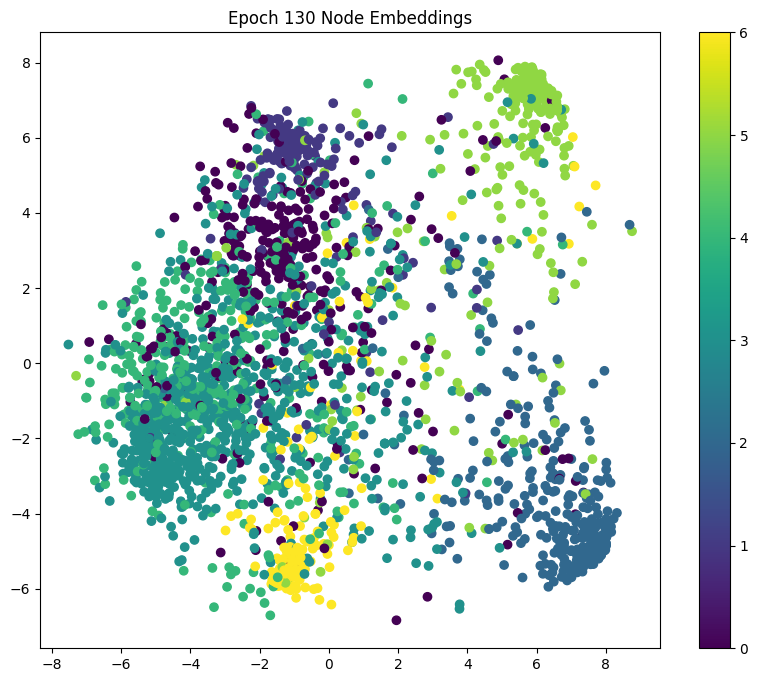

Model 5 - Epoch: 140, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6530, Precision: 0.6440, Recall: 0.6530, F1: 0.6437
Node Embeddings (Epoch 140):
[[-4.9329348 -3.2973251]
 [-3.7203207  2.7384398]
 [-2.792911   2.025579 ]
 ...
 [-2.0777192  6.0675616]
 [-3.0572543  0.8645567]
 [-3.0687003 -1.0690833]]


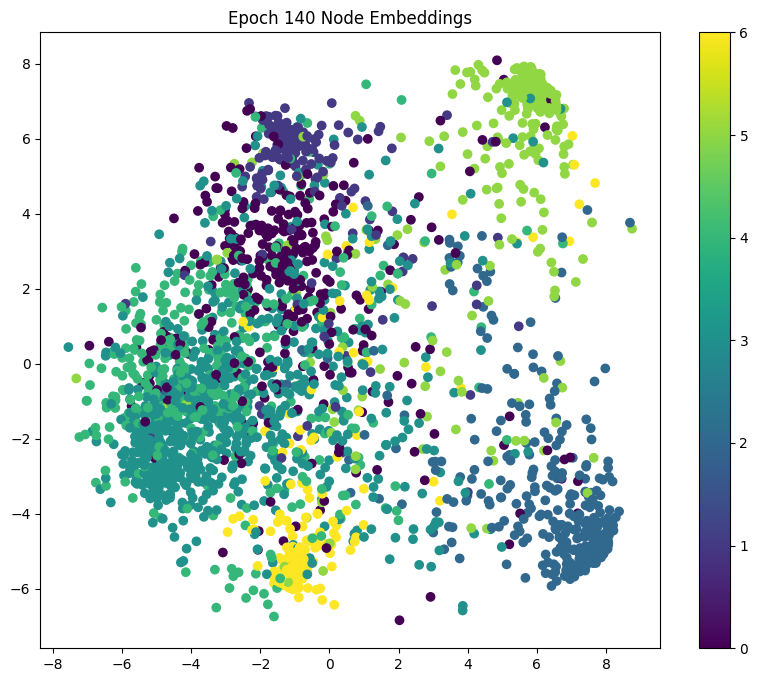

Model 5 - Epoch: 150, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6455, Recall: 0.6540, F1: 0.6449
Node Embeddings (Epoch 150):
[[-4.9396353 -3.3108578]
 [-3.753426   2.7137232]
 [-2.8181982  2.003073 ]
 ...
 [-2.136301   6.0497704]
 [-3.084825   0.8348894]
 [-3.0887015 -1.079516 ]]


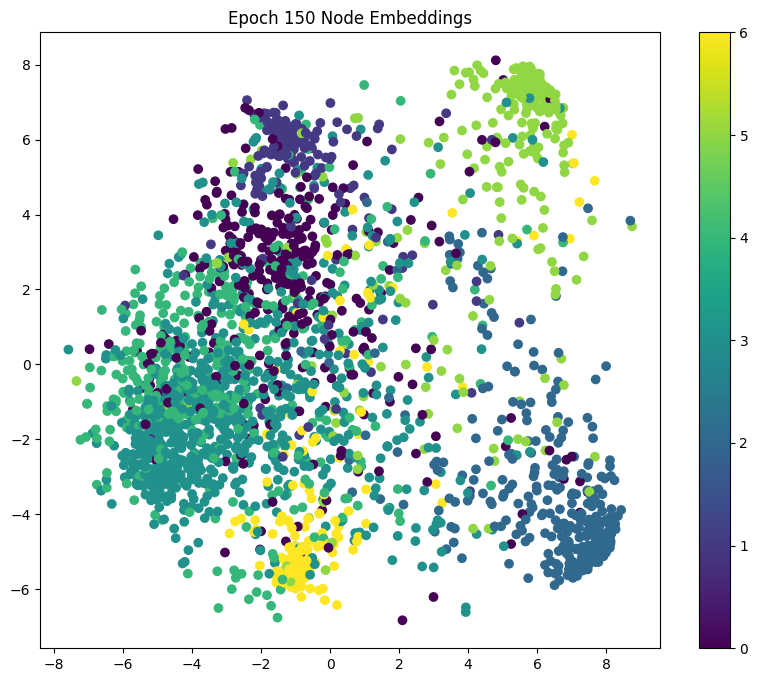

Model 5 - Epoch: 160, Loss: 0.0008, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6453, Recall: 0.6540, F1: 0.6448
Node Embeddings (Epoch 160):
[[-4.9459662 -3.3244426]
 [-3.7853575  2.6897068]
 [-2.8427706  1.9810252]
 ...
 [-2.1923194  6.031664 ]
 [-3.111246   0.8053272]
 [-3.1081467 -1.0902328]]


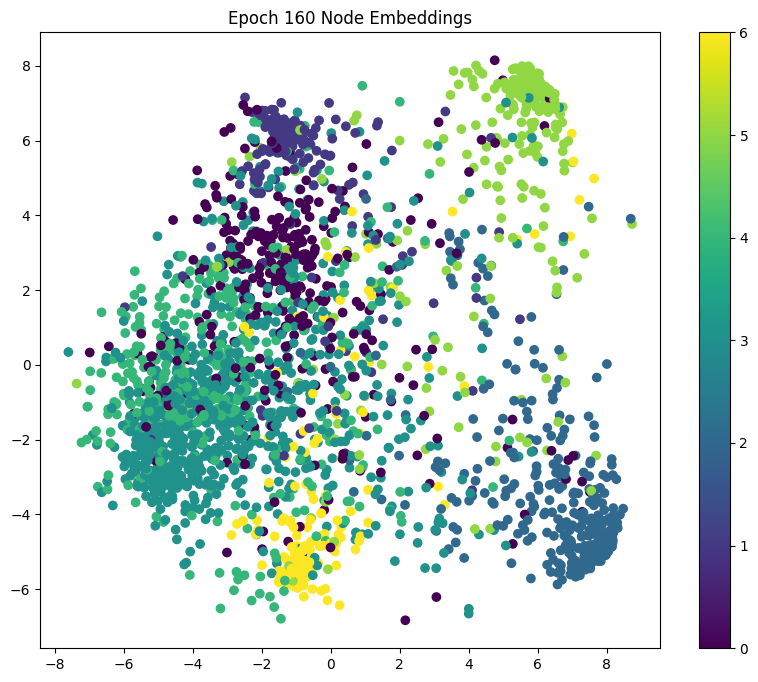

Model 5 - Epoch: 170, Loss: 0.0007, Train: 1.0000, Val: 0.6560, Test: 0.6540, Precision: 0.6451, Recall: 0.6540, F1: 0.6446
Node Embeddings (Epoch 170):
[[-4.9519424  -3.3380883 ]
 [-3.8161821   2.6663632 ]
 [-2.8666677   1.9594369 ]
 ...
 [-2.2459648   6.0133605 ]
 [-3.1366043   0.77591836]
 [-3.127068   -1.1012208 ]]


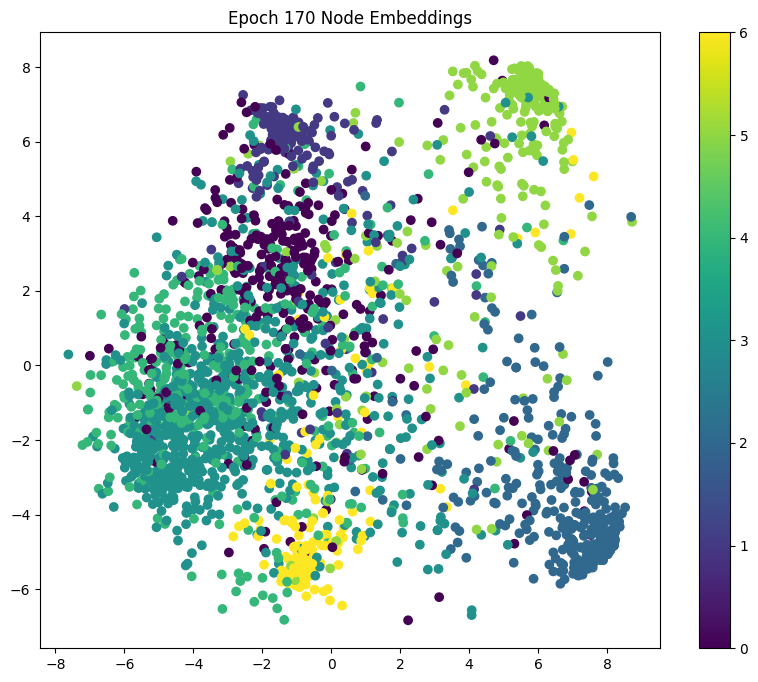

Model 5 - Epoch: 180, Loss: 0.0007, Train: 1.0000, Val: 0.6540, Test: 0.6540, Precision: 0.6451, Recall: 0.6540, F1: 0.6446
Node Embeddings (Epoch 180):
[[-4.957582  -3.3518064]
 [-3.845962   2.6436687]
 [-2.8899238  1.938309 ]
 ...
 [-2.2974138  5.9949627]
 [-3.160979   0.7466963]
 [-3.1454968 -1.112473 ]]


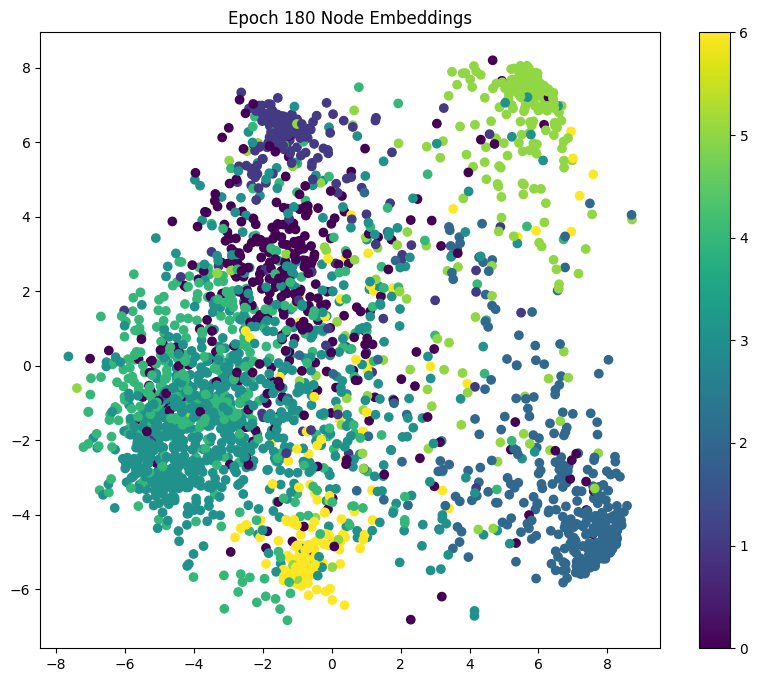

Model 5 - Epoch: 190, Loss: 0.0007, Train: 1.0000, Val: 0.6520, Test: 0.6540, Precision: 0.6450, Recall: 0.6540, F1: 0.6445
Node Embeddings (Epoch 190):
[[-4.9629097  -3.3655858 ]
 [-3.8747542   2.6216006 ]
 [-2.912573    1.917641  ]
 ...
 [-2.3468184   5.976556  ]
 [-3.1844428   0.71769893]
 [-3.1634593  -1.1239699 ]]


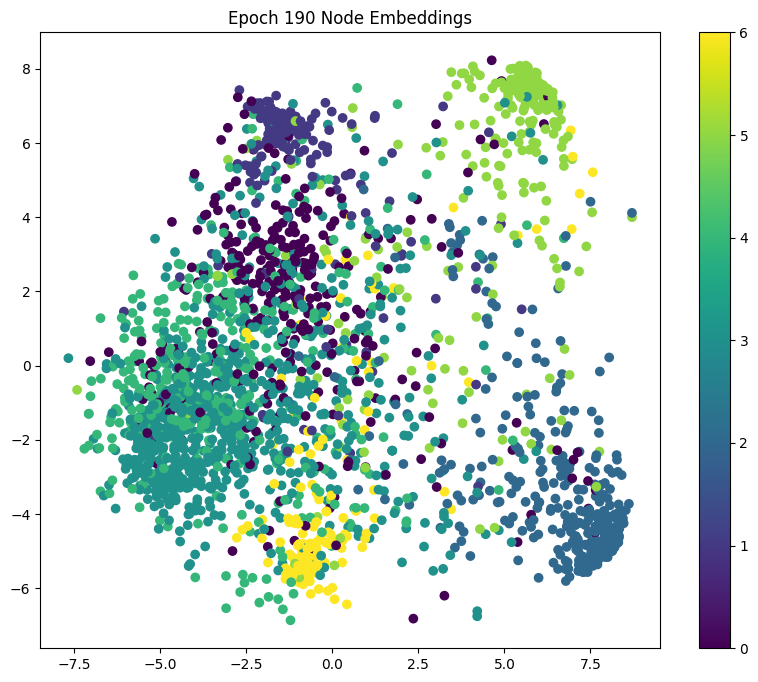

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Fifth' model - Model with 16 hidden units and Tanh activation
writer5 = SummaryWriter('runs/model5')

epochs5 = []
train_losses5 = []
train_accuracies5 = []
val_accuracies5 = []
test_accuracies5 = []
precisions5 = []
recalls5 = []
f1_scores5 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss5 = train(data, data.train_mask, model5, optimizer5, criterion5)
    train_acc5 = test(data, data.train_mask, model5)
    val_acc5 = test(data, data.val_mask, model5)
    test_acc5 = test(data, data.test_mask, model5)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model5(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs5.append(epoch)
        train_losses5.append(loss5.detach().item())
        train_accuracies5.append(train_acc5)
        val_accuracies5.append(val_acc5)
        test_accuracies5.append(test_acc5)
        precisions5.append(precision)
        recalls5.append(recall)
        f1_scores5.append(f1)

        print(f'Model 5 - Epoch: {epoch:03d}, Loss: {loss5:.4f}, Train: {train_acc5:.4f}, Val: {val_acc5:.4f}, Test: {test_acc5:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model5(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer5.add_scalar('Loss/Train', loss5, epoch)
    writer5.add_scalar('Accuracy/Train', train_acc5, epoch)
    writer5.add_scalar('Accuracy/Validation', val_acc5, epoch)
    writer5.add_scalar('Accuracy/Test', test_acc5, epoch)
    writer5.add_scalar('Precision/Test', precision, epoch)
    writer5.add_scalar('Recall/Test', recall, epoch)
    writer5.add_scalar('F1-Score/Test', f1, epoch)

writer5.close()


# Learning Curve for Second Model | Karim Yasser

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs5, y=train_losses5, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs5, y=train_accuracies5, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs5, y=val_accuracies5, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs5, y=test_accuracies5, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Fifth Model | Karim Yasser',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# Train and test 'Sixth' model after tuning -  Abdelrahman Gamal

Model 6 - Epoch: 010, Loss: 1.5398, Train: 0.9000, Val: 0.6680, Test: 0.6490, Precision: 0.7707, Recall: 0.6490, F1: 0.6169
Node Embeddings (Epoch 10):
[[-0.11464086  0.6785454 ]
 [-0.7104261  -0.24157608]
 [-0.60026205 -0.00931716]
 ...
 [-0.2059589  -0.07353204]
 [-0.34513587  0.257104  ]
 [-0.3258374   0.33247396]]


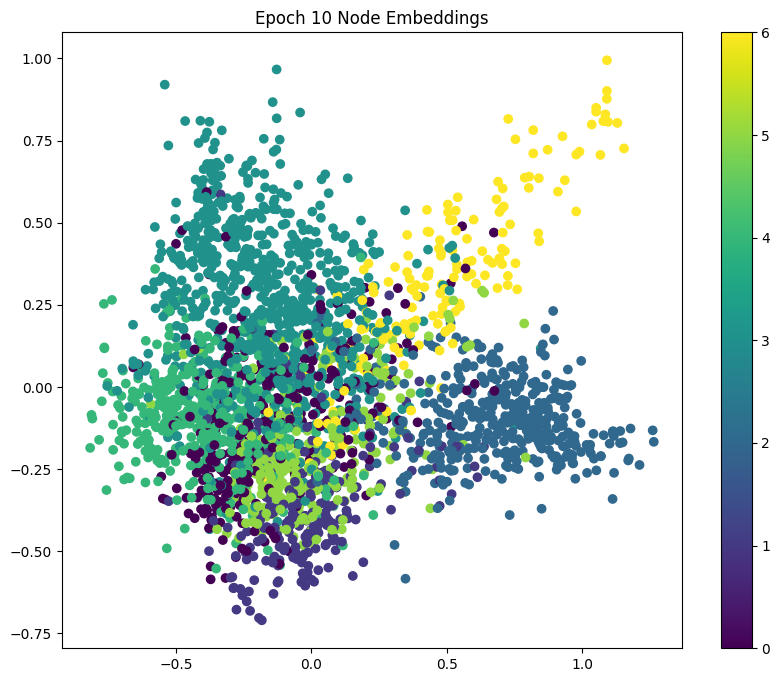

Model 6 - Epoch: 020, Loss: 0.5810, Train: 1.0000, Val: 0.7500, Test: 0.7790, Precision: 0.7975, Recall: 0.7790, F1: 0.7795
Node Embeddings (Epoch 20):
[[-1.9929277   2.3916225 ]
 [-2.9718819  -1.0148625 ]
 [-2.8138194  -0.32952762]
 ...
 [-0.83945787 -1.0541873 ]
 [-2.2530937   0.72645885]
 [-2.2533517   0.8961904 ]]


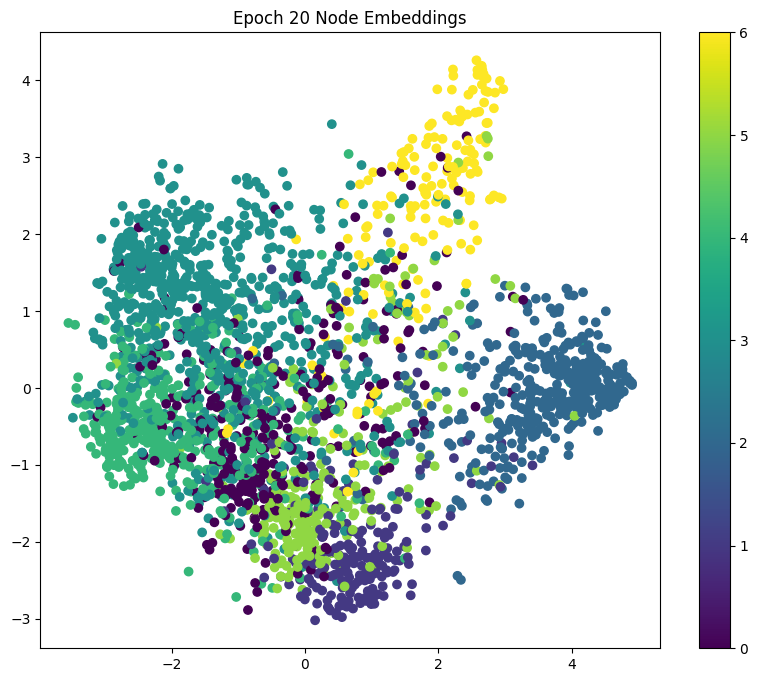

Model 6 - Epoch: 030, Loss: 0.1278, Train: 1.0000, Val: 0.7640, Test: 0.7880, Precision: 0.8048, Recall: 0.7880, F1: 0.7899
Node Embeddings (Epoch 30):
[[-4.238261    2.1225076 ]
 [-4.036891   -1.8711216 ]
 [-3.9126973  -1.1422603 ]
 ...
 [-0.16249472 -2.1464229 ]
 [-3.6449065   0.02691948]
 [-3.6595058   0.01203701]]


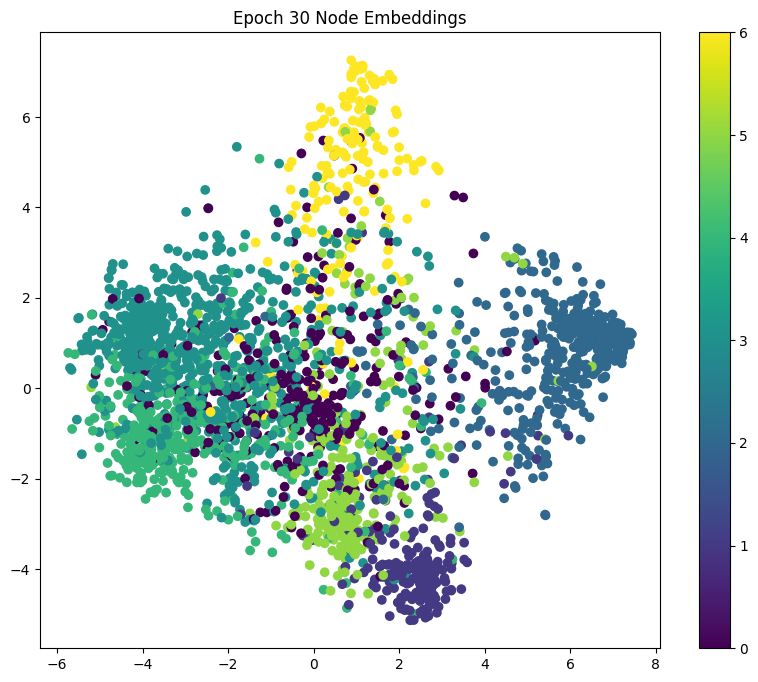

Model 6 - Epoch: 040, Loss: 0.0500, Train: 1.0000, Val: 0.7800, Test: 0.7930, Precision: 0.8062, Recall: 0.7930, F1: 0.7946
Node Embeddings (Epoch 40):
[[-5.015376    1.7848687 ]
 [-4.4129605  -1.347573  ]
 [-4.2088356  -0.99576324]
 ...
 [-0.36728054 -1.645916  ]
 [-4.714764   -0.558743  ]
 [-4.5971994  -0.7242722 ]]


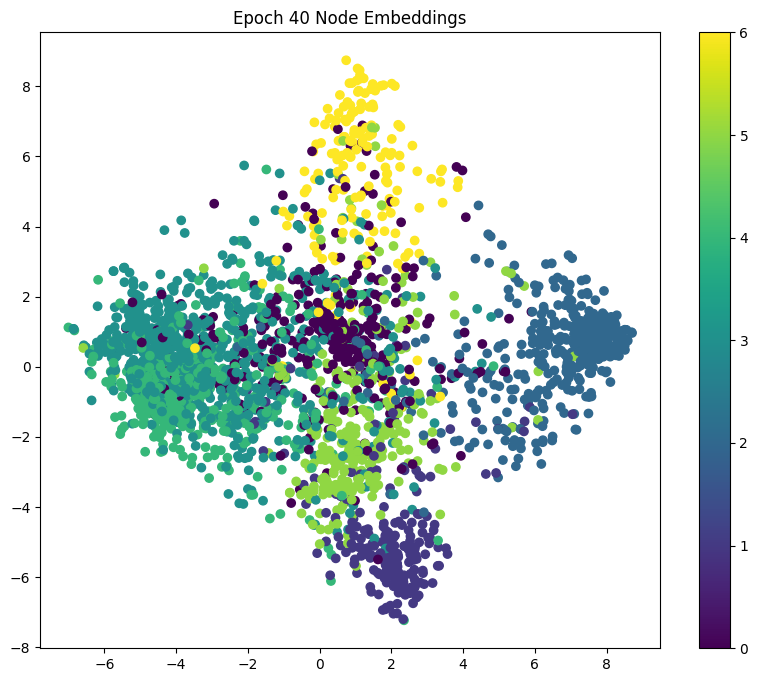

Model 6 - Epoch: 050, Loss: 0.0351, Train: 1.0000, Val: 0.7780, Test: 0.8010, Precision: 0.8140, Recall: 0.8010, F1: 0.8033
Node Embeddings (Epoch 50):
[[-5.5306025   1.1974175 ]
 [-4.3169403  -1.0148765 ]
 [-4.157305   -0.76863766]
 ...
 [-0.34011757 -1.2686622 ]
 [-5.43495    -1.0874556 ]
 [-5.3242207  -1.3018156 ]]


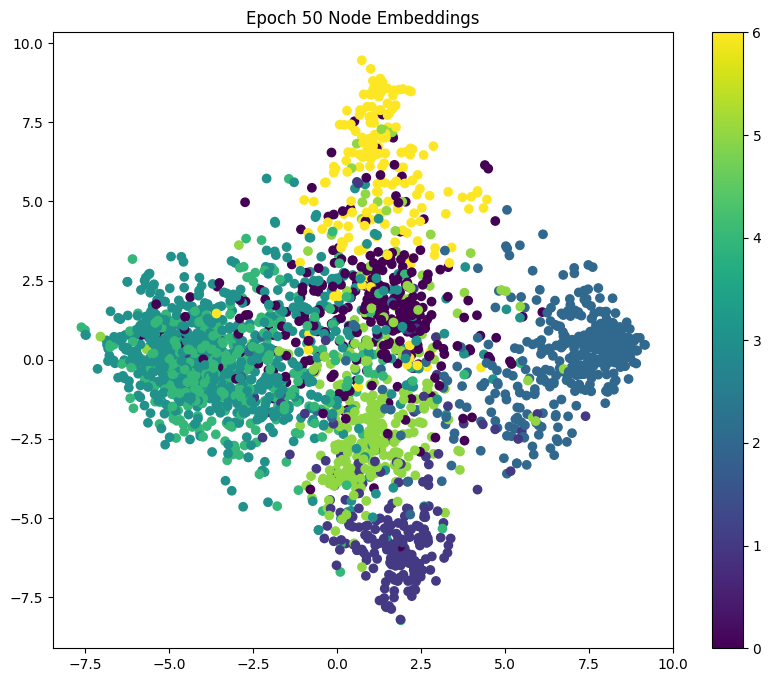

Model 6 - Epoch: 060, Loss: 0.0270, Train: 1.0000, Val: 0.7760, Test: 0.7960, Precision: 0.8091, Recall: 0.7960, F1: 0.7982
Node Embeddings (Epoch 60):
[[-5.7827263   0.70099837]
 [-4.2381725  -0.47949553]
 [-4.160077   -0.20037957]
 ...
 [ 0.01190865 -1.2918686 ]
 [-5.6647596  -1.6189685 ]
 [-5.5883017  -1.7945315 ]]


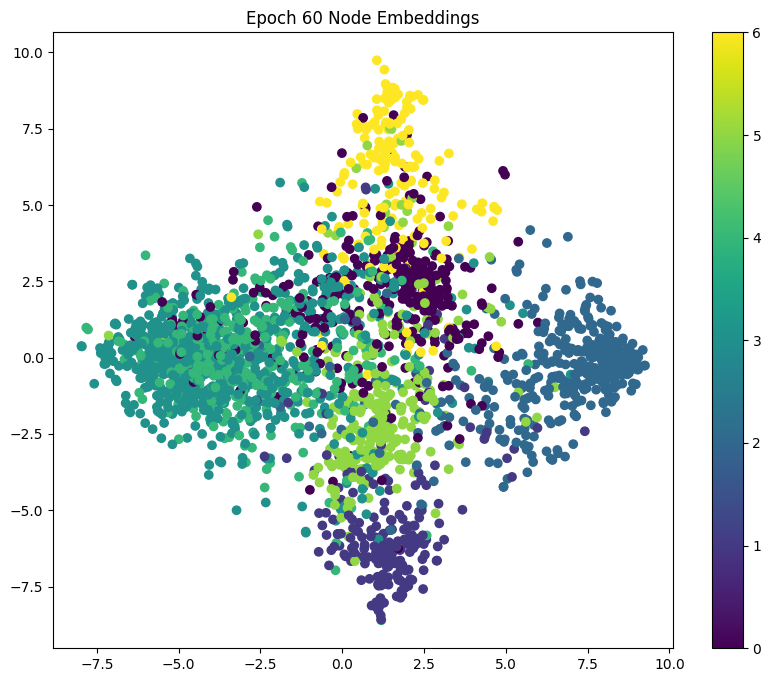

Model 6 - Epoch: 070, Loss: 0.0232, Train: 1.0000, Val: 0.7780, Test: 0.8000, Precision: 0.8122, Recall: 0.8000, F1: 0.8021
Node Embeddings (Epoch 70):
[[-5.978698   -0.43735534]
 [-4.1449943  -0.00817239]
 [-4.1152105  -0.20397696]
 ...
 [ 0.09450442  1.2268263 ]
 [-5.827033    1.866679  ]
 [-5.7572217   2.0174234 ]]


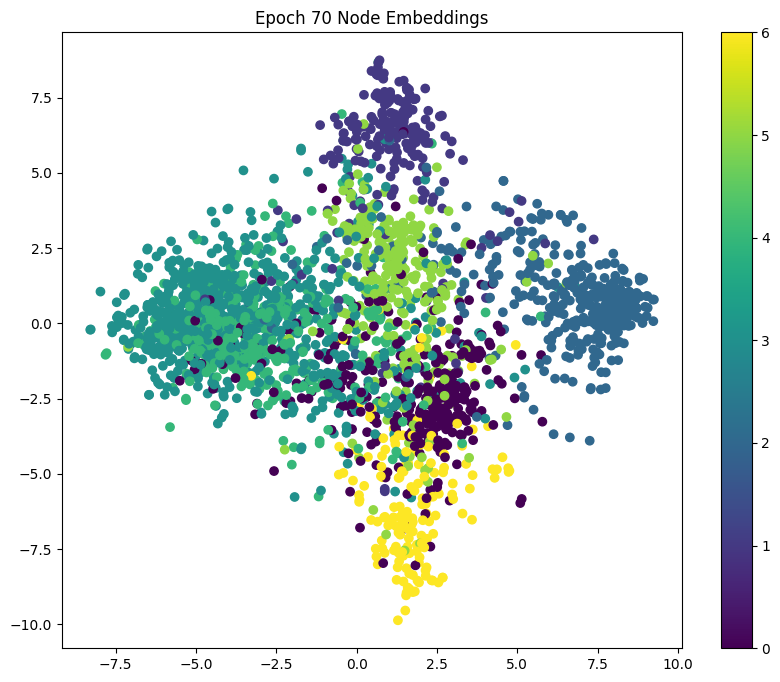

Model 6 - Epoch: 080, Loss: 0.0209, Train: 1.0000, Val: 0.7780, Test: 0.7980, Precision: 0.8103, Recall: 0.7980, F1: 0.8002
Node Embeddings (Epoch 80):
[[ 6.143985   -0.2052768 ]
 [ 4.0012116  -0.5184963 ]
 [ 4.030392   -0.6037857 ]
 ...
 [-0.05747557  1.04214   ]
 [ 5.9421916   1.9844307 ]
 [ 5.876308    2.1734164 ]]


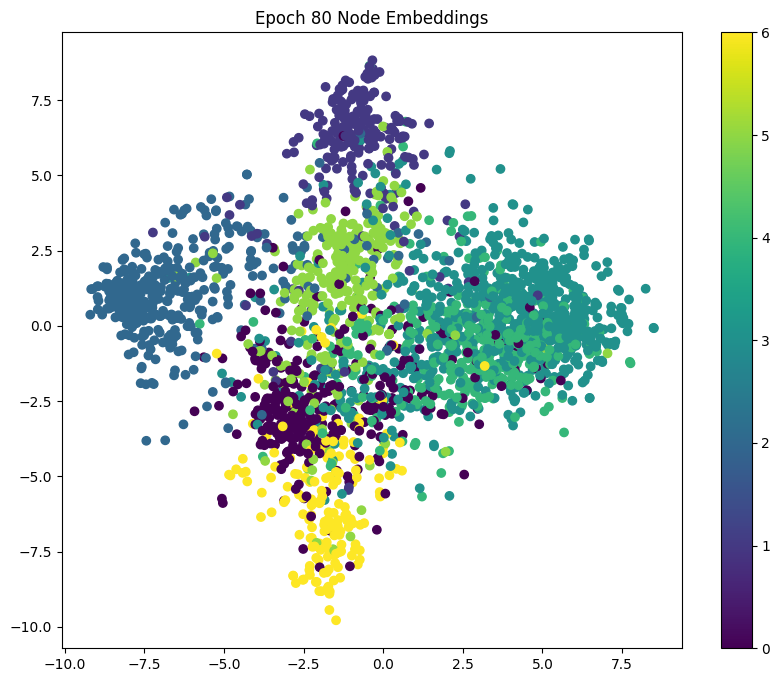

Model 6 - Epoch: 090, Loss: 0.0193, Train: 1.0000, Val: 0.7760, Test: 0.7950, Precision: 0.8078, Recall: 0.7950, F1: 0.7972
Node Embeddings (Epoch 90):
[[ 6.2991614  -0.11341388]
 [ 3.8423066  -0.876091  ]
 [ 3.918457   -0.8932666 ]
 ...
 [-0.05186099  0.9247215 ]
 [ 6.039193    2.0156128 ]
 [ 5.9821625   2.2402387 ]]


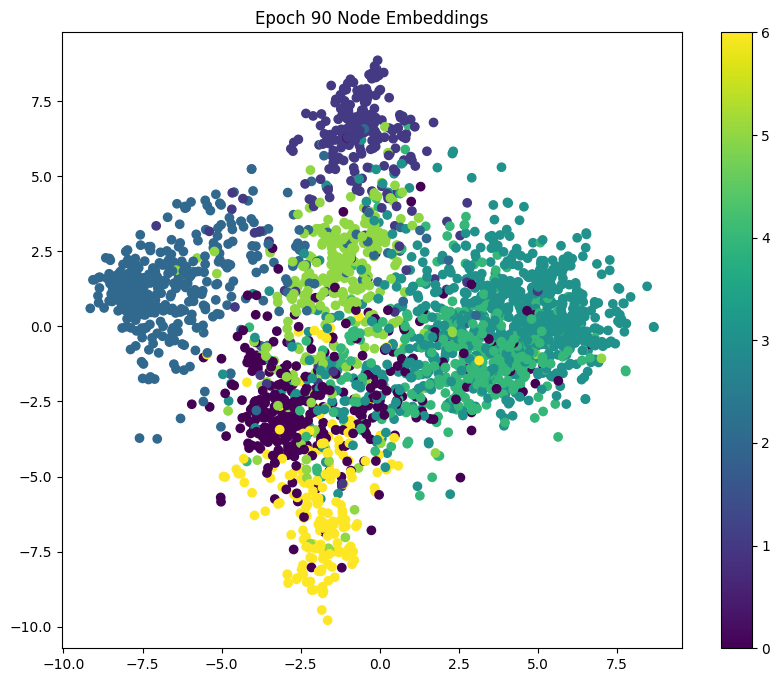

Model 6 - Epoch: 100, Loss: 0.0181, Train: 1.0000, Val: 0.7760, Test: 0.7920, Precision: 0.8047, Recall: 0.7920, F1: 0.7942
Node Embeddings (Epoch 100):
[[ 6.435656   -0.09379288]
 [ 3.638228   -1.1507494 ]
 [ 3.759673   -1.1289761 ]
 ...
 [-0.08887863  0.89610946]
 [ 6.1342235   2.0331197 ]
 [ 6.0794425   2.273625  ]]


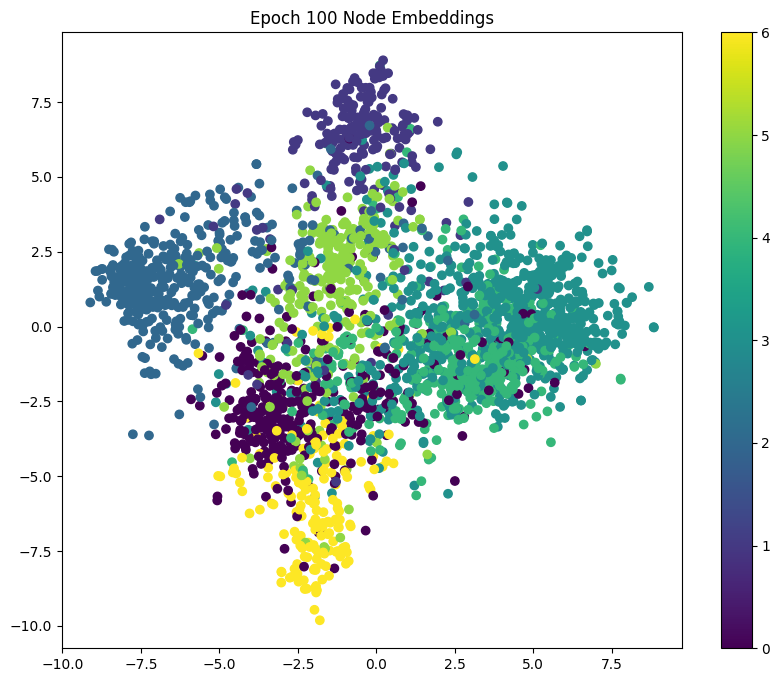

Model 6 - Epoch: 110, Loss: 0.0172, Train: 1.0000, Val: 0.7760, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 110):
[[ 6.5871863  -0.12861407]
 [ 3.4349847  -1.366281  ]
 [ 3.6041217  -1.3137743 ]
 ...
 [-0.12143505  0.9317639 ]
 [ 6.2455554   2.0059652 ]
 [ 6.194881    2.25763   ]]


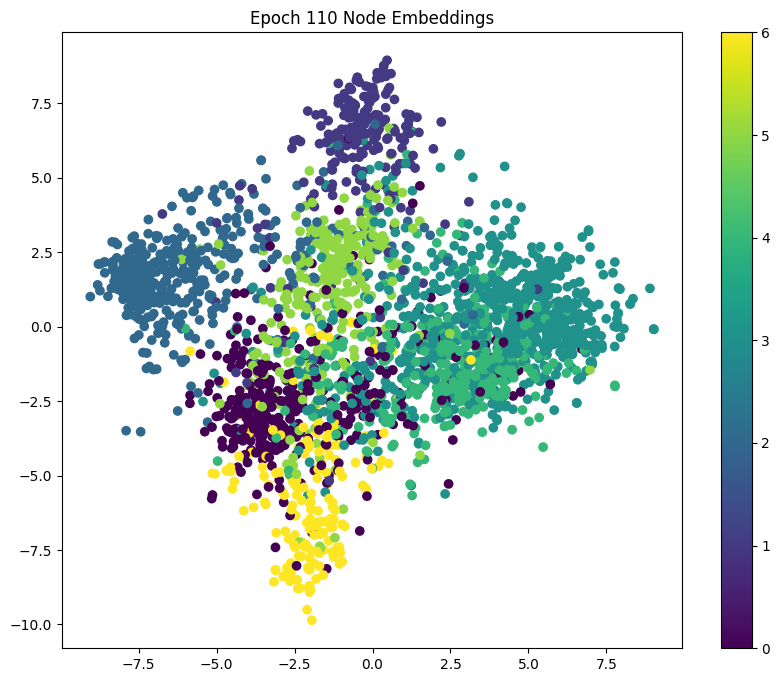

Model 6 - Epoch: 120, Loss: 0.0164, Train: 1.0000, Val: 0.7780, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 120):
[[ 6.72881    -0.19861867]
 [ 3.214571   -1.5376483 ]
 [ 3.4386034  -1.4641634 ]
 ...
 [-0.15717632  0.95210767]
 [ 6.363892    1.9458405 ]
 [ 6.3224425   2.2139945 ]]


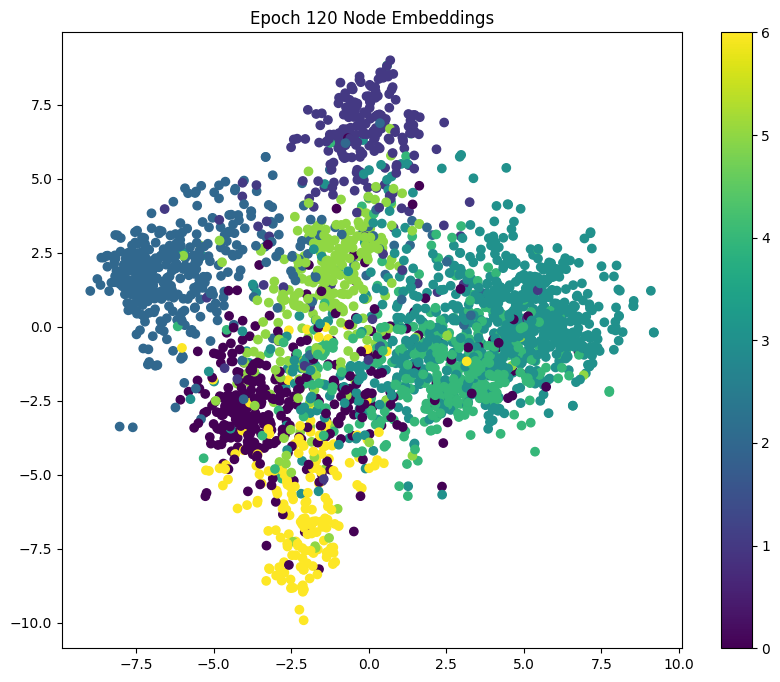

Model 6 - Epoch: 130, Loss: 0.0157, Train: 1.0000, Val: 0.7760, Test: 0.7930, Precision: 0.8056, Recall: 0.7930, F1: 0.7951
Node Embeddings (Epoch 130):
[[ 6.8658457  -0.29892513]
 [ 2.985477   -1.6578515 ]
 [ 3.267944   -1.5739362 ]
 ...
 [-0.18732825  0.9801015 ]
 [ 6.4822106   1.8629951 ]
 [ 6.452309    2.145373  ]]


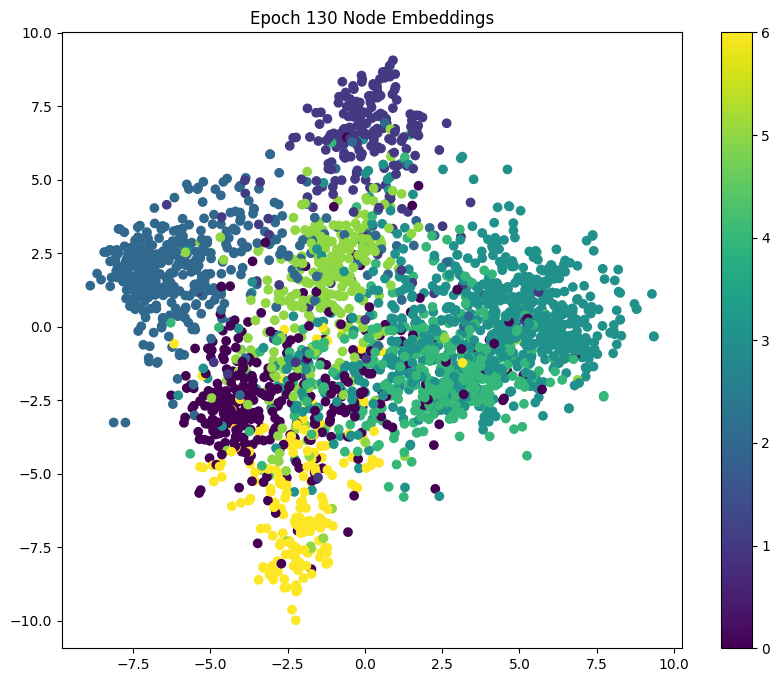

Model 6 - Epoch: 140, Loss: 0.0152, Train: 1.0000, Val: 0.7780, Test: 0.7950, Precision: 0.8077, Recall: 0.7950, F1: 0.7971
Node Embeddings (Epoch 140):
[[ 6.9950886  -0.42274934]
 [ 2.7597747  -1.7256438 ]
 [ 3.0986593  -1.6454653 ]
 ...
 [-0.21111369  1.0105025 ]
 [ 6.594784    1.7682738 ]
 [ 6.5748897   2.064194  ]]


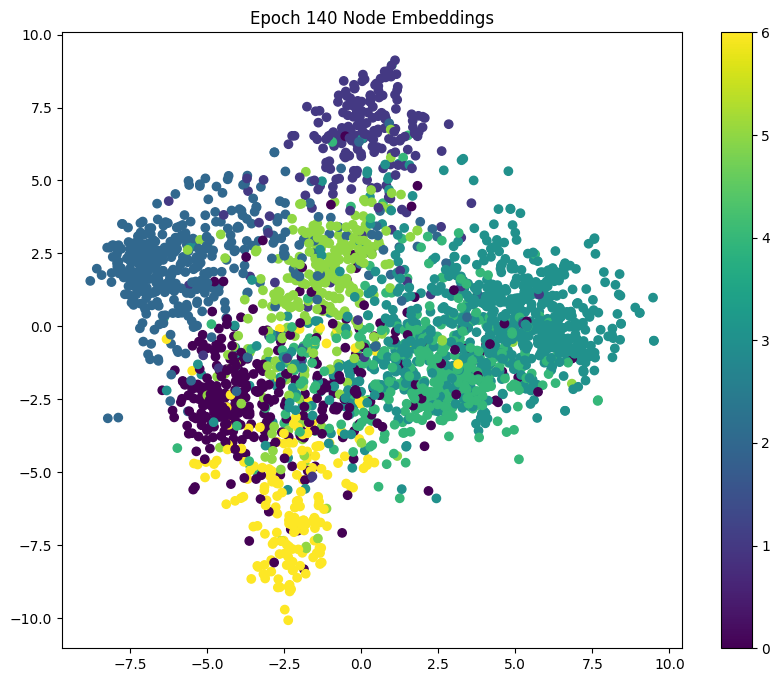

Model 6 - Epoch: 150, Loss: 0.0147, Train: 1.0000, Val: 0.7780, Test: 0.7960, Precision: 0.8084, Recall: 0.7960, F1: 0.7979
Node Embeddings (Epoch 150):
[[ 7.111935   -0.5640995 ]
 [ 2.5353024  -1.7486941 ]
 [ 2.9295535  -1.6820718 ]
 ...
 [-0.23807314  1.0365307 ]
 [ 6.6975336   1.6678703 ]
 [ 6.6875777   1.9749553 ]]


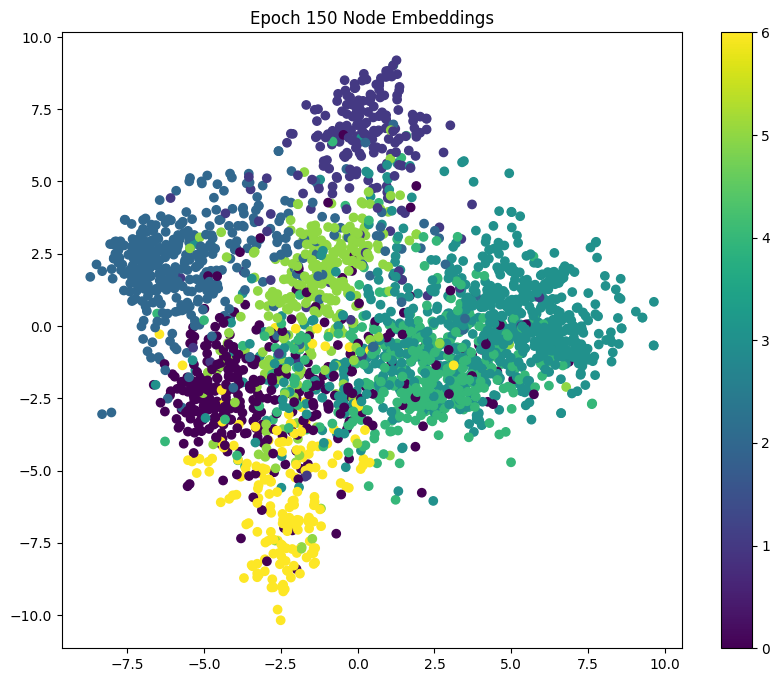

Model 6 - Epoch: 160, Loss: 0.0142, Train: 1.0000, Val: 0.7760, Test: 0.7960, Precision: 0.8084, Recall: 0.7960, F1: 0.7979
Node Embeddings (Epoch 160):
[[ 7.217882   -0.7185233 ]
 [ 2.3144293  -1.733393  ]
 [ 2.7634802  -1.6893576 ]
 ...
 [-0.26455107  1.0645007 ]
 [ 6.790294    1.5623591 ]
 [ 6.7899265   1.8779439 ]]


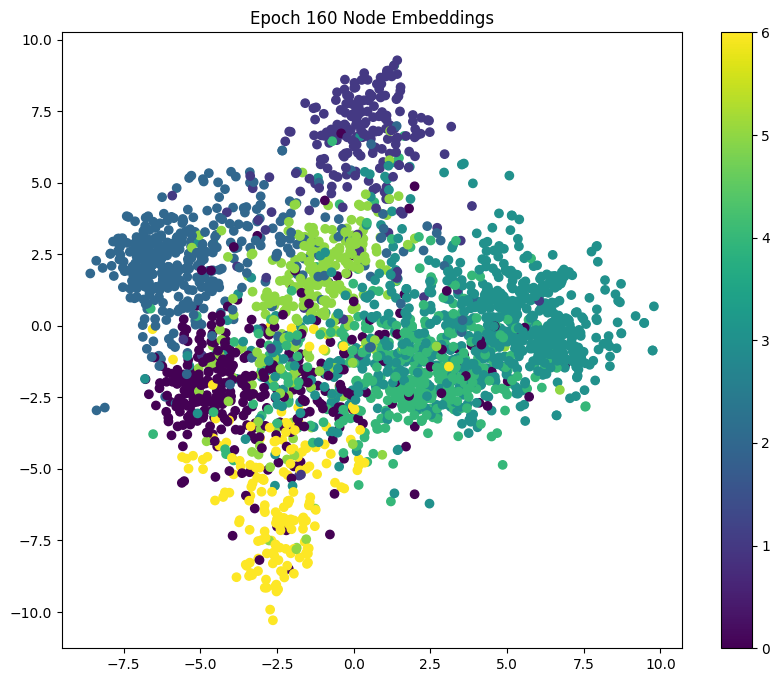

Model 6 - Epoch: 170, Loss: 0.0138, Train: 1.0000, Val: 0.7740, Test: 0.7990, Precision: 0.8109, Recall: 0.7990, F1: 0.8009
Node Embeddings (Epoch 170):
[[ 7.3131294  -0.8800899 ]
 [ 2.1002436  -1.6831725 ]
 [ 2.6023986  -1.6685886 ]
 ...
 [-0.29076526  1.0908111 ]
 [ 6.8747606   1.4535447 ]
 [ 6.883065    1.7772056 ]]


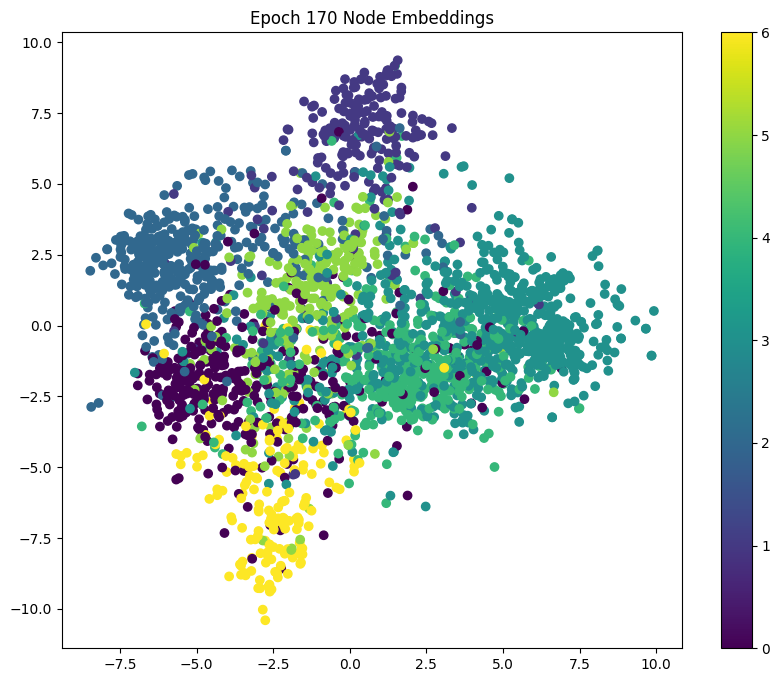

Model 6 - Epoch: 180, Loss: 0.0135, Train: 1.0000, Val: 0.7740, Test: 0.8010, Precision: 0.8129, Recall: 0.8010, F1: 0.8030
Node Embeddings (Epoch 180):
[[ 7.397841   -1.0457443 ]
 [ 1.8940742  -1.6055291 ]
 [ 2.4465764  -1.625433  ]
 ...
 [-0.31653434  1.1161146 ]
 [ 6.9514284   1.3442988 ]
 [ 6.9679403   1.6751986 ]]


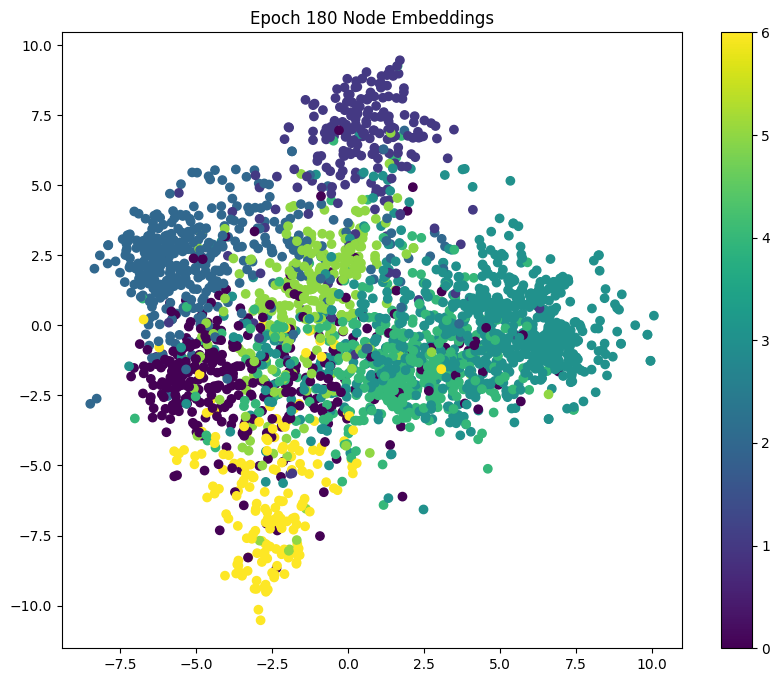

Model 6 - Epoch: 190, Loss: 0.0132, Train: 1.0000, Val: 0.7740, Test: 0.8000, Precision: 0.8125, Recall: 0.8000, F1: 0.8020
Node Embeddings (Epoch 190):
[[ 7.471982   -1.2108581 ]
 [ 1.697776   -1.505846  ]
 [ 2.2981381  -1.5642229 ]
 ...
 [-0.34329635  1.1393191 ]
 [ 7.020361    1.2369419 ]
 [ 7.044517    1.5740854 ]]


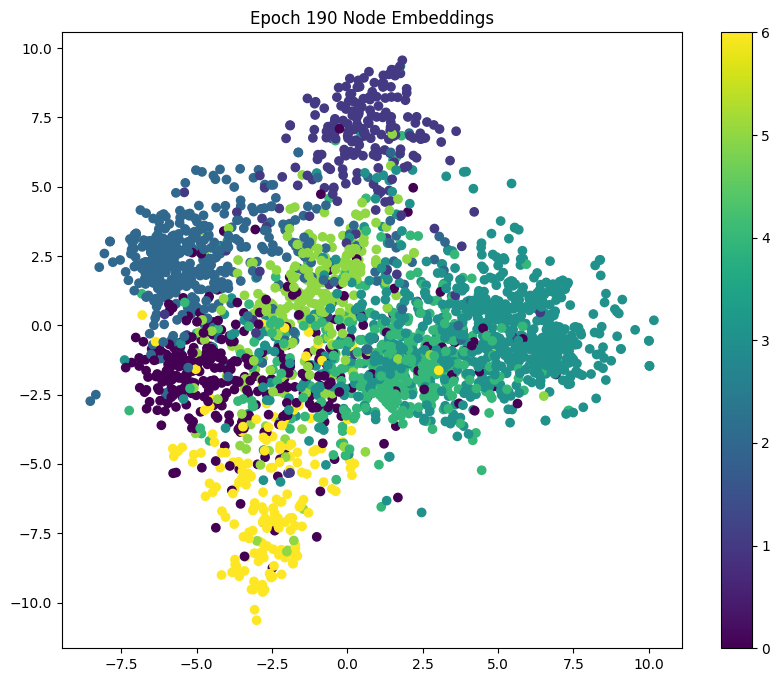

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Train and test 'Sixth' model - Model with 32 hidden units and Sigmoid activation
writer6 = SummaryWriter('runs/model5')

epochs6 = []
train_losses6 = []
train_accuracies6 = []
val_accuracies6 = []
test_accuracies6 = []
precisions6 = []
recalls6 = []
f1_scores6 = []

num_epochs = 200
for epoch in range(1, num_epochs):

    loss6 = train(data, data.train_mask, model6, optimizer6, criterion6)
    train_acc6 = test(data, data.train_mask, model6)
    val_acc6 = test(data, data.val_mask, model6)
    test_acc6 = test(data, data.test_mask, model6)

    # Computing Precision, Recall, and F1-Score
    y_true_test = data.y[data.test_mask].cpu().numpy()
    y_pred_test = model6(data.x, data.edge_index).argmax(dim=1)[data.test_mask].cpu().numpy()

    precision = precision_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    recall = recall_score(y_true_test, y_pred_test, average='weighted', zero_division=0)
    f1 = f1_score(y_true_test, y_pred_test, average='weighted', zero_division=0)

    # Storing metrics for learning curves
    if epoch % 10 == 0:
        epochs6.append(epoch)
        train_losses6.append(loss6.detach().item())
        train_accuracies6.append(train_acc6)
        val_accuracies6.append(val_acc6)
        test_accuracies6.append(test_acc6)
        precisions6.append(precision)
        recalls6.append(recall)
        f1_scores6.append(f1)

        print(f'Model 6 - Epoch: {epoch:03d}, Loss: {loss6:.4f}, Train: {train_acc6:.4f}, Val: {val_acc6:.4f}, Test: {test_acc6:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}')

        # Node embeddings
        node_embeddings = model6(data.x, data.edge_index)

        # Reducing dimensions using PCA for visualization
        pca = PCA(n_components=2)
        node_embeddings_2d = pca.fit_transform(node_embeddings.detach().cpu().numpy())

        # Printing the node embeddings for the current epoch
        print(f"Node Embeddings (Epoch {epoch}):")
        print(node_embeddings_2d)

        # Visualizing the node embeddings
        fig, ax = plt.subplots(figsize=(10, 8))
        scatter = ax.scatter(node_embeddings_2d[:, 0], node_embeddings_2d[:, 1], c=data.y.numpy(), cmap='viridis')
        ax.set_title(f"Epoch {epoch} Node Embeddings")
        fig.colorbar(scatter)
        plt.show()

    # Logging metrics to TensorBoard
    writer6.add_scalar('Loss/Train', loss6, epoch)
    writer6.add_scalar('Accuracy/Train', train_acc6, epoch)
    writer6.add_scalar('Accuracy/Validation', val_acc6, epoch)
    writer6.add_scalar('Accuracy/Test', test_acc6, epoch)
    writer6.add_scalar('Precision/Test', precision, epoch)
    writer6.add_scalar('Recall/Test', recall, epoch)
    writer6.add_scalar('F1-Score/Test', f1, epoch)

writer6.close()

# Learning Curve for Sixth Model | Abdelrahman Gamal

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs6, y=train_losses6, mode='lines+markers', name='Training Loss'))
fig.add_trace(go.Scatter(x=epochs6, y=train_accuracies6, mode='lines+markers', name='Training Accuracy'))
fig.add_trace(go.Scatter(x=epochs6, y=val_accuracies6, mode='lines+markers', name='Validation Accuracy'))
fig.add_trace(go.Scatter(x=epochs6, y=test_accuracies6, mode='lines+markers', name='Test Accuracy'))

fig.update_layout(
    title='Learning Curve for Third Model | Abdelrahman Gamal',
    xaxis_title='Epochs',
    yaxis_title='Metrics',
    legend_title='Metrics',
)
fig.show()

# **Tensor Board For All models with its Hyperparametars**

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Run to preview on colab in case URL is not working on colab

In [ ]:
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>

# **GCN Models Performance Analysis**

## 1. Model Architectures and Hyperparameters
- **Model 4**: 2 layers, ReLU activation, Learning Rate = 0.01
- **Model 5**: 3 layers, Tanh activation, Learning Rate = 0.005
- **Model 6**: 2 layers, Sigmoid activation, Learning Rate = 0.01

---

## 2. Training and Validation Metrics

### **Model 4**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.2172     | 74.29%         | 39.4%               | 39.2%         |
| 20    | 0.3472     | 95.00%         | 58.8%               | 59.0%         |
| 30    | 0.0343     | 100%           | 56.6%               | 59.0%         |
| 70    | 0.0002     | 100%           | 61.2%               | 62.8%         |
| 190   | 0.0001     | 100%           | 62.6%               | 63.1%         |

### **Model 5**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 0.8591     | 97.14%         | 70.6%               | 73.3%         |
| 20    | 0.2318     | 100%           | 73.0%               | 75.7%         |
| 30    | 0.0672     | 100%           | 71.0%               | 73.5%         |
| 70    | 0.0090     | 100%           | 71.4%               | 73.4%         |
| 190   | 0.0023     | 100%           | 70.6%               | 73.3%         |

### **Model 6**
| Epoch | Train Loss | Train Accuracy | Validation Accuracy | Test Accuracy |
|-------|------------|----------------|---------------------|---------------|
| 10    | 1.5953     | 86.43%         | 57.4%               | 58.0%         |
| 20    | 0.6544     | 100%           | 77.2%               | 78.7%         |
| 30    | 0.1567     | 100%           | 78.0%               | 79.3%         |
| 70    | 0.0244     | 100%           | 78.8%               | 80.8%         |
| 190   | 0.0134     | 100%           | 78.2%               | 79.8%         |

---

## 3. Learning Curves

### Model 4
- **Train Loss Over Epochs**:
  - Train loss dropped sharply from **1.2172** at epoch 10 to **0.0001** at epoch 190.
- **Accuracy Curves**:
  - Train accuracy reached **100%** by epoch 30, but validation accuracy showed modest improvement, peaking at **62.6%**.

### Model 5
- **Train Loss Over Epochs**:
  - Train loss steadily declined from **0.8591** at epoch 10 to **0.0023** at epoch 190.
- **Accuracy Curves**:
  - Validation accuracy peaked at **73.0%** early (epoch 20) and then fluctuated slightly, indicating possible overfitting.

### Model 6
- **Train Loss Over Epochs**:
  - Train loss was initially high (**1.5953**) but declined steadily to **0.0134** by epoch 190.
- **Accuracy Curves**:
  - Validation accuracy peaked at **78.8%** (epoch 70), and test accuracy followed a similar trend, stabilizing around **80.8%**.

---

## 4. Observations
- **Model 4** achieved moderate performance but showed limited improvement in validation and test accuracy, suggesting underfitting.
- **Model 5** achieved higher validation accuracy initially but suffered from slight overfitting, as seen by a decline in performance after epoch 20.
- **Model 6** outperformed the other models, achieving the highest **Test Accuracy** of **80.8%**.

---

## 5. Conclusion
- **Model 6** is the best-performing model, showing strong generalization and stable validation/test performance.
- **Model 4** might require additional layers or improved hyperparameter tuning to increase performance.
- **Model 5** showed early promise but might benefit from regularization techniques to prevent overfitting.
